# **Import**

In [1]:
import clip
import os
from torch import nn
import numpy as np
import torch
import torch.nn.functional as nnf
import sys
from typing import Tuple, List, Union, Optional
from transformers import GPT2Tokenizer, GPT2LMHeadModel, AdamW, get_linear_schedule_with_warmup
from tqdm import tqdm, trange
# from google.colab import files
import skimage.io as io
import PIL.Image
from IPython.display import Image 


N = type(None)
V = np.array
ARRAY = np.ndarray
ARRAYS = Union[Tuple[ARRAY, ...], List[ARRAY]]
VS = Union[Tuple[V, ...], List[V]]
VN = Union[V, N]
VNS = Union[VS, N]
T = torch.Tensor
TS = Union[Tuple[T, ...], List[T]]
TN = Optional[T]
TNS = Union[Tuple[TN, ...], List[TN]]
TSN = Optional[TS]
TA = Union[T, ARRAY]


D = torch.device
CPU = torch.device('cpu')


def get_device(device_id: int) -> D:
    if not torch.cuda.is_available():
        return CPU
    device_id = min(torch.cuda.device_count() - 1, device_id)
    return torch.device(f'cuda:{device_id}')


CUDA = get_device

current_directory = os.getcwd()
save_path = os.path.join(os.path.dirname(current_directory), "pretrained_models")
os.makedirs(save_path, exist_ok=True)
model_path = os.path.join(save_path, 'model_wieghts.pt')

E:\envList\imgcap\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# **Model**

In [2]:
class MLP(nn.Module):

    def forward(self, x: T) -> T:
        return self.model(x)

    def __init__(self, sizes: Tuple[int, ...], bias=True, act=nn.Tanh):
        super(MLP, self).__init__()
        layers = []
        for i in range(len(sizes) -1):
            layers.append(nn.Linear(sizes[i], sizes[i + 1], bias=bias))
            if i < len(sizes) - 2:
                layers.append(act())
        self.model = nn.Sequential(*layers)


class ClipCaptionModel(nn.Module):

    #@functools.lru_cache #FIXME
    def get_dummy_token(self, batch_size: int, device: D) -> T:
        return torch.zeros(batch_size, self.prefix_length, dtype=torch.int64, device=device)

    def forward(self, tokens: T, prefix: T, mask: Optional[T] = None, labels: Optional[T] = None):
        embedding_text = self.gpt.transformer.wte(tokens)
        prefix_projections = self.clip_project(prefix).view(-1, self.prefix_length, self.gpt_embedding_size)
        #print(embedding_text.size()) #torch.Size([5, 67, 768])
        #print(prefix_projections.size()) #torch.Size([5, 1, 768])
        embedding_cat = torch.cat((prefix_projections, embedding_text), dim=1)
        if labels is not None:
            dummy_token = self.get_dummy_token(tokens.shape[0], tokens.device)
            labels = torch.cat((dummy_token, tokens), dim=1)
        out = self.gpt(inputs_embeds=embedding_cat, labels=labels, attention_mask=mask)
        return out

    def __init__(self, prefix_length: int, prefix_size: int = 512):
        super(ClipCaptionModel, self).__init__()
        self.prefix_length = prefix_length
        self.gpt = GPT2LMHeadModel.from_pretrained('gpt2')
        self.gpt_embedding_size = self.gpt.transformer.wte.weight.shape[1]
        if prefix_length > 10:  # not enough memory
            self.clip_project = nn.Linear(prefix_size, self.gpt_embedding_size * prefix_length)
        else:
            self.clip_project = MLP((prefix_size, (self.gpt_embedding_size * prefix_length) // 2, self.gpt_embedding_size * prefix_length))


class ClipCaptionPrefix(ClipCaptionModel):

    def parameters(self, recurse: bool = True):
        return self.clip_project.parameters()

    def train(self, mode: bool = True):
        super(ClipCaptionPrefix, self).train(mode)
        self.gpt.eval()
        return self

In [3]:
def generate_beam(model, tokenizer, beam_size: int = 5, prompt=None, embed=None,
                  entry_length=67, temperature=1., stop_token: str = '.'):

    model.eval()
    stop_token_index = tokenizer.encode(stop_token)[0]
    tokens = None
    scores = None
    device = next(model.parameters()).device
    seq_lengths = torch.ones(beam_size, device=device)
    is_stopped = torch.zeros(beam_size, device=device, dtype=torch.bool)
    with torch.no_grad():
        if embed is not None:
            generated = embed
        else:
            if tokens is None:
                tokens = torch.tensor(tokenizer.encode(prompt))
                tokens = tokens.unsqueeze(0).to(device)
                generated = model.gpt.transformer.wte(tokens)
        for i in range(entry_length):
            outputs = model.gpt(inputs_embeds=generated)
            logits = outputs.logits
            logits = logits[:, -1, :] / (temperature if temperature > 0 else 1.0)
            logits = logits.softmax(-1).log()
            if scores is None:
                scores, next_tokens = logits.topk(beam_size, -1)
                generated = generated.expand(beam_size, *generated.shape[1:])
                next_tokens, scores = next_tokens.permute(1, 0), scores.squeeze(0)
                if tokens is None:
                    tokens = next_tokens
                else:
                    tokens = tokens.expand(beam_size, *tokens.shape[1:])
                    tokens = torch.cat((tokens, next_tokens), dim=1)
            else:
                logits[is_stopped] = -float(np.inf)
                logits[is_stopped, 0] = 0
                scores_sum = scores[:, None] + logits
                seq_lengths[~is_stopped] += 1
                scores_sum_average = scores_sum / seq_lengths[:, None]
                scores_sum_average, next_tokens = scores_sum_average.view(-1).topk(beam_size, -1)
                next_tokens_source = next_tokens // scores_sum.shape[1]
                seq_lengths = seq_lengths[next_tokens_source]
                next_tokens = next_tokens % scores_sum.shape[1]
                next_tokens = next_tokens.unsqueeze(1)
                tokens = tokens[next_tokens_source]
                tokens = torch.cat((tokens, next_tokens), dim=1)
                generated = generated[next_tokens_source]
                scores = scores_sum_average * seq_lengths
                is_stopped = is_stopped[next_tokens_source]
            next_token_embed = model.gpt.transformer.wte(next_tokens.squeeze()).view(generated.shape[0], 1, -1)
            generated = torch.cat((generated, next_token_embed), dim=1)
            is_stopped = is_stopped + next_tokens.eq(stop_token_index).squeeze()
            if is_stopped.all():
                break
    scores = scores / seq_lengths
    output_list = tokens.cpu().numpy()
    output_texts = [tokenizer.decode(output[:int(length)]) for output, length in zip(output_list, seq_lengths)]
    order = scores.argsort(descending=True)
    output_texts = [output_texts[i] for i in order]
    return output_texts


def generate2(
        model,
        tokenizer,
        tokens=None,
        prompt=None,
        embed=None,
        entry_count=1,
        entry_length=67,  # maximum number of words
        top_p=0.8,
        temperature=1.,
        stop_token: str = '.',
):
    model.eval()
    generated_num = 0
    generated_list = []
    stop_token_index = tokenizer.encode(stop_token)[0]
    filter_value = -float("Inf")
    device = next(model.parameters()).device

    with torch.no_grad():

        for entry_idx in trange(entry_count):
            if embed is not None:
                generated = embed
            else:
                if tokens is None:
                    tokens = torch.tensor(tokenizer.encode(prompt))
                    tokens = tokens.unsqueeze(0).to(device)

                generated = model.gpt.transformer.wte(tokens)

            for i in range(entry_length):

                outputs = model.gpt(inputs_embeds=generated)
                logits = outputs.logits
                logits = logits[:, -1, :] / (temperature if temperature > 0 else 1.0)
                sorted_logits, sorted_indices = torch.sort(logits, descending=True)
                cumulative_probs = torch.cumsum(nnf.softmax(sorted_logits, dim=-1), dim=-1)
                sorted_indices_to_remove = cumulative_probs > top_p
                sorted_indices_to_remove[..., 1:] = sorted_indices_to_remove[
                                                    ..., :-1
                                                    ].clone()
                sorted_indices_to_remove[..., 0] = 0

                indices_to_remove = sorted_indices[sorted_indices_to_remove]
                logits[:, indices_to_remove] = filter_value
                next_token = torch.argmax(logits, -1).unsqueeze(0)
                next_token_embed = model.gpt.transformer.wte(next_token)
                if tokens is None:
                    tokens = next_token
                else:
                    tokens = torch.cat((tokens, next_token), dim=1)
                generated = torch.cat((generated, next_token_embed), dim=1)
                if stop_token_index == next_token.item():
                    break

            output_list = list(tokens.squeeze().cpu().numpy())
            output_text = tokenizer.decode(output_list)
            generated_list.append(output_text)

    return generated_list[0]

# **Download Pretrained** (just first time.)

In [ ]:
# from pydrive.auth import GoogleAuth
# from pydrive.drive import GoogleDrive
# from google.colab import auth
# from oauth2client.client import GoogleCredentials

# download_with_pydrive = True

# class Downloader(object):
#     def __init__(self, use_pydrive):
#         self.use_pydrive = use_pydrive

#         if self.use_pydrive:
#             self.authenticate()
        
#     def authenticate(self):
#         auth.authenticate_user()
#         gauth = GoogleAuth()
#         gauth.credentials = GoogleCredentials.get_application_default()
#         self.drive = GoogleDrive(gauth)
    
#     def download_file(self, file_id, file_dst):
#         if self.use_pydrive:
#             downloaded = self.drive.CreateFile({'id':file_id})
#             downloaded.FetchMetadata(fetch_all=True)
#             downloaded.GetContentFile(file_dst)
#         else:
#             !gdown --id $file_id -O $file_dst

# downloader = Downloader(download_with_pydrive)

In [ ]:
# downloader.download_file("14pXWwB4Zm82rsDdvbGguLfx9F8aM7ovT", model_path)

# **CLIP Model + GPT2 Tokenizer**

In [4]:
device = CUDA(0) if torch.cuda.is_available() else "cpu"
clip_model, preprocess = clip.load("ViT-B/32", device=device, jit=False)
tokenizer = GPT2Tokenizer.from_pretrained("gpt2")

100%|███████████████████████████████████████| 338M/338M [01:46<00:00, 3.33MiB/s]
Downloading: 100%|████████████████████████████████████████████████████████████████| 1.04M/1.04M [00:20<00:00, 50.8kB/s]
E:\envList\imgcap\lib\site-packages\huggingface_hub\file_download.py:125: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\Admin\.cache\huggingface\hub. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to see activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-dev

# **Load Weights**

In [6]:
prefix_length = 10

model = ClipCaptionModel(prefix_length)

model.load_state_dict(torch.load(model_path, map_location=CPU)) 

model = model.eval() 
device = CUDA(0) if torch.cuda.is_available() else "cpu"
model = model.to(device)

Downloading: 100%|██████████████████████████████████████████████████████████████████| 548M/548M [00:09<00:00, 58.9MB/s]


# **Inference**

In [7]:
# For demonstrate CLIPCaptionModel
import pandas as pd

df = pd.read_csv(r"E:\clipcap\mini_traffy_en.csv")
df.head()

,photo,type,label
0,https://storage.googleapis.com/traffy_public_b...,ป้าย,sign
1,https://storage.googleapis.com/traffy_public_b...,สัตว์จรจัด,Rat
2,https://storage.googleapis.com/traffy_public_b...,ท่อระบายน้ำ,Drain
3,https://storage.googleapis.com/traffy_public_b...,"ความสะอาด,สอบถาม,สัตว์จรจัด","Cleanliness, inquiries, organized animals"
4,https://storage.googleapis.com/traffy_public_b...,ท่อระบายน้ำ,Drain


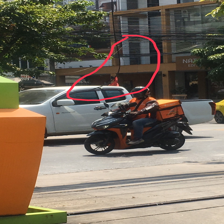

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  4.84it/s]



a motorcyclist rides his scooter through the streets.


In [9]:
from PIL import Image
import requests
from io import BytesIO
from PIL import UnidentifiedImageError

use_beam_search = False

img_path = df["photo"][55]
response = requests.get(img_path)
content = BytesIO(response.content)
pil_image = Image.open(content)
pil_image = pil_image.convert("RGB")

display(pil_image.resize((224, 224)))

image = preprocess(pil_image).unsqueeze(0).to(device)
with torch.no_grad():
    prefix = clip_model.encode_image(image).to(device, dtype=torch.float32)
    prefix_embed = model.clip_project(prefix).reshape(1, prefix_length, -1)
    
if use_beam_search:
    generated_text_prefix = generate_beam(model, tokenizer, embed=prefix_embed)[0]
else:
    generated_text_prefix = generate2(model, tokenizer, embed=prefix_embed)


print('\n')
print(generated_text_prefix)

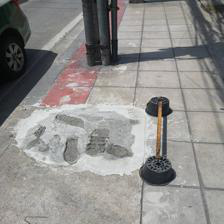

100%|██████████| 1/1 [00:00<00:00,  4.97it/s]

a street lamp with a face painted on it.




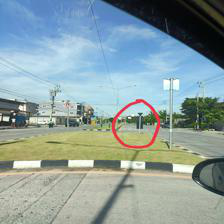

100%|██████████| 1/1 [00:00<00:00,  5.13it/s]

the man was spotted by a passing car.




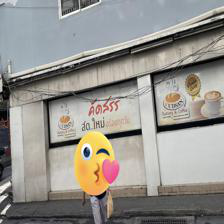

100%|██████████| 1/1 [00:00<00:00,  5.34it/s]


a sign in the window of a restaurant.




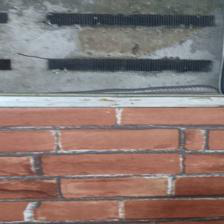

100%|██████████| 1/1 [00:00<00:00,  7.19it/s]

the window of the house.




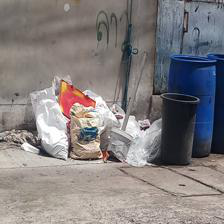

100%|██████████| 1/1 [00:00<00:00,  6.13it/s]

a homeless man sits on the sidewalk.




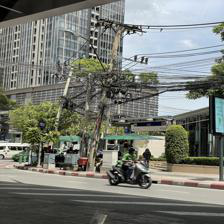

100%|██████████| 1/1 [00:00<00:00,  6.30it/s]

a city is the capital city.




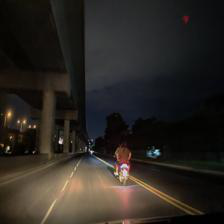

100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

a woman rides her bike on a street at night.




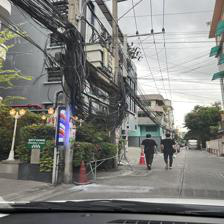

100%|██████████| 1/1 [00:00<00:00,  5.25it/s]


the streets are lined with electric wires.




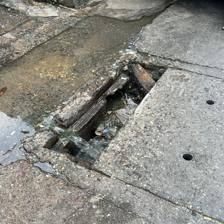

100%|██████████| 1/1 [00:00<00:00,  5.31it/s]


the water was found to be very low in the water.




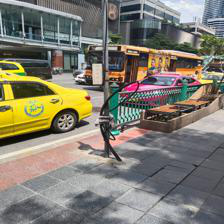

100%|██████████| 1/1 [00:00<00:00,  4.77it/s]

a taxi driver is seen in this undated image.




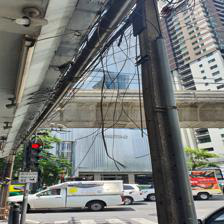

100%|██████████| 1/1 [00:00<00:00,  7.53it/s]


the wires were installed in the area.




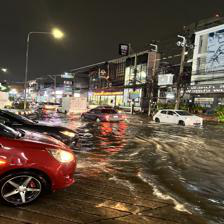

100%|██████████| 1/1 [00:00<00:00,  6.84it/s]

a car drives through a flooded street.




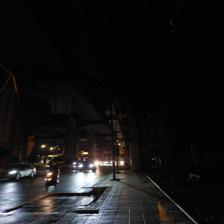

100%|██████████| 1/1 [00:00<00:00, 10.70it/s]

a city is a city.




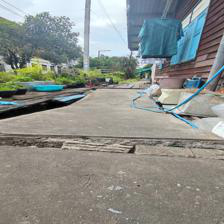

100%|██████████| 1/1 [00:00<00:00,  6.80it/s]

the water was running out of the house.




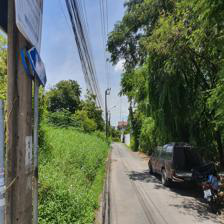

100%|██████████| 1/1 [00:00<00:00,  8.24it/s]


a train passes through a village.




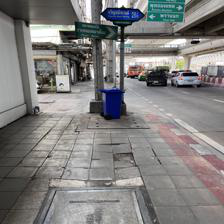

100%|██████████| 1/1 [00:00<00:00,  7.33it/s]


the road is closed for the day.




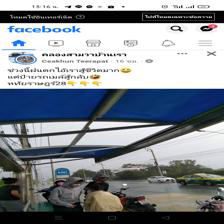

100%|██████████| 1/1 [00:00<00:00,  7.37it/s]


the app is available on smartphones.




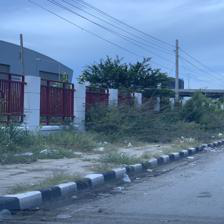

100%|██████████| 1/1 [00:00<00:00,  8.62it/s]


a street in the city.




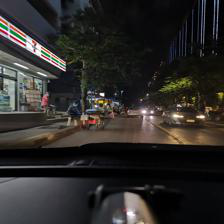

100%|██████████| 1/1 [00:00<00:00,  9.59it/s]

driving in the night city.




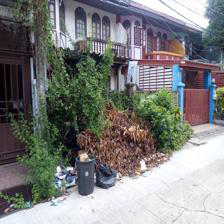

100%|██████████| 1/1 [00:00<00:00,  7.65it/s]


the house where person was found.




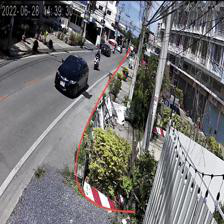

100%|██████████| 1/1 [00:00<00:00,  6.96it/s]


the car was spotted in the street.




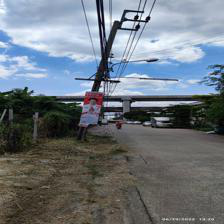

100%|██████████| 1/1 [00:00<00:00,  8.30it/s]


the road to the beach.




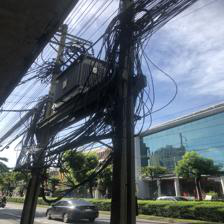

100%|██████████| 1/1 [00:00<00:00,  5.25it/s]


a city : the power lines are broken.




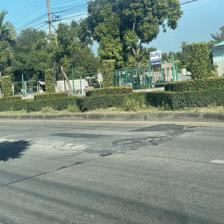

100%|██████████| 1/1 [00:00<00:00,  7.87it/s]


a car drives down a road.




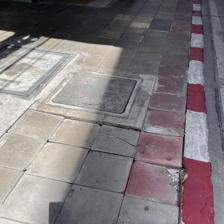

100%|██████████| 1/1 [00:00<00:00,  6.16it/s]

the pavement is a bit of a mess.




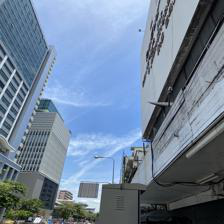

100%|██████████| 1/1 [00:00<00:00,  4.60it/s]

the building is seen in this undated file photo.




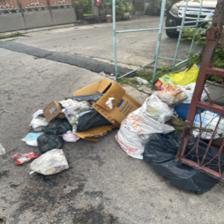

100%|██████████| 1/1 [00:00<00:00,  7.81it/s]


the street is littered with rubbish.




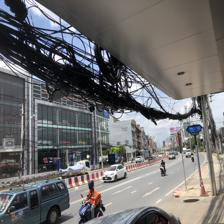

100%|██████████| 1/1 [00:00<00:00,  9.25it/s]


the damage to the building.




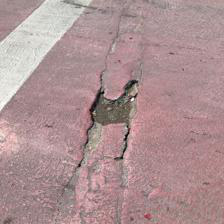

100%|██████████| 1/1 [00:00<00:00,  6.66it/s]

a hole in the road.




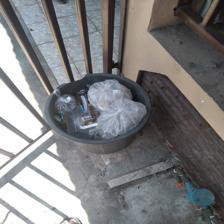

100%|██████████| 1/1 [00:00<00:00,  5.48it/s]


the house was abandoned after the fire.




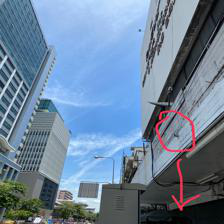

100%|██████████| 1/1 [00:00<00:00,  6.16it/s]

the building is seen from the street.




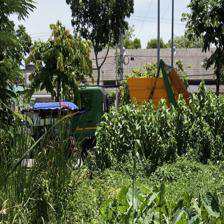

100%|██████████| 1/1 [00:00<00:00,  4.29it/s]

a city is a popular spot for farmers to harvest vegetables.




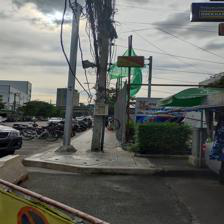

100%|██████████| 1/1 [00:00<00:00,  5.52it/s]


the car was parked in front of the building.




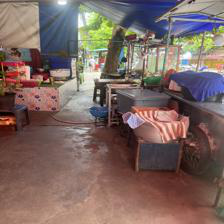

100%|██████████| 1/1 [00:00<00:00,  6.15it/s]

a city : a tent in the market.




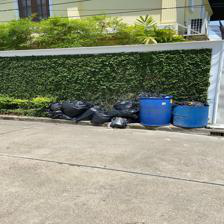

100%|██████████| 1/1 [00:00<00:00,  2.57it/s]

the couple were left with a broken leg after the car they were driving into was hit by a car.




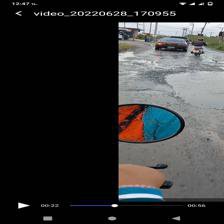

100%|██████████| 1/1 [00:00<00:00,  4.46it/s]

the video shows the car's reflection in the water.




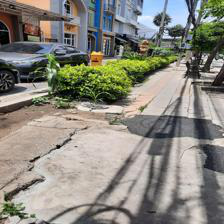

100%|██████████| 1/1 [00:00<00:00,  7.32it/s]


a man walks past a damaged street.




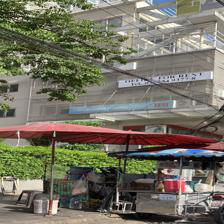

100%|██████████| 1/1 [00:00<00:00,  7.11it/s]


a city is a popular shopping street.




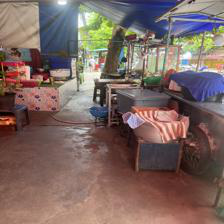

100%|██████████| 1/1 [00:00<00:00,  6.29it/s]

a city : a tent in the market.




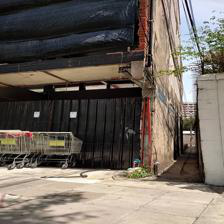

100%|██████████| 1/1 [00:00<00:00,  7.97it/s]


the building is being torn down.




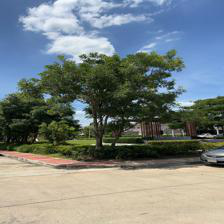

100%|██████████| 1/1 [00:00<00:00,  6.06it/s]

the parking lot is located in the heart.




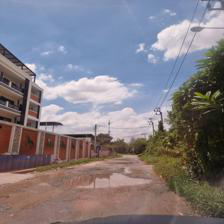

100%|██████████| 1/1 [00:00<00:00,  9.01it/s]


the road to the city.




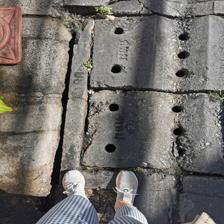

100%|██████████| 1/1 [00:00<00:00,  7.84it/s]


a man walks down a street.




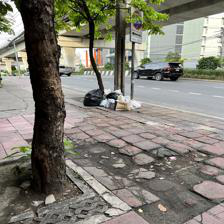

100%|██████████| 1/1 [00:00<00:00,  6.10it/s]


a tree is seen in the street.




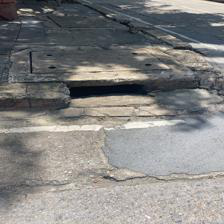

100%|██████████| 1/1 [00:00<00:00,  8.45it/s]


the hole in the road.




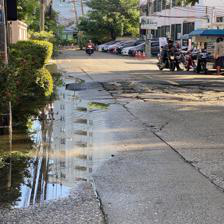

100%|██████████| 1/1 [00:00<00:00,  6.85it/s]


a man walks past a flooded street.




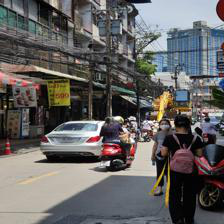

100%|██████████| 1/1 [00:00<00:00,  7.42it/s]


the main street of the city.




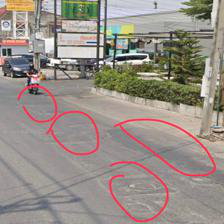

100%|██████████| 1/1 [00:00<00:00,  4.99it/s]


a man is seen in a picture taken from a street.




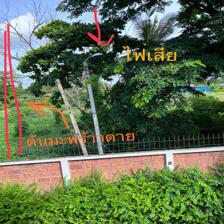

100%|██████████| 1/1 [00:00<00:00,  8.54it/s]


the sign at the entrance.




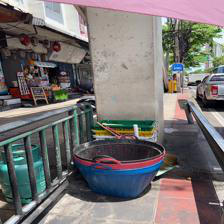

100%|██████████| 1/1 [00:00<00:00,  6.27it/s]


a street vendor selling flowers in the street.




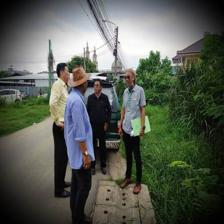

100%|██████████| 1/1 [00:00<00:00,  3.66it/s]


person, a local man, is seen walking down the street with his son.




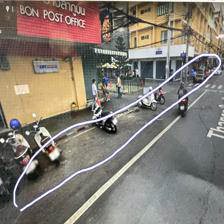

100%|██████████| 1/1 [00:00<00:00,  5.13it/s]


the car was left in the middle of the road.




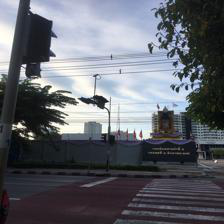

100%|██████████| 1/1 [00:00<00:00,  7.96it/s]


the city is a busy place.




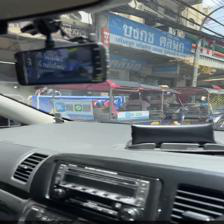

100%|██████████| 1/1 [00:00<00:00,  5.21it/s]


the car is seen in this undated image.




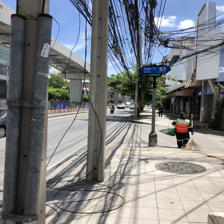

100%|██████████| 1/1 [00:00<00:00,  7.65it/s]


a man walks on a street.




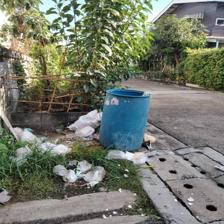

100%|██████████| 1/1 [00:00<00:00,  5.49it/s]


a man washes his home in the neighborhood.




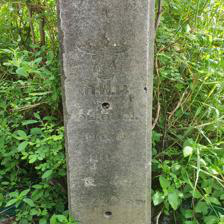

100%|██████████| 1/1 [00:00<00:00,  6.06it/s]


a sign on the side of a road.




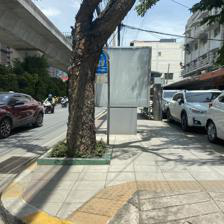

100%|██████████| 1/1 [00:00<00:00,  5.13it/s]


the car park is a bit of a mess.




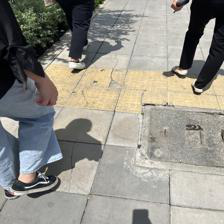

100%|██████████| 1/1 [00:00<00:00,  5.97it/s]


a woman walks past a sign that reads.




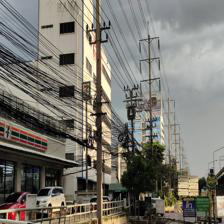

100%|██████████| 1/1 [00:00<00:00,  3.71it/s]


a city is a city with a population of around 8,000.




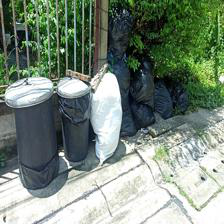

100%|██████████| 1/1 [00:00<00:00,  7.97it/s]


the garden is full of trash.




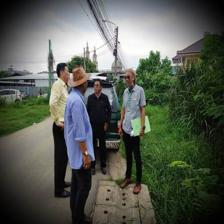

100%|██████████| 1/1 [00:00<00:00,  3.73it/s]


person, a local man, is seen walking down the street with his son.




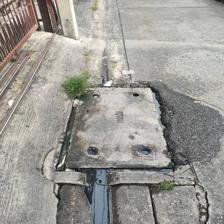

100%|██████████| 1/1 [00:00<00:00,  6.51it/s]


the water main break in the street.




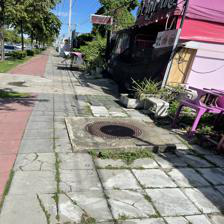

100%|██████████| 1/1 [00:00<00:00,  5.22it/s]


the street is a mix of old and new.




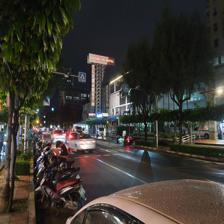

100%|██████████| 1/1 [00:00<00:00,  6.73it/s]


a city is a busy street.




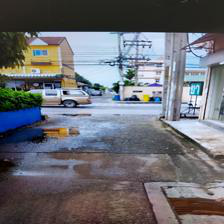

100%|██████████| 1/1 [00:00<00:00,  9.21it/s]


a view of the street.




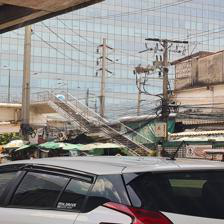

100%|██████████| 1/1 [00:00<00:00,  4.43it/s]


a crane was used to remove the roof of the building.




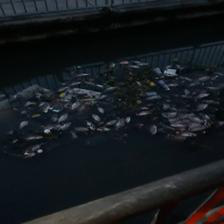

100%|██████████| 1/1 [00:00<00:00,  4.62it/s]


a city is a city with a lot of trash.




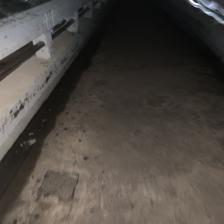

100%|██████████| 1/1 [00:00<00:00,  5.00it/s]


the man was taken to hospital in serious condition.




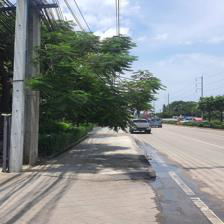

100%|██████████| 1/1 [00:00<00:00,  6.97it/s]


the road is closed for the day.




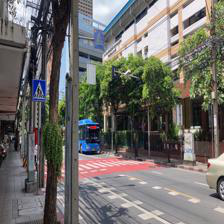

100%|██████████| 1/1 [00:00<00:00,  7.63it/s]


the street is lined with trees.




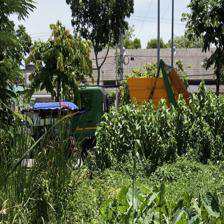

100%|██████████| 1/1 [00:00<00:00,  4.65it/s]


a city is a popular spot for farmers to harvest vegetables.




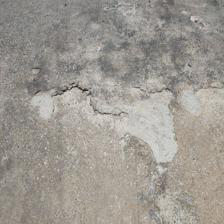

100%|██████████| 1/1 [00:00<00:00,  4.93it/s]


the asphalt is cracked and the asphalt is cracked.




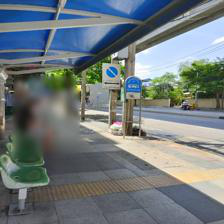

100%|██████████| 1/1 [00:00<00:00,  7.20it/s]


a woman is seen in a wheelchair.




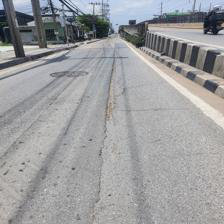

100%|██████████| 1/1 [00:00<00:00,  8.06it/s]


the road is now completely empty.




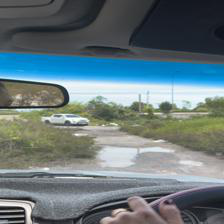

100%|██████████| 1/1 [00:00<00:00,  7.49it/s]


the road is a little narrow.




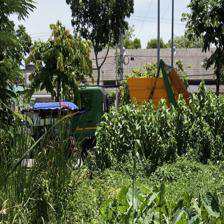

100%|██████████| 1/1 [00:00<00:00,  4.15it/s]


a city is a popular spot for farmers to harvest vegetables.




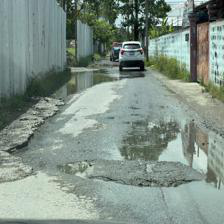

100%|██████████| 1/1 [00:00<00:00,  6.68it/s]


a pothole in the road.




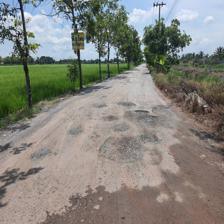

100%|██████████| 1/1 [00:00<00:00,  6.40it/s]


the road is now covered with mud.




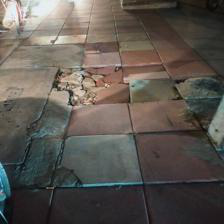

100%|██████████| 1/1 [00:00<00:00,  6.87it/s]


the floor of the house was damaged.




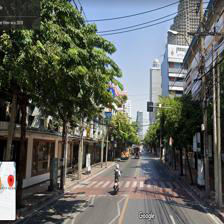

100%|██████████| 1/1 [00:00<00:00,  8.24it/s]


a city is a busy street.




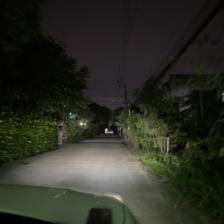

100%|██████████| 1/1 [00:00<00:00,  8.98it/s]


the road to the temple.




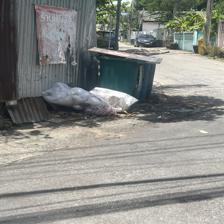

100%|██████████| 1/1 [00:00<00:00,  5.57it/s]


a man washes his dog in the street.




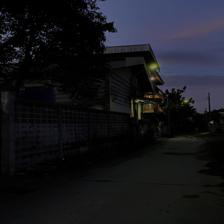

100%|██████████| 1/1 [00:00<00:00,  8.88it/s]


the night before the wedding.




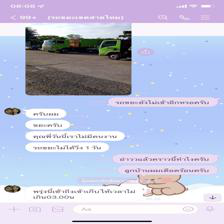

100%|██████████| 1/1 [00:00<00:00,  7.76it/s]


the app is available for free.




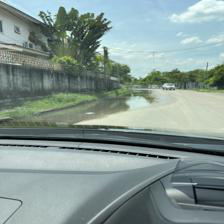

100%|██████████| 1/1 [00:00<00:00,  6.80it/s]


a car drives through a flooded road.




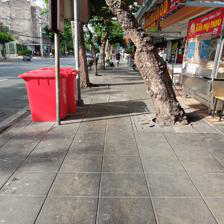

100%|██████████| 1/1 [00:00<00:00,  4.37it/s]


a city is a city with a population of around 3.




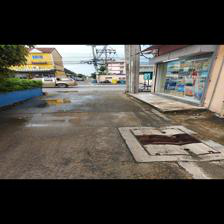

100%|██████████| 1/1 [00:00<00:00,  6.68it/s]


the road is closed for the day.




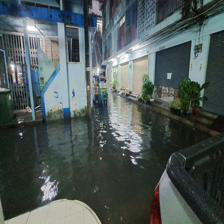

100%|██████████| 1/1 [00:00<00:00,  7.28it/s]


a flooded street in the city.




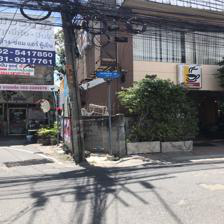

100%|██████████| 1/1 [00:00<00:00,  6.81it/s]


a man was shot in the head.




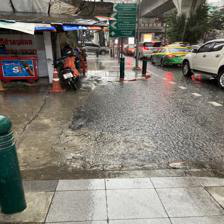

100%|██████████| 1/1 [00:00<00:00,  6.83it/s]


a man walks through a flooded street.




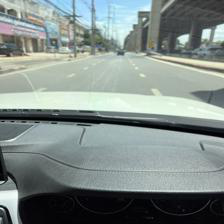

100%|██████████| 1/1 [00:00<00:00,  6.55it/s]


the car is parked in the city.




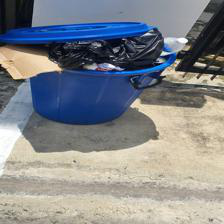

100%|██████████| 1/1 [00:00<00:00,  4.66it/s]


the boat was found in the back yard of a home.




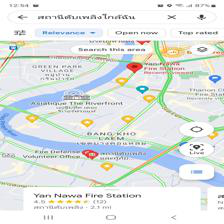

100%|██████████| 1/1 [00:00<00:00,  8.94it/s]


a screenshot of the app.




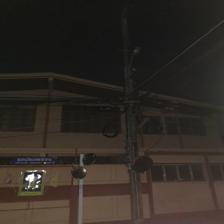

100%|██████████| 1/1 [00:00<00:00,  4.28it/s]


the lights are out, but the street is still dark.




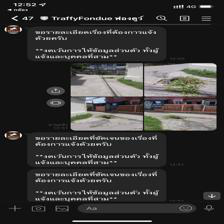

100%|██████████| 1/1 [00:00<00:00,  9.01it/s]


a screenshot of the app.




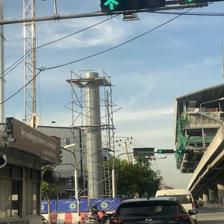

100%|██████████| 1/1 [00:00<00:00,  8.55it/s]


the construction site is seen.




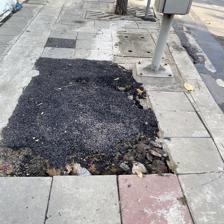

100%|██████████| 1/1 [00:00<00:00,  5.20it/s]


the road was closed for several hours after the fire.




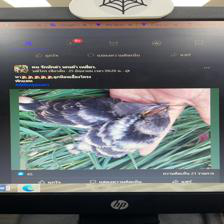

100%|██████████| 1/1 [00:00<00:00,  7.76it/s]


a bird of prey was found.




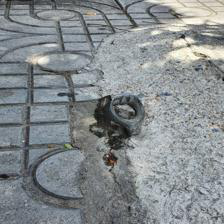

100%|██████████| 1/1 [00:00<00:00,  8.97it/s]

the hole in the pavement.




In [ ]:
# Example of generated caption for 100 images (NO Beam Search)
use_beam_search = False

for img in img_100:
  image = io.imread("/content/drive/Shareddrives/traffyImg/test/"+img) # We Doesn't provide image data
  pil_image = PIL.Image.fromarray(image)
  display(pil_image)
  image = preprocess(pil_image).unsqueeze(0).to(device)

  with torch.no_grad():
      prefix = clip_model.encode_image(image).to(device, dtype=torch.float32)
      prefix_embed = model.clip_project(prefix).reshape(1, prefix_length, -1)
  if use_beam_search:
      generated_text_prefix = generate_beam(model, tokenizer, embed=prefix_embed)[0]
  else:
      generated_text_prefix = generate2(model, tokenizer, embed=prefix_embed)

  print(generated_text_prefix)
  print('\n')

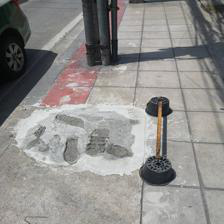



cool drawings on the sidewalk.
----------


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:40: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').


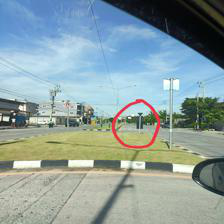



image titled stop a car from going through your window step.
----------


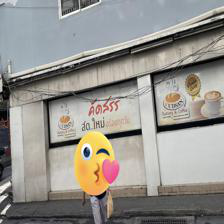



a sign in the window of a fast food restaurant.
----------


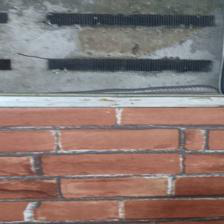



water running down the drain.
----------


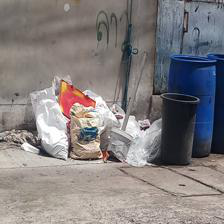



homeless people living on the streets.
----------


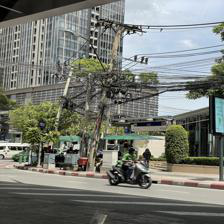



electricity pylon in the city.
----------


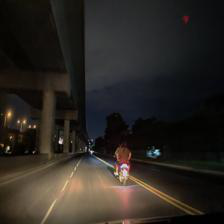



a girl rides her scooter down the street at night.
----------


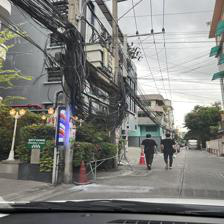



a city is the capital city.
----------


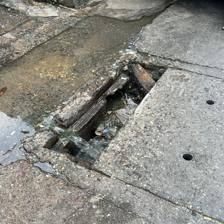



a hole in the pavement.
----------


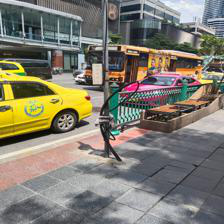



tourist attraction is one of the city's most popular attractions.
----------


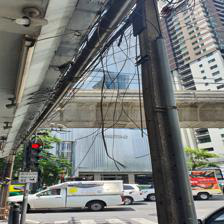



a cable runs through the roof of a metro station.
----------


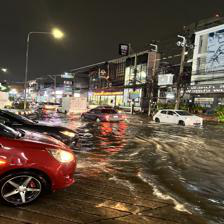



a car drives through a flooded street.
----------


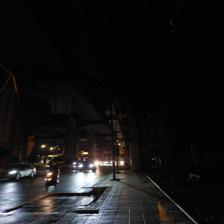



a view of the street at night.
----------


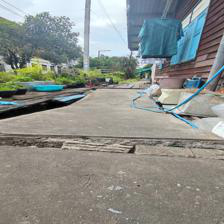



a man washes his dog in the yard of his home on sunday morning.
----------


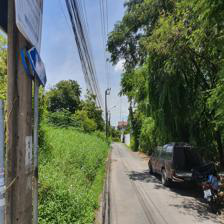



view of the road from the window of a moving train.
----------


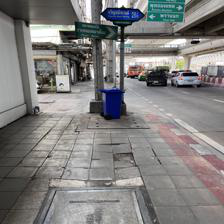



parking lot in the middle of the road.
----------


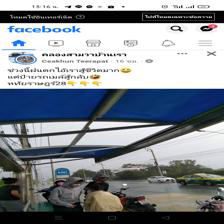



a screenshot of the app.
----------


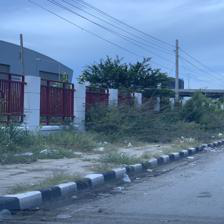



a typical street in the city.
----------


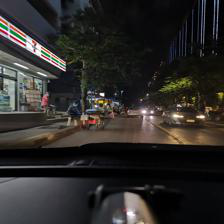



driving in the city at night.
----------


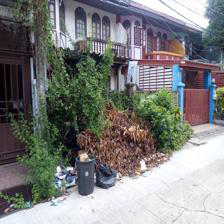



the house in which person lived.
----------


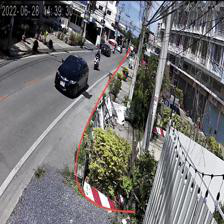



the car is seen in this undated image.
----------


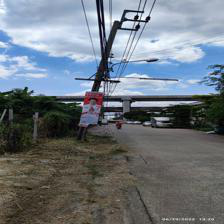



traffic lights at the entrance to the village.
----------


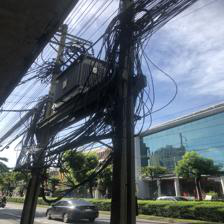



electricity pylon in the street.
----------


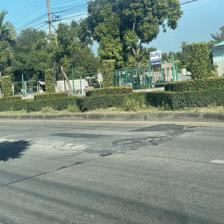



a car drives down a busy road.
----------


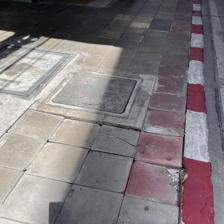



this is a photo of a sidewalk.
----------


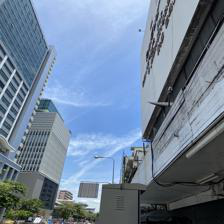



view of the building from the street.
----------


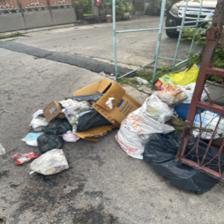



a pile of scrap metal sits on a street.
----------


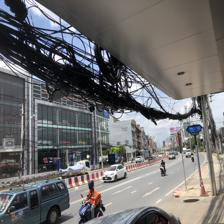



the damage to the roof of a building.
----------


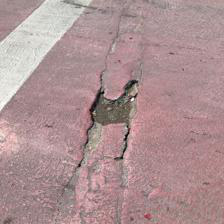



a hole in the road.
----------


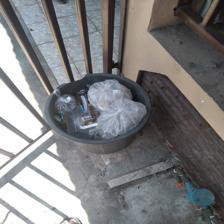



this is what the house looked like before the fire started.
----------


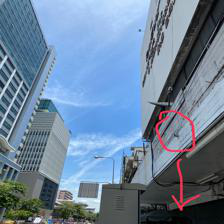



view of the building from the street.
----------


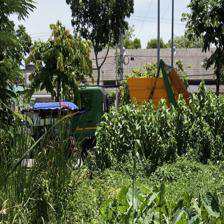



a tree is seen in this undated file photo.
----------


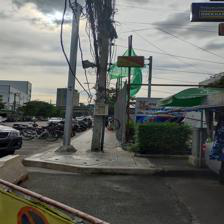



a car is seen in this undated image.
----------


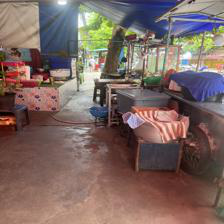



property image # old farm from the 19th century, completely renovated in a village.
----------


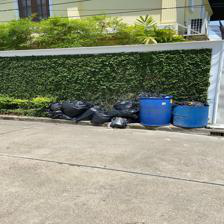



plastic bags on the street.
----------


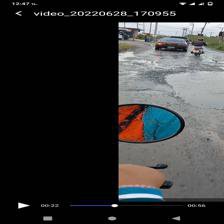



how to make a video camera out of a car window.
----------


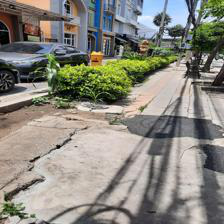



a tree fell on the road.
----------


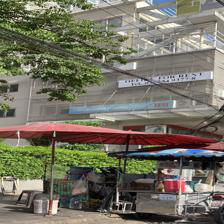



a city is one of the city's most popular destinations.
----------


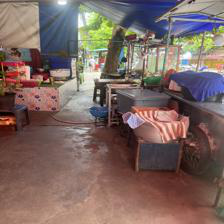



property image # old farm from the 19th century, completely renovated in a village.
----------


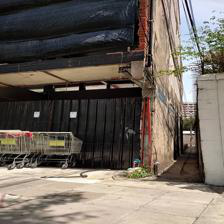



the front of the building is seen in this undated image.
----------


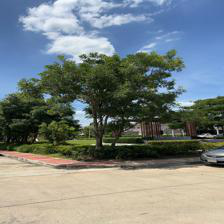



a view of the parking lot.
----------


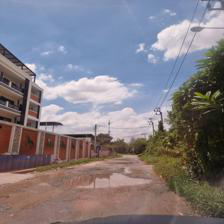



a view of the road from the car.
----------


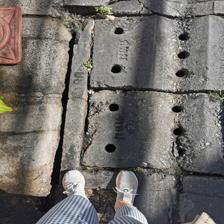



a hole in the pavement.
----------


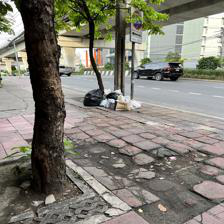



a tree fell on the sidewalk.
----------


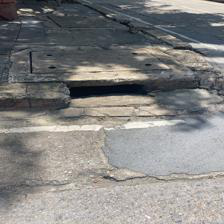



a hole in the road.
----------


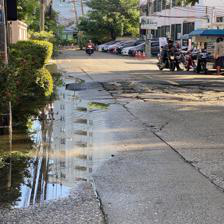



a car drives through a flooded street.
----------


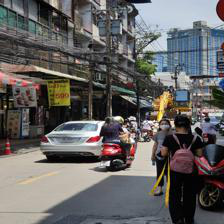



busy street in the city center.
----------


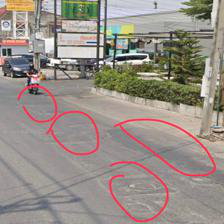



traffic is backed up on a busy street.
----------


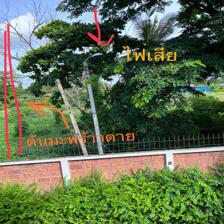



view of the house from the street.
----------


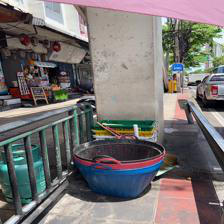



street market in the old town.
----------


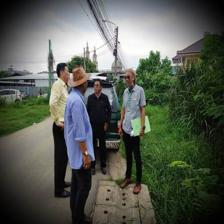



a group of men stand on the side of a road and talk to each other.
----------


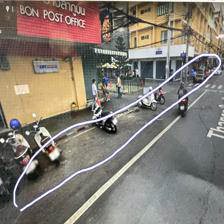



a police car is seen in this undated image.
----------


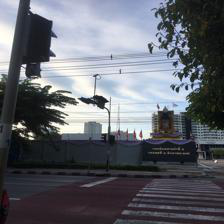



view of the city from our hotel room.
----------


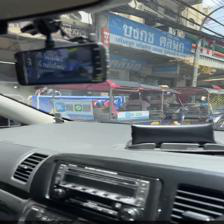



a car is seen in this undated file photo.
----------


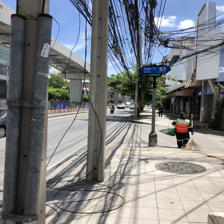



a man rides his scooter along a street.
----------


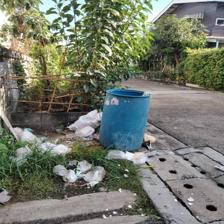



plastic bottles and litter litter litter the streets.
----------


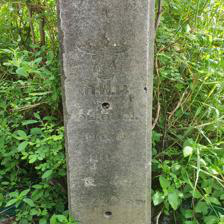



a sign on the side of a road.
----------


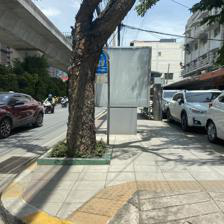



how to make the most of a small parking space.
----------


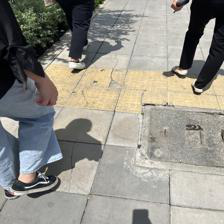



pedestrians walk past a sign that reads.
----------


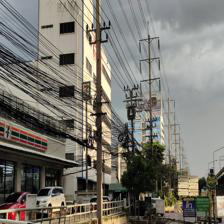



a view of a street.
----------


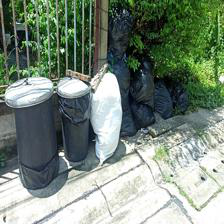



plastic bags in the garden.
----------


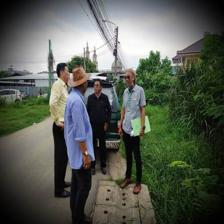



a group of men stand on the side of a road and talk to each other.
----------


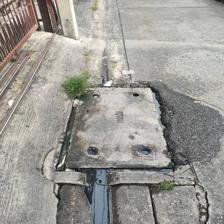



this is a picture of a pothole on a street.
----------


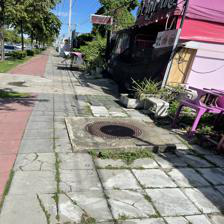



a city is one of the most polluted cities in the world, according to a new study.
----------


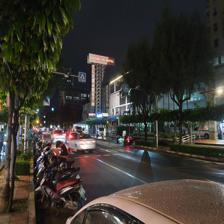



night view of the city.
----------


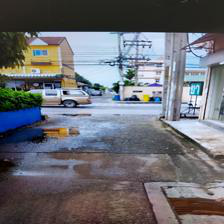



a car drives through a flooded street.
----------


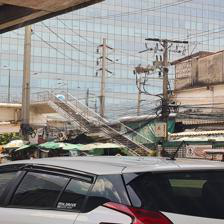



a crane was used to remove the roof of the building.
----------


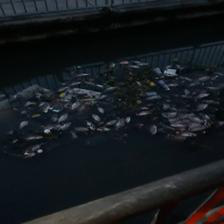



a lot of trash floating on the river.
----------


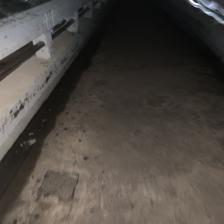



the car is stuck in the underground tunnel.
----------


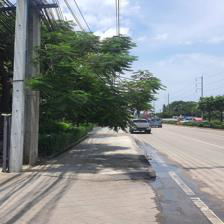



a city is one of the most polluted cities in the world.
----------


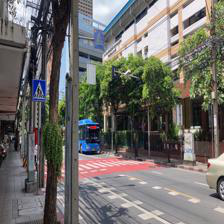



view of the street from our room.
----------


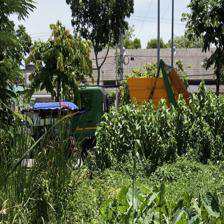



a tree is seen in this undated file photo.
----------


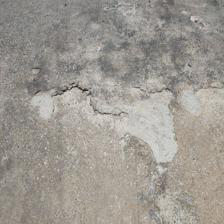



cracked asphalt on the road.
----------


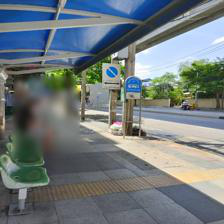



image used for illustrative purpose.
----------


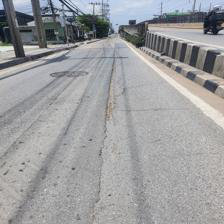



the road has been repaired and the road will be back to normal in a few days.
----------


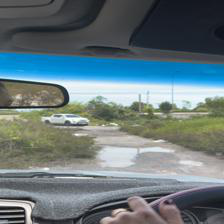



a driver's view of the road from inside his car.
----------


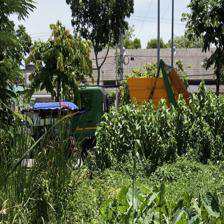



a tree is seen in this undated file photo.
----------


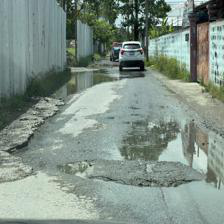



a pothole on the road.
----------


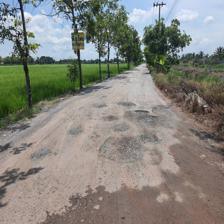



muddy road in the rice fields.
----------


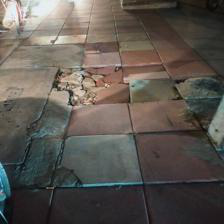



a hole in the floor.
----------


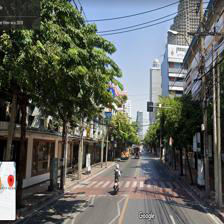



filming location is one of the most polluted cities in the world.
----------


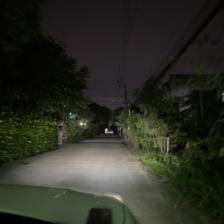



night view of the street.
----------


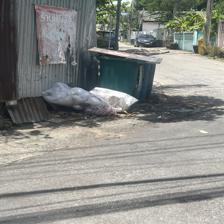



a pile of trash is seen on a street.
----------


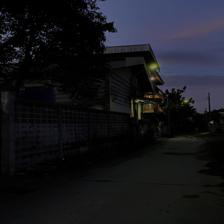



a night view of the main street.
----------


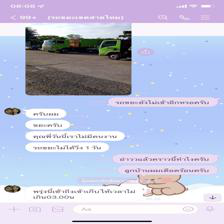



a screenshot of the app.
----------


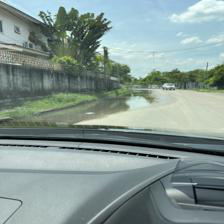



a car drives through a flooded road.
----------


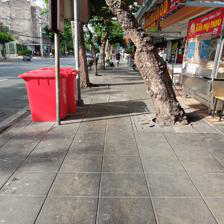



pedestrian walkway in the city.
----------


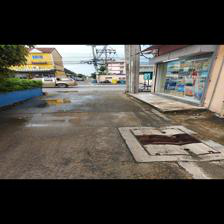



a view of the main road.
----------


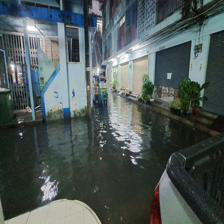



a waterlogged street at night.
----------


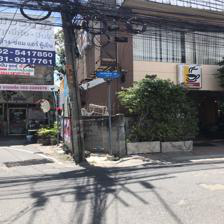



a man was shot and killed in the block of flats.
----------


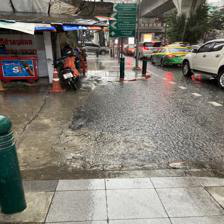



water pours down a sidewalk.
----------


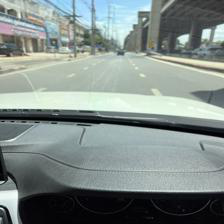



view of the car from the driver's seat.
----------


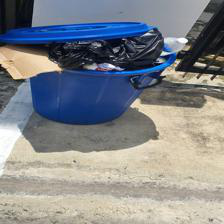



a bucket of water was found in the back yard of a home.
----------


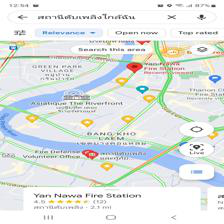



a screenshot of the app.
----------


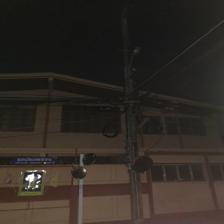



a man was struck by lightning while trying to cross a street at night.
----------


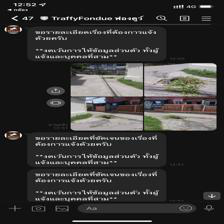



a screenshot of the app.
----------


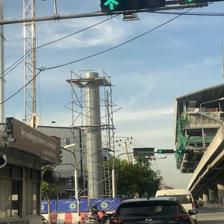



construction continues on a-story tower.
----------


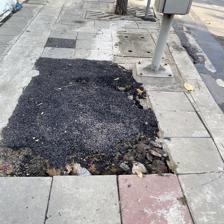



the hole in the pavement caused by the fire.
----------


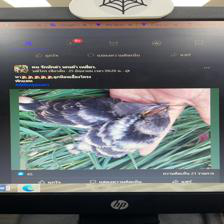



this is a photo of biological species.
----------


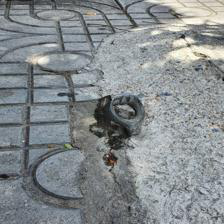



a hole in the pavement.
----------


In [ ]:
# Example of generated caption for 100 images (With Beam Search)
use_beam_search = True

for img in img_100:
  image = io.imread("/content/drive/Shareddrives/traffyImg/test/"+img) # We Doesn't provide image data
  pil_image = PIL.Image.fromarray(image)
  display(pil_image)
  image = preprocess(pil_image).unsqueeze(0).to(device)

  with torch.no_grad():
      prefix = clip_model.encode_image(image).to(device, dtype=torch.float32)
      prefix_embed = model.clip_project(prefix).reshape(1, prefix_length, -1)
  if use_beam_search:
      generated_text_prefix = generate_beam(model, tokenizer, embed=prefix_embed)[0]
  else:
      generated_text_prefix = generate2(model, tokenizer, embed=prefix_embed)

  print("\n")
  print(generated_text_prefix)
  print('----------')

# **Evaluate using BLEU and ROUGE**

In [10]:
import pandas as pd

test_df1 = pd.read_csv(r"E:\clipcap\teamchadchart_1_en.csv")
test_df2 = pd.read_csv(r"E:\clipcap\teamchadchart_2_en.csv")
test_df3 = pd.read_csv(r"E:\clipcap\teamchadchart_3_en.csv")

print(test_df1.shape)
print(test_df2.shape)
print(test_df3.shape)

(5000, 4)
(5000, 4)
(5000, 4)


In [11]:
test_df = pd.concat([test_df1, test_df2, test_df3], axis=0, ignore_index=True)
test_df = test_df.drop(columns=["sequence_length"])
test_df.head()

,photo,comment,comment_en
0,https://storage.googleapis.com/traffy_public_b...,ป้ายเตือนบนทางด่วนหัก เสี่ยงร่วง,Warning signs on the highway
1,https://storage.googleapis.com/traffy_public_b...,น้องหมาถูกรถชนขาหักครับ ตอนนี้แจ้งไปทางมูลนิธิ...,The dog was hit by a broken leg. Now informing...
2,https://storage.googleapis.com/traffy_public_b...,ฝาท่อชำรุดบริเวณรามอินทรา 5 แยก 15 ลานจอดรถตรง...,"The pipe cover is damaged at Ram Inthra 5, int..."
3,https://storage.googleapis.com/traffy_public_b...,สอบถามเรื่องการเก็บขยะเขตธนบุรี ซอยสมเด็จพระเจ...,"Inquire about garbage collection, Thonburi Dis..."
4,https://storage.googleapis.com/traffy_public_b...,ฝาท่อเมนชำรุดบริเวณร้านของเก่ารามอินทรา 5 แยก 15,The pipe cover is damaged at the Ram Inthra 5 ...


In [12]:
test_df["sequence_length"] = test_df["comment_en"].apply(lambda x: len(str(x)))
test_df

,photo,comment,comment_en,sequence_length
0,https://storage.googleapis.com/traffy_public_b...,ป้ายเตือนบนทางด่วนหัก เสี่ยงร่วง,Warning signs on the highway,28
1,https://storage.googleapis.com/traffy_public_b...,น้องหมาถูกรถชนขาหักครับ ตอนนี้แจ้งไปทางมูลนิธิ...,The dog was hit by a broken leg. Now informing...,103
2,https://storage.googleapis.com/traffy_public_b...,ฝาท่อชำรุดบริเวณรามอินทรา 5 แยก 15 ลานจอดรถตรง...,"The pipe cover is damaged at Ram Inthra 5, int...",93
3,https://storage.googleapis.com/traffy_public_b...,สอบถามเรื่องการเก็บขยะเขตธนบุรี ซอยสมเด็จพระเจ...,"Inquire about garbage collection, Thonburi Dis...",348
4,https://storage.googleapis.com/traffy_public_b...,ฝาท่อเมนชำรุดบริเวณร้านของเก่ารามอินทรา 5 แยก 15,The pipe cover is damaged at the Ram Inthra 5 ...,60
...,...,...,...,...
14995,https://storage.googleapis.com/traffy_public_b...,ร้องเรียนกทม ด้วยมาตรา 370 ผู้ใดส่งเสียงหร...,"Complaint with the Bangkok with Section 370, w...",406
14996,https://storage.googleapis.com/traffy_public_b...,ถนนเป็นหลุมใหญ่ รถตกหลุมหลายคันแล้วค่ะ,The road is a large hole. Many cars have fallen.,48
14997,https://storage.googleapis.com/traffy_public_b...,กลุ่มผู้ขับขี่จักรยานยนต์จอดอยู่บริเวณหน้าสถาบ...,Motorcycle riders parked in front of the Civil...,450
14998,https://storage.googleapis.com/traffy_public_b...,สายไฟฟ้าเปลือย พาดมาบนสะพานลอยคนข้ามอาจเป็นอัน...,Bare electrical cable Rounding on the overpass...,84


In [13]:
sequence_unuse_idx = test_df.loc[test_df["sequence_length"] > 70].index
test_df = test_df.drop(index=sequence_unuse_idx)
test_df

,photo,comment,comment_en,sequence_length
0,https://storage.googleapis.com/traffy_public_b...,ป้ายเตือนบนทางด่วนหัก เสี่ยงร่วง,Warning signs on the highway,28
4,https://storage.googleapis.com/traffy_public_b...,ฝาท่อเมนชำรุดบริเวณร้านของเก่ารามอินทรา 5 แยก 15,The pipe cover is damaged at the Ram Inthra 5 ...,60
6,https://storage.googleapis.com/traffy_public_b...,ถนนเป็นหลุม,The road is a hole.,19
7,https://storage.googleapis.com/traffy_public_b...,ซ่อมถนนเป็นหลุม,Repairing the road as a hole,28
9,https://storage.googleapis.com/traffy_public_b...,วัชรพืชขึ้นในลำรางข้างโกลเด้นแพลน,"Watcharaphi rises in Lamphaeng, Golden Plane.",45
...,...,...,...,...
14981,https://storage.googleapis.com/traffy_public_b...,ถนน,road,4
14985,https://storage.googleapis.com/traffy_public_b...,ประปารั่วซึมปากซอยสุขสวัสดิ์28,Plants leak at the mouth of Soi Suksawat 28,43
14988,https://storage.googleapis.com/traffy_public_b...,รถเมล์สายS1 คนขับไม่สวมหน้ากากอนามัยและคุยตลอดทาง,The S1 bus line does not wear a mask and talk ...,58
14993,https://storage.googleapis.com/traffy_public_b...,สายสื่อสาร ถูกปล่อยให้หย่อนจนเกือบถึงพื้นฟุตบาธ,The communication line was left to the ground.,46


In [ ]:
from PIL import Image
import requests
from io import BytesIO
from PIL import UnidentifiedImageError

use_beam_search = False # Change this to True for evaluate between beam vs no beam

gen_list = []

for img_path in test_df["photo"].values:
    response = requests.get(img_path)
    content = BytesIO(response.content)
    try:
        pil_image = Image.open(content)
        pil_image = pil_image.convert("RGB")
        image = preprocess(pil_image).unsqueeze(0).to(device)

        with torch.no_grad():
            prefix = clip_model.encode_image(image).to(device, dtype=torch.float32)
            prefix_embed = model.clip_project(prefix).reshape(1, prefix_length, -1)
        if use_beam_search:
            generated_text_prefix = generate_beam(model, tokenizer, embed=prefix_embed)[0]
        else:
            generated_text_prefix = generate2(model, tokenizer, embed=prefix_embed)

        gen_list.append(generated_text_prefix)
        print(generated_text_prefix)
        print('\n')
    
    except UnidentifiedImageError:
        print("UnidentifiedImageError at:", img_path)

100%|██████████| 1/1 [00:00<00:00, 11.42it/s]


a sign on the bridge.




100%|██████████| 1/1 [00:00<00:00,  8.45it/s]


the bricks were found in the street.




100%|██████████| 1/1 [00:00<00:00, 11.43it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  7.57it/s]


the road is lined with potholes.




100%|██████████| 1/1 [00:00<00:00,  7.79it/s]


the garden at the back of the house.




100%|██████████| 1/1 [00:00<00:00,  9.11it/s]


a street lamp in the city.




100%|██████████| 1/1 [00:00<00:00,  7.84it/s]


the garden was completely destroyed by the fire.




100%|██████████| 1/1 [00:00<00:00, 11.17it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00,  5.77it/s]


the building is located in the center of the city.




100%|██████████| 1/1 [00:00<00:00,  8.02it/s]


a pothole on the road.




100%|██████████| 1/1 [00:00<00:00,  7.03it/s]


the road is now completely covered with mud.




100%|██████████| 1/1 [00:00<00:00,  6.40it/s]


a road in the middle of a lake.




100%|██████████| 1/1 [00:00<00:00, 10.42it/s]


dogs walking down the street.




100%|██████████| 1/1 [00:00<00:00,  8.05it/s]


the water is flowing in the river.




100%|██████████| 1/1 [00:00<00:00,  6.53it/s]


the river is full of trash.




100%|██████████| 1/1 [00:00<00:00,  6.94it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00, 11.63it/s]


the gate to the house.




100%|██████████| 1/1 [00:00<00:00,  3.71it/s]


the road to the train station.




100%|██████████| 1/1 [00:00<00:00, 11.08it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.25it/s]


the house is on the right side of the road.




100%|██████████| 1/1 [00:00<00:00,  8.37it/s]


the concrete floor is a bit rough.




100%|██████████| 1/1 [00:00<00:00,  6.67it/s]


a man walks past a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  9.75it/s]


a street lamp on a street.




100%|██████████| 1/1 [00:00<00:00, 10.41it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00, 11.92it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00,  7.54it/s]


the road is marked with a red circle.




100%|██████████| 1/1 [00:00<00:00, 11.28it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.17it/s]


the map shows the location of the bus.




100%|██████████| 1/1 [00:00<00:00,  5.46it/s]


a motorcyclist rides his scooter through the streets.




100%|██████████| 1/1 [00:00<00:00,  9.35it/s]


the street is lined with plants.




100%|██████████| 1/1 [00:00<00:00, 11.18it/s]


the app on a smartphone.




100%|██████████| 1/1 [00:00<00:00, 11.64it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.65it/s]


the asphalt road in the city.




100%|██████████| 1/1 [00:00<00:00,  8.73it/s]


a pothole on the road.




100%|██████████| 1/1 [00:00<00:00,  6.76it/s]


the road is closed for the next few days.




100%|██████████| 1/1 [00:00<00:00,  7.45it/s]


the car was driving at a mph speed.




100%|██████████| 1/1 [00:00<00:00,  7.42it/s]


a man rides his bike on a street.




100%|██████████| 1/1 [00:00<00:00,  9.21it/s]


the sidewalk is covered in ice.




100%|██████████| 1/1 [00:00<00:00, 11.43it/s]


a man crosses a road.




100%|██████████| 1/1 [00:00<00:00, 10.43it/s]


the hole in the wall.




100%|██████████| 1/1 [00:00<00:00,  7.53it/s]


the train is going up the railway track.




100%|██████████| 1/1 [00:00<00:00, 11.24it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  9.43it/s]


the streets are lined with taxis.




100%|██████████| 1/1 [00:00<00:00,  8.83it/s]


the truck was loaded with the supplies.




100%|██████████| 1/1 [00:00<00:00,  7.73it/s]


the tree in the middle of the street.




100%|██████████| 1/1 [00:00<00:00,  7.34it/s]


the road is closed for a short period.




100%|██████████| 1/1 [00:00<00:00, 11.42it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  8.56it/s]


the road was completely blocked by cars.




100%|██████████| 1/1 [00:00<00:00, 10.04it/s]


the car was covered in ice.




100%|██████████| 1/1 [00:00<00:00, 11.46it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.68it/s]


the road is closed for the next few days.




100%|██████████| 1/1 [00:00<00:00,  8.50it/s]


the building that used to house business.




100%|██████████| 1/1 [00:00<00:00,  6.71it/s]


the street is a mess of wires and wires.




100%|██████████| 1/1 [00:00<00:00, 11.24it/s]


a house in the district.




100%|██████████| 1/1 [00:00<00:00,  8.52it/s]


the view from our room at night.




100%|██████████| 1/1 [00:00<00:00,  8.32it/s]


a truck carrying a load of wood.




100%|██████████| 1/1 [00:00<00:00, 11.45it/s]


the hole in the wall.




100%|██████████| 1/1 [00:00<00:00,  8.18it/s]


motorcycles parked on the street.




100%|██████████| 1/1 [00:00<00:00,  8.73it/s]


motorcycles parked on the street.




100%|██████████| 1/1 [00:00<00:00, 10.98it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  8.85it/s]


the pavement is completely covered in debris.




100%|██████████| 1/1 [00:00<00:00, 11.16it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 10.12it/s]


the bus is a bit crowded.




100%|██████████| 1/1 [00:00<00:00,  7.78it/s]


a man was hit by a car.




100%|██████████| 1/1 [00:00<00:00, 10.91it/s]


the view from my car.




100%|██████████| 1/1 [00:00<00:00,  5.34it/s]


a man is seen standing next to a car in a street.




100%|██████████| 1/1 [00:00<00:00,  7.42it/s]


a pile of discarded clothes and other rubbish.




100%|██████████| 1/1 [00:00<00:00,  7.61it/s]


the old stone pavement of the street.




100%|██████████| 1/1 [00:00<00:00,  8.55it/s]


a car with a sign that says.




100%|██████████| 1/1 [00:00<00:00,  6.88it/s]


the street is a mess of plants and weeds.




100%|██████████| 1/1 [00:00<00:00,  7.64it/s]


smoke billowing from the chimney.




100%|██████████| 1/1 [00:00<00:00, 10.11it/s]


the street leading to the house.




100%|██████████| 1/1 [00:00<00:00,  9.45it/s]


the road is now a mess.




100%|██████████| 1/1 [00:00<00:00,  8.09it/s]


the building is in need of repair.




100%|██████████| 1/1 [00:00<00:00,  7.72it/s]


a street lamp with the name of politician.




100%|██████████| 1/1 [00:00<00:00, 11.20it/s]


the bridge over the river.




100%|██████████| 1/1 [00:00<00:00,  9.08it/s]


a dog running on the street.




100%|██████████| 1/1 [00:00<00:00, 10.82it/s]


a hole in the concrete.




100%|██████████| 1/1 [00:00<00:00, 10.89it/s]


the road to the temple.




100%|██████████| 1/1 [00:00<00:00,  6.50it/s]


the road is closed for the next few days.




100%|██████████| 1/1 [00:00<00:00,  9.45it/s]


the text of the proposed marriage.




100%|██████████| 1/1 [00:00<00:00,  8.74it/s]


smoke billowing from the intersection.




100%|██████████| 1/1 [00:00<00:00, 10.80it/s]


the view from the car.




100%|██████████| 1/1 [00:00<00:00,  6.93it/s]


a man walks past a puddle of water.




100%|██████████| 1/1 [00:00<00:00,  9.63it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  8.65it/s]


the wall of the underground station.




100%|██████████| 1/1 [00:00<00:00,  9.83it/s]


the bus station at night.




100%|██████████| 1/1 [00:00<00:00,  6.74it/s]


a tree growing on the side of a building.




100%|██████████| 1/1 [00:00<00:00,  5.88it/s]


the city at night, with the lights of the city.




100%|██████████| 1/1 [00:00<00:00, 10.52it/s]


the view from the street.




100%|██████████| 1/1 [00:00<00:00,  5.09it/s]


the story of the girl who fell in love with a man.




100%|██████████| 1/1 [00:00<00:00, 10.10it/s]


the night view from the street.




100%|██████████| 1/1 [00:00<00:00,  6.57it/s]


the cat was found in a kennel.




100%|██████████| 1/1 [00:00<00:00,  7.54it/s]


image of a screenshot of the app.




100%|██████████| 1/1 [00:00<00:00,  5.76it/s]


4k light leaks footage for different events and projects!.




100%|██████████| 1/1 [00:00<00:00,  8.42it/s]


the tree that fell on our house.




100%|██████████| 1/1 [00:00<00:00,  5.52it/s]


4k light leaks footage for different events and projects!.




100%|██████████| 1/1 [00:00<00:00,  6.27it/s]


the road was closed for several hours after the incident.




100%|██████████| 1/1 [00:00<00:00,  8.16it/s]


the car was left in the rain.




100%|██████████| 1/1 [00:00<00:00,  7.87it/s]


a tree with a sign that says.




100%|██████████| 1/1 [00:00<00:00,  4.50it/s]


the traffic is so bad that it's almost like a ghost town.




100%|██████████| 1/1 [00:00<00:00,  5.47it/s]


person, the director, said the meeting was a success.




100%|██████████| 1/1 [00:00<00:00,  8.24it/s]


a man was struck by a car.




100%|██████████| 1/1 [00:00<00:00,  8.72it/s]


the house is now in ruins.




100%|██████████| 1/1 [00:00<00:00, 10.90it/s]


the road to the temple.




100%|██████████| 1/1 [00:00<00:00,  9.65it/s]


the night sky over the house.




100%|██████████| 1/1 [00:00<00:00, 11.41it/s]


the street lights at night.




100%|██████████| 1/1 [00:00<00:00,  6.72it/s]


a balloon is seen flying over a residential area.




100%|██████████| 1/1 [00:00<00:00,  8.07it/s]


the view from our room at night.




100%|██████████| 1/1 [00:00<00:00, 11.69it/s]


the view from my window.




100%|██████████| 1/1 [00:00<00:00, 11.34it/s]


the lights of the city.




100%|██████████| 1/1 [00:00<00:00, 10.95it/s]


the floor of the building.




100%|██████████| 1/1 [00:00<00:00,  8.88it/s]


a street in the old town.




100%|██████████| 1/1 [00:00<00:00,  5.56it/s]


workers install a new floor in the front yard of a home.




100%|██████████| 1/1 [00:00<00:00,  8.60it/s]


man cleaning the sidewalk with a shovel.




100%|██████████| 1/1 [00:00<00:00, 10.34it/s]


the screen is black with white.




100%|██████████| 1/1 [00:00<00:00,  5.07it/s]


the traffic is bad, but it's still pretty good.




100%|██████████| 1/1 [00:00<00:00, 11.72it/s]


the car park at night.




100%|██████████| 1/1 [00:00<00:00,  8.21it/s]


the streets are always crowded with people.




100%|██████████| 1/1 [00:00<00:00,  8.70it/s]


the traffic jam on the way.




100%|██████████| 1/1 [00:00<00:00,  7.13it/s]


the light at the end of the tunnel.




100%|██████████| 1/1 [00:00<00:00,  4.59it/s]


the water was so high that it was running out of the car window.




100%|██████████| 1/1 [00:00<00:00,  5.74it/s]


time lapse of a train passing through a station at night.




100%|██████████| 1/1 [00:00<00:00,  7.82it/s]


the bridge is lit up at night.




100%|██████████| 1/1 [00:00<00:00, 10.66it/s]


the tables are all empty.




100%|██████████| 1/1 [00:00<00:00,  6.12it/s]


a man is seen riding a bike through the intersection.




100%|██████████| 1/1 [00:00<00:00,  3.83it/s]


the most popular tags for this image include : opinion, opinion, opinion and opinion.




100%|██████████| 1/1 [00:00<00:00, 10.04it/s]


the main road to the airport.




100%|██████████| 1/1 [00:00<00:00,  9.74it/s]


the road is a little narrow.




100%|██████████| 1/1 [00:00<00:00,  6.23it/s]


the car is stuck in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  3.62it/s]


the dog's owner was able to get a closer look at the dog's face.




100%|██████████| 1/1 [00:00<00:00,  5.18it/s]


the water level is low, but the water is still rising.




100%|██████████| 1/1 [00:00<00:00,  7.56it/s]


a pile of discarded plastic bottles and litter.




100%|██████████| 1/1 [00:00<00:00,  6.84it/s]


the road is closed for the next few hours.




100%|██████████| 1/1 [00:00<00:00,  2.90it/s]


a city is a busy place, but it's also a place where you can find bikes and other vehicles.




100%|██████████| 1/1 [00:00<00:00,  5.95it/s]


the pavement is a bit too narrow for the pavement.




100%|██████████| 1/1 [00:00<00:00,  5.06it/s]


the water level is low, but the water is still very polluted.




100%|██████████| 1/1 [00:00<00:00,  9.33it/s]


the pavement was covered in mould.




100%|██████████| 1/1 [00:00<00:00, 10.79it/s]


the roof of the building.




100%|██████████| 1/1 [00:00<00:00,  8.46it/s]


the road is completely blocked by concrete.




100%|██████████| 1/1 [00:00<00:00,  6.25it/s]


the car was left in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  9.59it/s]


the sidewalk is covered in graffiti.




100%|██████████| 1/1 [00:00<00:00,  9.83it/s]


the floor is a bit uneven.




100%|██████████| 1/1 [00:00<00:00,  6.42it/s]


close up of a car's door handle.




100%|██████████| 1/1 [00:00<00:00,  9.57it/s]


the house where person was found.




100%|██████████| 1/1 [00:00<00:00, 11.46it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  8.82it/s]


the sidewalk is covered in concrete.




100%|██████████| 1/1 [00:00<00:00,  9.82it/s]


the road is covered with plastic.




100%|██████████| 1/1 [00:00<00:00,  5.38it/s]


a pile of trash is seen in front of a home.




100%|██████████| 1/1 [00:00<00:00,  5.89it/s]


the trash was found in the back yard of a home.




100%|██████████| 1/1 [00:00<00:00,  8.85it/s]


a bicycle parked next to a tree.




100%|██████████| 1/1 [00:00<00:00,  7.66it/s]


a man rides his bike down a street.




100%|██████████| 1/1 [00:00<00:00,  6.82it/s]


a man is driving a motorcycle on a street.




100%|██████████| 1/1 [00:00<00:00,  9.43it/s]


the road surface after the repair.




100%|██████████| 1/1 [00:00<00:00,  9.21it/s]


a few of the plastic containers.




100%|██████████| 1/1 [00:00<00:00, 11.31it/s]


the road to the house.




100%|██████████| 1/1 [00:00<00:00, 11.34it/s]


the hole in the ground.




100%|██████████| 1/1 [00:00<00:00,  8.42it/s]


the road is now paved with concrete.




100%|██████████| 1/1 [00:00<00:00,  6.69it/s]


a broken bench in the middle of a street.




100%|██████████| 1/1 [00:00<00:00, 10.26it/s]


construction worker laying a road.




100%|██████████| 1/1 [00:00<00:00,  8.12it/s]


a cyclist is seen on the street.




100%|██████████| 1/1 [00:00<00:00,  7.43it/s]


the street is marked with a street sign.




100%|██████████| 1/1 [00:00<00:00,  2.78it/s]


i'm not sure what kind of printer this is, but it's a nice way to store your pens.




100%|██████████| 1/1 [00:00<00:00, 10.06it/s]


a tree with a power line.




100%|██████████| 1/1 [00:00<00:00,  9.28it/s]


the pavement is a bit rough.




100%|██████████| 1/1 [00:00<00:00,  8.37it/s]


the view from the living room.




100%|██████████| 1/1 [00:00<00:00,  9.47it/s]


a boy walks down a street.




100%|██████████| 1/1 [00:00<00:00, 11.22it/s]


the tree in the courtyard.




100%|██████████| 1/1 [00:00<00:00,  6.25it/s]


a red mailbox stands in the middle of a street.




100%|██████████| 1/1 [00:00<00:00,  7.62it/s]


the garden is a bit of a mess.




100%|██████████| 1/1 [00:00<00:00,  7.63it/s]


the road is now completely blocked by concrete.




100%|██████████| 1/1 [00:00<00:00,  8.58it/s]


the car is parked on the street.




100%|██████████| 1/1 [00:00<00:00,  6.28it/s]


the number of people who have been diagnosed with autism.




100%|██████████| 1/1 [00:00<00:00, 11.19it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  9.37it/s]


a street scene in the city.




100%|██████████| 1/1 [00:00<00:00,  8.09it/s]


the river is a popular tourist destination.




100%|██████████| 1/1 [00:00<00:00,  7.11it/s]


the street is lined with benches and benches.




100%|██████████| 1/1 [00:00<00:00, 10.67it/s]


the view from the bridge.




100%|██████████| 1/1 [00:00<00:00,  8.34it/s]


a pile of rubbish on the street.




100%|██████████| 1/1 [00:00<00:00,  9.15it/s]


a man walks past a temple.




100%|██████████| 1/1 [00:00<00:00,  7.99it/s]


the car was stuck in the water.




100%|██████████| 1/1 [00:00<00:00,  9.46it/s]


the floor of the house.




100%|██████████| 1/1 [00:00<00:00,  9.58it/s]


the streets are lined with cars.




100%|██████████| 1/1 [00:00<00:00, 11.34it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.61it/s]


the intersection is seen in this undated image.




100%|██████████| 1/1 [00:00<00:00, 10.39it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 11.10it/s]


a hole in the road.




100%|██████████| 1/1 [00:00<00:00,  6.86it/s]


a man rides a scooter through the streets.




100%|██████████| 1/1 [00:00<00:00,  6.04it/s]


a taxi driver is seen in this undated image.




100%|██████████| 1/1 [00:00<00:00,  8.10it/s]


the car was parked in the street.




100%|██████████| 1/1 [00:00<00:00,  6.10it/s]


a car is seen in the middle of a road.




100%|██████████| 1/1 [00:00<00:00,  6.84it/s]


a man washes his car on the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  8.47it/s]


the old brick wall of the house.




100%|██████████| 1/1 [00:00<00:00,  5.47it/s]


a car is seen in the middle of a busy road.




100%|██████████| 1/1 [00:00<00:00, 11.16it/s]


the hole in the wall.




100%|██████████| 1/1 [00:00<00:00, 10.82it/s]


the shadow of the tiles.




100%|██████████| 1/1 [00:00<00:00,  6.40it/s]


smoke from the chimney of a factory.




100%|██████████| 1/1 [00:00<00:00,  6.47it/s]


the roof of the house is covered with tiles.




100%|██████████| 1/1 [00:00<00:00, 11.13it/s]


the view from our room.




100%|██████████| 1/1 [00:00<00:00,  9.41it/s]


a street scene in the city.




100%|██████████| 1/1 [00:00<00:00,  8.56it/s]


a man plays cricket on the streets.




100%|██████████| 1/1 [00:00<00:00, 10.58it/s]


the road in the countryside.




100%|██████████| 1/1 [00:00<00:00,  6.13it/s]


the man was seen walking down the street at night.




100%|██████████| 1/1 [00:00<00:00,  8.03it/s]


a homeless man sleeps on the street.




100%|██████████| 1/1 [00:00<00:00,  8.00it/s]


the wall of vines and ivy.




100%|██████████| 1/1 [00:00<00:00,  6.55it/s]


a man is cleaning the windows of his house.




100%|██████████| 1/1 [00:00<00:00,  6.90it/s]


smoke billowing from the chimney.




100%|██████████| 1/1 [00:00<00:00, 10.55it/s]


a fire in the garden.




100%|██████████| 1/1 [00:00<00:00,  7.55it/s]


raindrops on the floor and the floor.




100%|██████████| 1/1 [00:00<00:00, 10.97it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.37it/s]


the road is now completely blocked by roadworks.




100%|██████████| 1/1 [00:00<00:00,  6.63it/s]


a woman is cleaning the road with a brush.




100%|██████████| 1/1 [00:00<00:00,  9.66it/s]


the parking lot is under construction.




100%|██████████| 1/1 [00:00<00:00,  9.76it/s]


the view from the train station.




100%|██████████| 1/1 [00:00<00:00,  5.21it/s]


a truck driver was caught on camera driving through a busy intersection.




100%|██████████| 1/1 [00:00<00:00,  7.59it/s]


the street is lined with shops and restaurants.




100%|██████████| 1/1 [00:00<00:00, 10.71it/s]


a poster for the festival.




100%|██████████| 1/1 [00:00<00:00,  7.69it/s]


the light at the end of the tunnel.




100%|██████████| 1/1 [00:00<00:00,  7.70it/s]


a tree on the roof of a building.




100%|██████████| 1/1 [00:00<00:00,  7.25it/s]


a discarded skateboard sits on the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  7.57it/s]


the construction site for the new building.




100%|██████████| 1/1 [00:00<00:00,  8.76it/s]


person on the top of the world.




100%|██████████| 1/1 [00:00<00:00,  9.36it/s]


the road is covered with concrete.




100%|██████████| 1/1 [00:00<00:00, 10.23it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00, 11.28it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  9.47it/s]


the road is closed for traffic.




100%|██████████| 1/1 [00:00<00:00,  8.25it/s]


a man walks past a power line.




100%|██████████| 1/1 [00:00<00:00,  6.67it/s]


a man rides his motorcycle on a busy road.




100%|██████████| 1/1 [00:00<00:00,  6.37it/s]


the car was left in the street after the accident.




100%|██████████| 1/1 [00:00<00:00,  9.62it/s]


the car was covered in dirt.




100%|██████████| 1/1 [00:00<00:00,  6.96it/s]


the tree in the middle of the street.




100%|██████████| 1/1 [00:00<00:00, 11.36it/s]


the sign on the street.




100%|██████████| 1/1 [00:00<00:00, 10.60it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  4.90it/s]


the water was so high that it was dripping from the pipe.




100%|██████████| 1/1 [00:00<00:00, 10.12it/s]


the traffic jam on the road.




100%|██████████| 1/1 [00:00<00:00, 10.80it/s]


a hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00,  7.72it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  8.07it/s]


a man was hit by a car.




100%|██████████| 1/1 [00:00<00:00, 11.11it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  7.43it/s]


a tree in the middle of a road.




100%|██████████| 1/1 [00:00<00:00,  8.20it/s]


a city is a busy street.




100%|██████████| 1/1 [00:00<00:00,  7.98it/s]


the power lines are still in place.




100%|██████████| 1/1 [00:00<00:00, 10.90it/s]


the app on a smartphone.




100%|██████████| 1/1 [00:00<00:00,  9.66it/s]


the hole in the wall.




100%|██████████| 1/1 [00:00<00:00,  7.88it/s]


a woman walks through a puddle.




100%|██████████| 1/1 [00:00<00:00,  6.62it/s]


this sign is on the side of the road.




100%|██████████| 1/1 [00:00<00:00,  8.46it/s]


the street where the cafe is located.




100%|██████████| 1/1 [00:00<00:00, 11.04it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  4.37it/s]


the road is a little narrow, but it's still pretty good.




100%|██████████| 1/1 [00:00<00:00,  7.29it/s]


the old man is walking on the street.




100%|██████████| 1/1 [00:00<00:00, 10.09it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  6.31it/s]


the car was left in the street after the incident.




100%|██████████| 1/1 [00:00<00:00,  9.80it/s]


the app is available for free.




100%|██████████| 1/1 [00:00<00:00,  9.36it/s]


the streets are lined with houses.




100%|██████████| 1/1 [00:00<00:00, 11.27it/s]


the back of the house.




100%|██████████| 1/1 [00:00<00:00, 11.80it/s]


the hole in the floor.




100%|██████████| 1/1 [00:00<00:00, 10.88it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00, 10.78it/s]


the girl in the dark.




100%|██████████| 1/1 [00:00<00:00,  9.12it/s]


a street lamp in the district.




100%|██████████| 1/1 [00:00<00:00,  6.76it/s]


stairs leading up to the top of the building.




100%|██████████| 1/1 [00:00<00:00,  5.81it/s]


the man was seen standing in the middle of the street.




100%|██████████| 1/1 [00:00<00:00,  9.23it/s]


the street is full of people.




100%|██████████| 1/1 [00:00<00:00,  7.20it/s]


the house where person lived with his mother.




100%|██████████| 1/1 [00:00<00:00,  7.29it/s]


the streets are lined with cars and buses.




100%|██████████| 1/1 [00:00<00:00,  8.27it/s]


the parking lot is a bit crowded.




100%|██████████| 1/1 [00:00<00:00,  7.18it/s]


time lapse of traffic on a busy street.




100%|██████████| 1/1 [00:00<00:00, 10.87it/s]


the view from the car.




100%|██████████| 1/1 [00:00<00:00,  7.29it/s]


a tree in the middle of the night.




100%|██████████| 1/1 [00:00<00:00,  8.13it/s]


a wheelbarrow full of rubbish.




100%|██████████| 1/1 [00:00<00:00, 11.09it/s]


the view from the balcony.




100%|██████████| 1/1 [00:00<00:00, 11.22it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  9.08it/s]


the road is closed for vehicles.




100%|██████████| 1/1 [00:00<00:00,  7.31it/s]


the street is lined with shops and restaurants.




100%|██████████| 1/1 [00:00<00:00, 11.40it/s]


the lights of the city.




100%|██████████| 1/1 [00:00<00:00,  9.25it/s]


the stone wall of the house.




100%|██████████| 1/1 [00:00<00:00,  9.44it/s]


a street vendor selling street art.




100%|██████████| 1/1 [00:00<00:00,  6.36it/s]


the house is in the middle of a busy street.




100%|██████████| 1/1 [00:00<00:00,  4.14it/s]


automobile model is a compact car that can be found in many different styles.




100%|██████████| 1/1 [00:00<00:00, 10.10it/s]


the wooden deck of the ship.




100%|██████████| 1/1 [00:00<00:00,  8.93it/s]


the streets are lined with cars.




100%|██████████| 1/1 [00:00<00:00,  9.42it/s]


the moon rising over the city.




100%|██████████| 1/1 [00:00<00:00,  9.34it/s]


the street is lined with cars.




100%|██████████| 1/1 [00:00<00:00, 11.07it/s]


a street in the city.




100%|██████████| 1/1 [00:00<00:00,  9.27it/s]


the traffic jam on the road.




100%|██████████| 1/1 [00:00<00:00,  9.44it/s]


a man sleeps on the sidewalk.




100%|██████████| 1/1 [00:00<00:00, 10.66it/s]


the city lights at night.




100%|██████████| 1/1 [00:00<00:00,  5.95it/s]


the car was spotted in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  6.65it/s]


a man walks down a street in the evening.




100%|██████████| 1/1 [00:00<00:00,  7.69it/s]


the sidewalk is completely covered in broken tiles.




100%|██████████| 1/1 [00:00<00:00,  7.71it/s]


the view from the top of the building.




100%|██████████| 1/1 [00:00<00:00, 11.61it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  7.01it/s]


the traffic jam on the way to the airport.




100%|██████████| 1/1 [00:00<00:00,  7.69it/s]


the road is closed for the night.




100%|██████████| 1/1 [00:00<00:00,  6.34it/s]


the car was spotted in the middle of a road.




100%|██████████| 1/1 [00:00<00:00, 11.24it/s]


a street vendor selling flowers.




100%|██████████| 1/1 [00:00<00:00,  9.07it/s]


the streets are empty at night.




100%|██████████| 1/1 [00:00<00:00, 10.88it/s]


the view from the hotel.




100%|██████████| 1/1 [00:00<00:00, 10.78it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00, 11.41it/s]


a hole in the road.




100%|██████████| 1/1 [00:00<00:00,  6.14it/s]


the sidewalk is a bit too narrow for the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  8.49it/s]


the fire was reported at the home.




100%|██████████| 1/1 [00:00<00:00,  8.17it/s]


a pile of trash in the street.




100%|██████████| 1/1 [00:00<00:00, 10.90it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  3.35it/s]


the man was seen standing in the middle of the road and then running away from the car.




100%|██████████| 1/1 [00:00<00:00, 10.16it/s]


a motorcycle parked outside a restaurant.




100%|██████████| 1/1 [00:00<00:00, 11.26it/s]


the view from our room.




100%|██████████| 1/1 [00:00<00:00,  9.67it/s]


the road is now under construction.




100%|██████████| 1/1 [00:00<00:00, 10.79it/s]


a street in the city.




100%|██████████| 1/1 [00:00<00:00,  9.56it/s]


a man walks down a street.




100%|██████████| 1/1 [00:00<00:00,  7.01it/s]


the car is seen in this undated image.




100%|██████████| 1/1 [00:00<00:00, 11.60it/s]


the view from the car.




100%|██████████| 1/1 [00:00<00:00, 10.50it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 11.56it/s]


the street is a mess.




100%|██████████| 1/1 [00:00<00:00, 11.57it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  6.02it/s]


the road is now completely blocked by the bulldozer.




100%|██████████| 1/1 [00:00<00:00,  8.66it/s]


see more photos for this motorcycle listing.




100%|██████████| 1/1 [00:00<00:00, 11.28it/s]


the traffic is very bad.




100%|██████████| 1/1 [00:00<00:00,  5.74it/s]


a man is seen pushing a broken car along a road.




100%|██████████| 1/1 [00:00<00:00,  8.41it/s]


driving through the streets of the city.




100%|██████████| 1/1 [00:00<00:00,  6.94it/s]


a man rides a scooter along a street.




100%|██████████| 1/1 [00:00<00:00, 10.83it/s]


a street vendor selling flowers.




100%|██████████| 1/1 [00:00<00:00,  9.38it/s]


a man walks past a building.




100%|██████████| 1/1 [00:00<00:00,  5.66it/s]


the car is parked in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  6.83it/s]


a view of a street with a broken bridge.




100%|██████████| 1/1 [00:00<00:00,  9.15it/s]


a man walks past a shop.




100%|██████████| 1/1 [00:00<00:00,  8.43it/s]


a pile of trash in the street.




100%|██████████| 1/1 [00:00<00:00,  7.58it/s]


the road is now completely covered in debris.




100%|██████████| 1/1 [00:00<00:00, 11.24it/s]


the road in the park.




100%|██████████| 1/1 [00:00<00:00, 11.38it/s]


a street vendor selling food.




100%|██████████| 1/1 [00:00<00:00, 11.28it/s]


the path to the beach.




100%|██████████| 1/1 [00:00<00:00, 11.11it/s]


the pipe in the cave.




100%|██████████| 1/1 [00:00<00:00,  9.31it/s]


a pile of discarded plastic bottles.




100%|██████████| 1/1 [00:00<00:00,  6.42it/s]


the car was spotted on the side of the road.




100%|██████████| 1/1 [00:00<00:00,  9.35it/s]


the cables that connect the buildings.




100%|██████████| 1/1 [00:00<00:00,  7.60it/s]


the building in the middle of the street.




100%|██████████| 1/1 [00:00<00:00,  9.00it/s]


the sidewalk is completely covered in water.




100%|██████████| 1/1 [00:00<00:00,  8.46it/s]


the road is completely covered in mud.




100%|██████████| 1/1 [00:00<00:00,  8.35it/s]


the rear view mirror of the car.




100%|██████████| 1/1 [00:00<00:00, 13.41it/s]


a crack in asphalt.




100%|██████████| 1/1 [00:00<00:00, 12.03it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  7.41it/s]


the intersection is marked with a red line.




100%|██████████| 1/1 [00:00<00:00,  6.97it/s]


a dog is seen in this undated image.




100%|██████████| 1/1 [00:00<00:00,  7.53it/s]


the road is closed for a few hours.




100%|██████████| 1/1 [00:00<00:00,  7.78it/s]


the road is now completely covered with concrete.




100%|██████████| 1/1 [00:00<00:00, 10.00it/s]


the sidewalk is covered in ice.




100%|██████████| 1/1 [00:00<00:00, 11.06it/s]


a pile of plastic bottles.




100%|██████████| 1/1 [00:00<00:00,  7.25it/s]


shadow of a man walking on the street.




100%|██████████| 1/1 [00:00<00:00, 11.95it/s]


the sidewalk is a mess.




100%|██████████| 1/1 [00:00<00:00,  8.53it/s]


the train is passing through the station.




100%|██████████| 1/1 [00:00<00:00,  4.82it/s]


the train tracks are empty, the tracks are going to the ground.




100%|██████████| 1/1 [00:00<00:00, 10.65it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  9.04it/s]


the sidewalk is a bit muddy.




100%|██████████| 1/1 [00:00<00:00,  7.08it/s]


the tree in the middle of the street.




100%|██████████| 1/1 [00:00<00:00,  9.76it/s]


the asphalt is cracked and cracked.




100%|██████████| 1/1 [00:00<00:00,  9.04it/s]


a city is a beautiful city.




100%|██████████| 1/1 [00:00<00:00, 11.64it/s]


a bus stop selling vegetables.




100%|██████████| 1/1 [00:00<00:00,  6.66it/s]


a car is stuck in a pothole.




100%|██████████| 1/1 [00:00<00:00, 10.62it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  9.16it/s]


a pile of discarded plastic bottles.




100%|██████████| 1/1 [00:00<00:00,  8.71it/s]


the road is completely covered with water.




100%|██████████| 1/1 [00:00<00:00,  9.45it/s]


traffic jam on the bridge.




100%|██████████| 1/1 [00:00<00:00,  9.65it/s]


the road is covered with mud.




100%|██████████| 1/1 [00:00<00:00,  5.58it/s]


a city is a city with a population of around 3.




100%|██████████| 1/1 [00:00<00:00, 11.52it/s]


the map of the area.




100%|██████████| 1/1 [00:00<00:00,  7.32it/s]


a truck carrying a large box of ice.




100%|██████████| 1/1 [00:00<00:00,  6.55it/s]


a tree on the side of a bridge.




100%|██████████| 1/1 [00:00<00:00, 11.16it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  9.79it/s]


the streets are full of people.




100%|██████████| 1/1 [00:00<00:00, 11.12it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  8.33it/s]


the car was parked in the street.




100%|██████████| 1/1 [00:00<00:00,  8.56it/s]


a man selling food on the street.




100%|██████████| 1/1 [00:00<00:00,  4.36it/s]


the road is a little narrow, but it's still pretty nice.




100%|██████████| 1/1 [00:00<00:00,  8.56it/s]


a pile of rubbish on the road.




100%|██████████| 1/1 [00:00<00:00,  6.44it/s]


the traffic is bad, but the view is beautiful.




100%|██████████| 1/1 [00:00<00:00,  6.16it/s]


the traffic is bad, but the cars are nice.




100%|██████████| 1/1 [00:00<00:00,  7.18it/s]


a tree in the middle of a street.




100%|██████████| 1/1 [00:00<00:00,  9.35it/s]


a pile of trash is seen.




100%|██████████| 1/1 [00:00<00:00,  9.07it/s]


the road is a little narrow.




100%|██████████| 1/1 [00:00<00:00,  9.20it/s]


a man on a scooter.




100%|██████████| 1/1 [00:00<00:00, 10.89it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00, 10.94it/s]


the house before the construction.




100%|██████████| 1/1 [00:00<00:00,  9.54it/s]


a letter from person to person.




100%|██████████| 1/1 [00:00<00:00,  7.22it/s]


a man rides a motorcycle on a street.




100%|██████████| 1/1 [00:00<00:00,  8.31it/s]


driving on the road in the morning.




100%|██████████| 1/1 [00:00<00:00,  5.60it/s]


a man sits under a tree next to a bus stop.




100%|██████████| 1/1 [00:00<00:00, 11.49it/s]


a bird on a roof.




100%|██████████| 1/1 [00:00<00:00,  7.55it/s]


a flock of pigeons on a roof.




100%|██████████| 1/1 [00:00<00:00,  5.60it/s]


early stage construction of a villa featuring the car port.




100%|██████████| 1/1 [00:00<00:00, 11.47it/s]


woman sitting on the street.




100%|██████████| 1/1 [00:00<00:00, 10.23it/s]


a city is a polluted city.




100%|██████████| 1/1 [00:00<00:00,  8.49it/s]


the street where the cafe is located.




100%|██████████| 1/1 [00:00<00:00,  7.41it/s]


a house with solar panels on the roof.




100%|██████████| 1/1 [00:00<00:00,  6.87it/s]


a sign on the side of the road.




100%|██████████| 1/1 [00:00<00:00,  8.37it/s]


the streets are full of interesting houses.




100%|██████████| 1/1 [00:00<00:00,  6.93it/s]


the road is still muddy after the rain.




100%|██████████| 1/1 [00:00<00:00,  9.06it/s]


the road is now a mess.




100%|██████████| 1/1 [00:00<00:00, 10.04it/s]


a street lamp in the city.




100%|██████████| 1/1 [00:00<00:00,  6.79it/s]


the sidewalk is a mix of pavement and pavement.




100%|██████████| 1/1 [00:00<00:00,  6.65it/s]


a tree growing on the side of a road.




100%|██████████| 1/1 [00:00<00:00,  8.41it/s]


rain pours down on a street.




100%|██████████| 1/1 [00:00<00:00, 10.65it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.01it/s]


shadow of a man and woman walking on the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  8.32it/s]


the view from the car.




100%|██████████| 1/1 [00:00<00:00,  9.70it/s]


traffic jam on the road.




100%|██████████| 1/1 [00:00<00:00,  8.21it/s]


the tree that fell on the road.




100%|██████████| 1/1 [00:00<00:00, 10.72it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  5.01it/s]


automobile model is seen in the back seat of a car.




100%|██████████| 1/1 [00:00<00:00,  8.53it/s]


a dog is sleeping on the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  5.84it/s]


the car's windshield is completely covered in mud.




100%|██████████| 1/1 [00:00<00:00, 10.79it/s]


the road to the temple.




100%|██████████| 1/1 [00:00<00:00,  9.11it/s]


a city is a busy street.




100%|██████████| 1/1 [00:00<00:00,  9.56it/s]


a city is a busy street.




100%|██████████| 1/1 [00:00<00:00, 11.02it/s]


the bridge over the river.




100%|██████████| 1/1 [00:00<00:00,  6.03it/s]


a man was hit by a car on the road.




100%|██████████| 1/1 [00:00<00:00,  4.90it/s]


the water was so low that it was almost invisible to the eye.




100%|██████████| 1/1 [00:00<00:00,  8.46it/s]


a city is a major tourist attraction.




100%|██████████| 1/1 [00:00<00:00, 10.70it/s]


a hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00,  8.12it/s]


the dirty water flows from the pipe.




100%|██████████| 1/1 [00:00<00:00,  9.18it/s]


the road is covered with water.




100%|██████████| 1/1 [00:00<00:00, 11.57it/s]


a sign on the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  7.59it/s]


old brick wall with holes in the middle.




100%|██████████| 1/1 [00:00<00:00,  8.35it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  5.34it/s]


the website is a simple, clean design with lots of options.




100%|██████████| 1/1 [00:00<00:00,  5.38it/s]


the water was so clear that the pavement was almost transparent.




100%|██████████| 1/1 [00:00<00:00,  9.47it/s]


a hole in the concrete.




100%|██████████| 1/1 [00:00<00:00,  8.60it/s]


the road is covered in mould.




100%|██████████| 1/1 [00:00<00:00,  6.60it/s]


a man rides his bike past a pedestrian crossing.




100%|██████████| 1/1 [00:00<00:00,  9.25it/s]


a heart shape in the asphalt.




100%|██████████| 1/1 [00:00<00:00,  5.01it/s]


the street is a mess of corrugated iron and metal.




100%|██████████| 1/1 [00:00<00:00,  7.84it/s]


a pair of old rusty baseball caps.




100%|██████████| 1/1 [00:00<00:00,  7.48it/s]


a tree in the middle of a street.




100%|██████████| 1/1 [00:00<00:00, 10.94it/s]


the road in the morning.




100%|██████████| 1/1 [00:00<00:00, 11.10it/s]


the sign at the entrance.




100%|██████████| 1/1 [00:00<00:00, 11.08it/s]


a tree in the street.




100%|██████████| 1/1 [00:00<00:00,  8.11it/s]


the pavement is covered in green algae.




100%|██████████| 1/1 [00:00<00:00,  7.95it/s]


the pavement is covered in green algae.




100%|██████████| 1/1 [00:00<00:00,  5.85it/s]


the only way to get around the city is by bike.




100%|██████████| 1/1 [00:00<00:00,  7.10it/s]


the streets are lined with bars and restaurants.




100%|██████████| 1/1 [00:00<00:00,  8.07it/s]


the bathrooms are all in the same location.




100%|██████████| 1/1 [00:00<00:00,  7.69it/s]


the view from the top of the building.




100%|██████████| 1/1 [00:00<00:00,  9.79it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00, 10.86it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 10.47it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  8.65it/s]


the road is covered with mud.




100%|██████████| 1/1 [00:00<00:00, 11.00it/s]


the road in the village.




100%|██████████| 1/1 [00:00<00:00,  8.09it/s]


the man was hit by a car.




100%|██████████| 1/1 [00:00<00:00,  7.90it/s]


the view from our room at night.




100%|██████████| 1/1 [00:00<00:00,  6.04it/s]


a dog is seen in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  9.43it/s]


the main entrance to the hotel.




100%|██████████| 1/1 [00:00<00:00, 11.53it/s]


a dog on the street.




100%|██████████| 1/1 [00:00<00:00,  5.68it/s]


the car park is located in the center of the city.




100%|██████████| 1/1 [00:00<00:00,  8.06it/s]


the tunnel is a labyrinth of tunnels.




100%|██████████| 1/1 [00:00<00:00,  6.18it/s]


person, a resident, stands next to a tree.




100%|██████████| 1/1 [00:00<00:00, 11.79it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00, 10.00it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00, 10.81it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00, 10.46it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00,  9.41it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00,  8.21it/s]


a car is driving at night.




100%|██████████| 1/1 [00:00<00:00,  8.10it/s]


the view from my room at night.




100%|██████████| 1/1 [00:00<00:00, 11.21it/s]


the hole in the concrete.




100%|██████████| 1/1 [00:00<00:00,  5.41it/s]


the man was seen driving a scooter through the streets.




100%|██████████| 1/1 [00:00<00:00,  9.28it/s]


a motorcycle parked on the street.




100%|██████████| 1/1 [00:00<00:00, 10.38it/s]


a street vendor selling food.




100%|██████████| 1/1 [00:00<00:00, 11.30it/s]


the damage to the ceiling.




100%|██████████| 1/1 [00:00<00:00, 11.33it/s]


the view from the bridge.




100%|██████████| 1/1 [00:00<00:00, 10.20it/s]


the view from my car.




100%|██████████| 1/1 [00:00<00:00,  9.35it/s]


the view from my car window.




100%|██████████| 1/1 [00:00<00:00,  8.82it/s]


rainy night in the big city.




100%|██████████| 1/1 [00:00<00:00,  9.99it/s]


the road is closed to traffic.




100%|██████████| 1/1 [00:00<00:00, 11.27it/s]


the roof of the cafe.




100%|██████████| 1/1 [00:00<00:00,  8.43it/s]


the building is seen in the background.




100%|██████████| 1/1 [00:00<00:00,  7.84it/s]


person playing the guitar at the party.




100%|██████████| 1/1 [00:00<00:00, 10.01it/s]


a street lamp at night.




100%|██████████| 1/1 [00:00<00:00,  5.58it/s]


a man rides a scooter on a busy road.




100%|██████████| 1/1 [00:00<00:00,  9.35it/s]


a man walks down a street.




100%|██████████| 1/1 [00:00<00:00,  7.75it/s]


the road is now completely covered in ice.




100%|██████████| 1/1 [00:00<00:00,  5.70it/s]


the power lines were still standing as the storm passed through.




100%|██████████| 1/1 [00:00<00:00,  9.68it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  5.87it/s]


a police officer spotted a strange object in the sky.




100%|██████████| 1/1 [00:00<00:00,  6.40it/s]


the road was closed for hours after the incident.




100%|██████████| 1/1 [00:00<00:00,  4.57it/s]


the water is so clear that it's almost invisible to the eye.




100%|██████████| 1/1 [00:00<00:00, 10.71it/s]


the floor of the restaurant.




100%|██████████| 1/1 [00:00<00:00, 10.20it/s]


a man sleeping on the street.




100%|██████████| 1/1 [00:00<00:00, 10.52it/s]


the hole in the concrete.




100%|██████████| 1/1 [00:00<00:00,  5.49it/s]


a woman looks out of a hole in a concrete wall.




100%|██████████| 1/1 [00:00<00:00,  7.42it/s]


a man walks past a road sign.




100%|██████████| 1/1 [00:00<00:00, 10.58it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  8.77it/s]


a discarded plastic bottle on a sidewalk.




100%|██████████| 1/1 [00:00<00:00,  8.24it/s]


a man is seen in a car.




100%|██████████| 1/1 [00:00<00:00,  5.94it/s]


the building is a little bit like a giant tree.




100%|██████████| 1/1 [00:00<00:00,  8.70it/s]


the street is lined with old buildings.




100%|██████████| 1/1 [00:00<00:00, 11.22it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00, 11.05it/s]


the view from our room.




100%|██████████| 1/1 [00:00<00:00,  7.90it/s]


the road is covered with a yellow line.




100%|██████████| 1/1 [00:00<00:00,  9.78it/s]


the sidewalk is a bit uneven.




100%|██████████| 1/1 [00:00<00:00,  9.79it/s]


a woman walking in the street.




100%|██████████| 1/1 [00:00<00:00, 10.03it/s]


the ceiling of the shopping center.




100%|██████████| 1/1 [00:00<00:00,  5.56it/s]


the road was closed for several hours after the incident.




100%|██████████| 1/1 [00:00<00:00, 10.77it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.21it/s]


some of the scooters available.




100%|██████████| 1/1 [00:00<00:00, 11.29it/s]


the road in the desert.




100%|██████████| 1/1 [00:00<00:00,  7.45it/s]


the road is now completely covered in asphalt.




100%|██████████| 1/1 [00:00<00:00,  6.42it/s]


potholes on the road in the city.




100%|██████████| 1/1 [00:00<00:00, 11.25it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 11.23it/s]


the app on a smartphone.




100%|██████████| 1/1 [00:00<00:00, 11.36it/s]


the driveway to the house.




100%|██████████| 1/1 [00:00<00:00,  8.29it/s]


a truck with a broken down car.




100%|██████████| 1/1 [00:00<00:00, 11.00it/s]


the text of the book.




100%|██████████| 1/1 [00:00<00:00,  4.96it/s]


the traffic is so bad that it's almost like a mirror.




100%|██████████| 1/1 [00:00<00:00,  7.25it/s]


a city : traffic on the main road.




100%|██████████| 1/1 [00:00<00:00,  8.63it/s]


a swing set in the park.




100%|██████████| 1/1 [00:00<00:00, 11.40it/s]


the road in the city.




100%|██████████| 1/1 [00:00<00:00, 10.00it/s]


a street corner in the city.




100%|██████████| 1/1 [00:00<00:00,  8.16it/s]


a man walks through a flooded street.




100%|██████████| 1/1 [00:00<00:00,  4.75it/s]


automobile model is a car that can be found in the city.




100%|██████████| 1/1 [00:00<00:00, 11.37it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  5.25it/s]


the water level is low, but the vegetation is still there.




100%|██████████| 1/1 [00:00<00:00,  9.80it/s]


a sign on the street.




100%|██████████| 1/1 [00:00<00:00,  6.23it/s]


the building is a mix of old and new.




100%|██████████| 1/1 [00:00<00:00,  9.51it/s]


the road is a little muddy.




100%|██████████| 1/1 [00:00<00:00, 10.21it/s]


the sidewalk is a mess.




100%|██████████| 1/1 [00:00<00:00, 10.97it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.23it/s]


a fallen tree on the way.




100%|██████████| 1/1 [00:00<00:00,  8.53it/s]


the old concrete floor of the street.




100%|██████████| 1/1 [00:00<00:00,  6.20it/s]


a pothole in the middle of a street.




100%|██████████| 1/1 [00:00<00:00,  8.84it/s]


the stairs leading up to the top.




100%|██████████| 1/1 [00:00<00:00, 11.31it/s]


the street market is open.




100%|██████████| 1/1 [00:00<00:00,  6.95it/s]


the road is closed for the next few days.




100%|██████████| 1/1 [00:00<00:00,  8.06it/s]


the power lines are still in place.




100%|██████████| 1/1 [00:00<00:00,  7.63it/s]


a man was struck by a car.




100%|██████████| 1/1 [00:00<00:00, 10.40it/s]


a hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00,  7.03it/s]


the water pipe in the middle of the street.




100%|██████████| 1/1 [00:00<00:00,  5.51it/s]


the road is blocked by a large hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.42it/s]


the entrance to the building.




100%|██████████| 1/1 [00:00<00:00, 10.99it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00, 10.23it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  9.43it/s]


the road is now completely flat.




100%|██████████| 1/1 [00:00<00:00,  6.19it/s]


a city is a city with a lot of wires.




100%|██████████| 1/1 [00:00<00:00, 11.41it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 10.56it/s]


the sidewalk is a mess.




100%|██████████| 1/1 [00:00<00:00,  7.03it/s]


a man is cleaning the sidewalk with a broom.




100%|██████████| 1/1 [00:00<00:00,  6.30it/s]


a man rides a scooter on a street.




100%|██████████| 1/1 [00:00<00:00,  6.18it/s]


a road is closed for repairs after a sinkhole.




100%|██████████| 1/1 [00:00<00:00,  6.38it/s]


the water level in the city is very low.




100%|██████████| 1/1 [00:00<00:00,  5.79it/s]


a man was hit by a car on the road.




100%|██████████| 1/1 [00:00<00:00,  8.23it/s]


the pavement is still very much intact.




100%|██████████| 1/1 [00:00<00:00, 11.24it/s]


the road in the countryside.




100%|██████████| 1/1 [00:00<00:00, 11.36it/s]


the texture of the asphalt.




100%|██████████| 1/1 [00:00<00:00,  6.72it/s]


the road is covered with a layer of dirt.




100%|██████████| 1/1 [00:00<00:00, 10.39it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  8.19it/s]


the road is now a mess.




100%|██████████| 1/1 [00:00<00:00,  9.43it/s]


the green wall of the building.




100%|██████████| 1/1 [00:00<00:00, 10.80it/s]


the fence around the property.




100%|██████████| 1/1 [00:00<00:00, 11.32it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.80it/s]


a tree stump in the middle of a street.




100%|██████████| 1/1 [00:00<00:00,  9.54it/s]


the street where i was staying.




100%|██████████| 1/1 [00:00<00:00,  7.54it/s]


the street in front of our hotel.




100%|██████████| 1/1 [00:00<00:00,  6.44it/s]


the sidewalk is a bit too narrow for this photo.




100%|██████████| 1/1 [00:00<00:00, 11.52it/s]


the sign on the wall.




100%|██████████| 1/1 [00:00<00:00, 11.52it/s]


a sign on the street.




100%|██████████| 1/1 [00:00<00:00,  6.37it/s]


the car was left in the middle of a road.




100%|██████████| 1/1 [00:00<00:00, 11.05it/s]


the road is very narrow.




100%|██████████| 1/1 [00:00<00:00, 10.92it/s]


the view from my car.




100%|██████████| 1/1 [00:00<00:00,  8.96it/s]


the street sign at the entrance.




100%|██████████| 1/1 [00:00<00:00, 10.04it/s]


the map shows the intersection.




100%|██████████| 1/1 [00:00<00:00,  7.51it/s]


the road is not smooth enough for cars.




100%|██████████| 1/1 [00:00<00:00,  7.35it/s]


the tiles on the outside of the house.




100%|██████████| 1/1 [00:00<00:00,  9.98it/s]


the street where i lived.




100%|██████████| 1/1 [00:00<00:00,  7.14it/s]


a pile of rubbish in a bin.




100%|██████████| 1/1 [00:00<00:00,  6.91it/s]


the streets are filled with shops and stalls.




100%|██████████| 1/1 [00:00<00:00,  8.89it/s]


the road is covered with gravel.




100%|██████████| 1/1 [00:00<00:00,  5.59it/s]


early stage construction of a villa featuring the car port.




100%|██████████| 1/1 [00:00<00:00,  9.46it/s]


the street is a mess.




100%|██████████| 1/1 [00:00<00:00,  7.85it/s]


the narrow streets of the old town.




100%|██████████| 1/1 [00:00<00:00,  7.42it/s]


a page from the diary of person.




100%|██████████| 1/1 [00:00<00:00,  7.51it/s]


the driveway is now paved with concrete.




100%|██████████| 1/1 [00:00<00:00,  7.92it/s]


the narrow streets of the old town.




100%|██████████| 1/1 [00:00<00:00,  8.22it/s]


the road is now a muddy mess.




100%|██████████| 1/1 [00:00<00:00, 10.63it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  8.38it/s]


the street lamp is still working.




100%|██████████| 1/1 [00:00<00:00, 10.99it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 11.30it/s]


the road to the city.




100%|██████████| 1/1 [00:00<00:00,  8.44it/s]


the list of products that are available.




100%|██████████| 1/1 [00:00<00:00,  5.88it/s]


the road was closed for several hours after the sinkhole.




100%|██████████| 1/1 [00:00<00:00,  9.54it/s]


the old brick wall with holes.




100%|██████████| 1/1 [00:00<00:00,  7.91it/s]


the road is closed for the night.




100%|██████████| 1/1 [00:00<00:00,  6.66it/s]


a map showing the location of the proposed site.




100%|██████████| 1/1 [00:00<00:00,  9.16it/s]


the road is covered with concrete.




100%|██████████| 1/1 [00:00<00:00,  4.12it/s]


a city is a city with a lot of parks, parks, and trails.




100%|██████████| 1/1 [00:00<00:00, 11.12it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  7.54it/s]


the road is now completely covered in dirt.




100%|██████████| 1/1 [00:00<00:00,  6.36it/s]


the car is stuck in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  5.75it/s]


the car was parked on the side of the road.




100%|██████████| 1/1 [00:00<00:00, 10.90it/s]


a dog in the street.




100%|██████████| 1/1 [00:00<00:00, 10.46it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  7.59it/s]


the road is now completely covered in asphalt.




100%|██████████| 1/1 [00:00<00:00,  6.83it/s]


a discarded plastic bag in a back garden.




100%|██████████| 1/1 [00:00<00:00,  7.32it/s]


a man rides his bicycle through the streets.




100%|██████████| 1/1 [00:00<00:00, 11.43it/s]


a sign on the street.




100%|██████████| 1/1 [00:00<00:00,  7.54it/s]


a tree on the side of a road.




100%|██████████| 1/1 [00:00<00:00,  9.17it/s]


the pavement is a bit uneven.




100%|██████████| 1/1 [00:00<00:00,  9.53it/s]


a tree with a sign saying.




100%|██████████| 1/1 [00:00<00:00,  9.04it/s]


a man walks on a street.




100%|██████████| 1/1 [00:00<00:00,  8.24it/s]


a woman walks past a large billboard.




100%|██████████| 1/1 [00:00<00:00,  7.99it/s]


the road was closed for several hours.




100%|██████████| 1/1 [00:00<00:00,  6.17it/s]


a man was hit by a car on a busy street.




100%|██████████| 1/1 [00:00<00:00,  8.30it/s]


the street is a bit narrow.




100%|██████████| 1/1 [00:00<00:00,  5.59it/s]


a man was hit by a car on a busy street.




100%|██████████| 1/1 [00:00<00:00,  8.07it/s]


the old brick wall in the garden.




100%|██████████| 1/1 [00:00<00:00, 11.24it/s]


the road is now empty.




100%|██████████| 1/1 [00:00<00:00,  8.02it/s]


the streets are filled with trash.




100%|██████████| 1/1 [00:00<00:00,  7.48it/s]


the road is now completely covered in ice.




100%|██████████| 1/1 [00:00<00:00, 10.53it/s]


the water in the street.




100%|██████████| 1/1 [00:00<00:00,  7.22it/s]


the tree in the middle of the street.




100%|██████████| 1/1 [00:00<00:00,  7.29it/s]


the view from the window of our apartment.




100%|██████████| 1/1 [00:00<00:00, 11.41it/s]


the bus station at night.




100%|██████████| 1/1 [00:00<00:00,  6.66it/s]


a bouquet of flowers left outside the restaurant.




100%|██████████| 1/1 [00:00<00:00,  8.29it/s]


the blue valve on the water tank.




100%|██████████| 1/1 [00:00<00:00,  8.61it/s]


partial screen capture of the interactive map.




100%|██████████| 1/1 [00:00<00:00,  8.20it/s]


the lights are on in the evening.




100%|██████████| 1/1 [00:00<00:00, 10.92it/s]


the sign at the entrance.




100%|██████████| 1/1 [00:00<00:00,  2.98it/s]


a city is a busy city, but it's also a place where you can find a lot of people.




100%|██████████| 1/1 [00:00<00:00,  9.21it/s]


plastic waste in the street.




100%|██████████| 1/1 [00:00<00:00,  4.93it/s]


a woman is seen on the street with a bag in her hand.




100%|██████████| 1/1 [00:00<00:00, 10.66it/s]


the road to the temple.




100%|██████████| 1/1 [00:00<00:00,  8.63it/s]


the road is blocked by a wall.




100%|██████████| 1/1 [00:00<00:00,  8.24it/s]


a car is seen in the rain.




100%|██████████| 1/1 [00:00<00:00, 10.44it/s]


the view from the car.




100%|██████████| 1/1 [00:00<00:00,  8.76it/s]


a black cat in the yard.




100%|██████████| 1/1 [00:00<00:00,  9.68it/s]


driving on the road at night.




100%|██████████| 1/1 [00:00<00:00, 11.55it/s]


the metro station at night.




100%|██████████| 1/1 [00:00<00:00,  8.29it/s]


the road is lined with these lines.




100%|██████████| 1/1 [00:00<00:00, 11.01it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  5.95it/s]


a man rides his bike on a snow - covered street.




100%|██████████| 1/1 [00:00<00:00, 10.97it/s]


the view from our room.




100%|██████████| 1/1 [00:00<00:00,  8.45it/s]


the road is now closed for repairs.




100%|██████████| 1/1 [00:00<00:00,  7.22it/s]


the lights were turned off at night.




100%|██████████| 1/1 [00:00<00:00, 10.80it/s]


the toilet in the kitchen.




100%|██████████| 1/1 [00:00<00:00, 11.42it/s]


people sit on the banks.




100%|██████████| 1/1 [00:00<00:00,  7.06it/s]


a man rides a motorcycle on the street.




100%|██████████| 1/1 [00:00<00:00,  8.55it/s]


the power lines are still in place.




100%|██████████| 1/1 [00:00<00:00,  6.86it/s]


a power pole in the middle of a road.




100%|██████████| 1/1 [00:00<00:00,  5.58it/s]


the old asphalt is covered with a layer of black paint.




100%|██████████| 1/1 [00:00<00:00, 10.87it/s]


the road in the city.




100%|██████████| 1/1 [00:00<00:00, 11.30it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  8.16it/s]


a car plows through a road.




100%|██████████| 1/1 [00:00<00:00,  8.50it/s]


traffic jam on the streets.




100%|██████████| 1/1 [00:00<00:00,  5.78it/s]


a motorcyclist rides along the side of the bridge.




100%|██████████| 1/1 [00:00<00:00,  7.48it/s]


a man walks past a closed down store.




100%|██████████| 1/1 [00:00<00:00, 11.23it/s]


the road is completely empty.




100%|██████████| 1/1 [00:00<00:00,  7.50it/s]


a man is walking on a white background.




100%|██████████| 1/1 [00:00<00:00,  8.33it/s]


the house is located in the heart.




100%|██████████| 1/1 [00:00<00:00,  6.68it/s]


a birdhouse on the side of a building.




100%|██████████| 1/1 [00:00<00:00, 11.40it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00, 11.03it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  7.56it/s]


the road is still muddy after the rains.




100%|██████████| 1/1 [00:00<00:00, 11.27it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  7.07it/s]


the road is closed for the next few days.




100%|██████████| 1/1 [00:00<00:00,  8.26it/s]


a street corner in the city.




100%|██████████| 1/1 [00:00<00:00,  7.35it/s]


a tree on the side of the road.




100%|██████████| 1/1 [00:00<00:00,  9.38it/s]


a beautiful plant in the garden.




100%|██████████| 1/1 [00:00<00:00,  4.99it/s]


the app is a great way to find your way around the city.




100%|██████████| 1/1 [00:00<00:00,  8.21it/s]


the car park is a bit crowded.




100%|██████████| 1/1 [00:00<00:00,  6.78it/s]


the road is closed for the next few days.




100%|██████████| 1/1 [00:00<00:00, 11.01it/s]


this car is so cute.




100%|██████████| 1/1 [00:00<00:00, 11.38it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 11.10it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  7.41it/s]


the garbage is piled up on the road.




100%|██████████| 1/1 [00:00<00:00,  6.75it/s]


a tree in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  8.17it/s]


a bucket of water for the homeless.




100%|██████████| 1/1 [00:00<00:00,  6.30it/s]


the road is now closed for the next few days.




100%|██████████| 1/1 [00:00<00:00,  7.74it/s]


a man selling clothes on the street.




100%|██████████| 1/1 [00:00<00:00,  5.41it/s]


the sidewalk is painted a bright orange to match the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  6.35it/s]


the grass is greener on the other side.




100%|██████████| 1/1 [00:00<00:00, 10.33it/s]


the sign at the entrance.




100%|██████████| 1/1 [00:00<00:00,  9.05it/s]


the road is lined with trees.




100%|██████████| 1/1 [00:00<00:00,  8.14it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  9.39it/s]


people waiting for the bus.




100%|██████████| 1/1 [00:00<00:00, 10.36it/s]


the road is now empty.




100%|██████████| 1/1 [00:00<00:00, 11.28it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00, 10.37it/s]


the road to the temple.




100%|██████████| 1/1 [00:00<00:00, 10.96it/s]


the sign at the entrance.




100%|██████████| 1/1 [00:00<00:00, 10.24it/s]


the sidewalk is a mess.




100%|██████████| 1/1 [00:00<00:00,  7.15it/s]


a sign on the side of the road.




100%|██████████| 1/1 [00:00<00:00, 10.65it/s]


the sign on the street.




100%|██████████| 1/1 [00:00<00:00,  8.70it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  5.81it/s]


the car is a bit more expensive than the car.




100%|██████████| 1/1 [00:00<00:00,  7.47it/s]


the streets are filled with cars and motorcycles.




100%|██████████| 1/1 [00:00<00:00,  5.65it/s]


the driver of the car was seen driving down the road.




100%|██████████| 1/1 [00:00<00:00,  9.34it/s]


the road is a little muddy.




100%|██████████| 1/1 [00:00<00:00,  7.68it/s]


the road is now completely covered in mud.




100%|██████████| 1/1 [00:00<00:00,  8.56it/s]


a car drives through a flooded street.




100%|██████████| 1/1 [00:00<00:00, 11.26it/s]


the hole in the wall.




100%|██████████| 1/1 [00:00<00:00, 10.54it/s]


the traffic is getting worse.




100%|██████████| 1/1 [00:00<00:00,  9.25it/s]


the car park is a mess.




100%|██████████| 1/1 [00:00<00:00,  9.83it/s]


the street is lined with signs.




100%|██████████| 1/1 [00:00<00:00, 10.16it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  8.69it/s]


a car is driving on a road.




100%|██████████| 1/1 [00:00<00:00,  9.34it/s]


the road is now completely empty.




100%|██████████| 1/1 [00:00<00:00,  9.23it/s]


the car parked in the street.




100%|██████████| 1/1 [00:00<00:00, 10.24it/s]


people sleeping on the street.




100%|██████████| 1/1 [00:00<00:00,  9.62it/s]


person was hit by a car.




100%|██████████| 1/1 [00:00<00:00, 11.99it/s]


a pile of plastic bags.




100%|██████████| 1/1 [00:00<00:00,  9.27it/s]


the view from the car park.




100%|██████████| 1/1 [00:00<00:00,  6.56it/s]


a man rides a motorcycle on a busy road.




100%|██████████| 1/1 [00:00<00:00, 11.11it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00, 10.79it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00, 10.62it/s]


the road is very narrow.




100%|██████████| 1/1 [00:00<00:00,  8.09it/s]


the street lights are a common sight.




100%|██████████| 1/1 [00:00<00:00,  6.00it/s]


a man is cutting a metal fence with a chainsaw.




100%|██████████| 1/1 [00:00<00:00,  7.63it/s]


the road is now completely covered in mud.




100%|██████████| 1/1 [00:00<00:00, 10.86it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.28it/s]


the road is closed for repairs.




100%|██████████| 1/1 [00:00<00:00,  6.20it/s]


the car that was parked in front of our hotel.




100%|██████████| 1/1 [00:00<00:00,  8.27it/s]


a man was struck by a car.




100%|██████████| 1/1 [00:00<00:00,  8.92it/s]


a man walks down a street.




100%|██████████| 1/1 [00:00<00:00,  7.21it/s]


the road is now completely covered with asphalt.




100%|██████████| 1/1 [00:00<00:00, 10.85it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00, 10.07it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  7.00it/s]


a man rides his scooter along a street.




100%|██████████| 1/1 [00:00<00:00, 10.71it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 11.06it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 10.92it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  7.61it/s]


a street corner with a sign that says.




100%|██████████| 1/1 [00:00<00:00, 10.67it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.41it/s]


the road is closed to traffic.




100%|██████████| 1/1 [00:00<00:00,  8.27it/s]


the road is now completely blocked off.




100%|██████████| 1/1 [00:00<00:00,  9.16it/s]


a street corner with a sign.




100%|██████████| 1/1 [00:00<00:00,  5.07it/s]


a man was injured after a car hit a pole on a street.




100%|██████████| 1/1 [00:00<00:00, 11.18it/s]


a sign on a pole.




100%|██████████| 1/1 [00:00<00:00,  8.90it/s]


sign on the street asking for rent.




100%|██████████| 1/1 [00:00<00:00,  9.79it/s]


the road is now empty.




100%|██████████| 1/1 [00:00<00:00,  8.44it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  8.32it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  9.64it/s]


a tree growing on the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  8.89it/s]


the road is lined with trees.




100%|██████████| 1/1 [00:00<00:00,  9.26it/s]


a city is a beautiful city.




100%|██████████| 1/1 [00:00<00:00,  9.45it/s]


the road is lined with trees.




100%|██████████| 1/1 [00:00<00:00,  8.62it/s]


the street is lined with trees.




100%|██████████| 1/1 [00:00<00:00,  6.96it/s]


a street with a small tree growing on it.




100%|██████████| 1/1 [00:00<00:00,  9.26it/s]


the street view from the hotel.




100%|██████████| 1/1 [00:00<00:00, 10.43it/s]


the street where i lived.




100%|██████████| 1/1 [00:00<00:00,  9.84it/s]


the street where i lived.




100%|██████████| 1/1 [00:00<00:00,  8.22it/s]


electric scooter parked on the street.




100%|██████████| 1/1 [00:00<00:00,  7.25it/s]


the road is lined with potholes.




100%|██████████| 1/1 [00:00<00:00,  5.22it/s]


the water was so polluted that it was running out of control.




100%|██████████| 1/1 [00:00<00:00,  8.69it/s]


the wood is still in good shape.




100%|██████████| 1/1 [00:00<00:00,  4.18it/s]


the water is so clear that it looks like it's floating in the air.




100%|██████████| 1/1 [00:00<00:00,  6.61it/s]


the road was cleared of weeds and debris.




100%|██████████| 1/1 [00:00<00:00, 10.52it/s]


the sign on the street.




100%|██████████| 1/1 [00:00<00:00,  8.30it/s]


the street is lined with old houses.




100%|██████████| 1/1 [00:00<00:00,  6.65it/s]


a tree growing in the middle of a street.




100%|██████████| 1/1 [00:00<00:00,  6.92it/s]


a man rides his scooter down a street.




100%|██████████| 1/1 [00:00<00:00,  7.17it/s]


the room was packed with clothes and toys.




100%|██████████| 1/1 [00:00<00:00,  7.77it/s]


a new road works project in the city.




100%|██████████| 1/1 [00:00<00:00,  6.64it/s]


a man walks past a car on a street.




100%|██████████| 1/1 [00:00<00:00, 10.55it/s]


a sign on the street.




100%|██████████| 1/1 [00:00<00:00, 11.46it/s]


a sign on a street.




100%|██████████| 1/1 [00:00<00:00, 10.61it/s]


the sign on the street.




100%|██████████| 1/1 [00:00<00:00,  9.51it/s]


the pavement is a bit muddy.




100%|██████████| 1/1 [00:00<00:00, 11.16it/s]


a sign on a street.




100%|██████████| 1/1 [00:00<00:00,  5.77it/s]


the street is empty, but the trees are still growing.




100%|██████████| 1/1 [00:00<00:00,  8.14it/s]


a man is walking on the street.




100%|██████████| 1/1 [00:00<00:00,  8.23it/s]


the street where the cafe is located.




100%|██████████| 1/1 [00:00<00:00,  7.36it/s]


the street is a maze of broken concrete.




100%|██████████| 1/1 [00:00<00:00,  9.19it/s]


the road is closed to traffic.




100%|██████████| 1/1 [00:00<00:00, 10.08it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  9.57it/s]


a man is cleaning the street.




100%|██████████| 1/1 [00:00<00:00,  9.22it/s]


the sign on the street.




100%|██████████| 1/1 [00:00<00:00, 10.43it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.66it/s]


the street in the morning.




100%|██████████| 1/1 [00:00<00:00, 10.62it/s]


the sign on the street.




100%|██████████| 1/1 [00:00<00:00,  9.60it/s]


a man walks past a street.




100%|██████████| 1/1 [00:00<00:00, 10.70it/s]


the sign on the street.




100%|██████████| 1/1 [00:00<00:00,  7.51it/s]


the sign on the side of the road.




100%|██████████| 1/1 [00:00<00:00, 10.32it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00, 10.61it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00, 10.93it/s]


the sign at the entrance.




100%|██████████| 1/1 [00:00<00:00,  8.13it/s]


the car was parked in the street.




100%|██████████| 1/1 [00:00<00:00, 10.18it/s]


a sign for a city.




100%|██████████| 1/1 [00:00<00:00, 11.10it/s]


a sign on a street.




100%|██████████| 1/1 [00:00<00:00,  6.46it/s]


the asphalt is dirty and the asphalt is black.




100%|██████████| 1/1 [00:00<00:00, 10.00it/s]


the path to the temple.




100%|██████████| 1/1 [00:00<00:00,  8.33it/s]


the road is a little bit muddy.




100%|██████████| 1/1 [00:00<00:00,  6.59it/s]


litter on the street -- stock photo #.




100%|██████████| 1/1 [00:00<00:00, 11.02it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  7.37it/s]


the plant is in a state of decline.




100%|██████████| 1/1 [00:00<00:00,  6.60it/s]


the road is covered with a layer of mud.




100%|██████████| 1/1 [00:00<00:00, 10.87it/s]


the temple in the jungle.




100%|██████████| 1/1 [00:00<00:00,  8.27it/s]


a small plant growing in the street.




100%|██████████| 1/1 [00:00<00:00,  7.44it/s]


the road is still muddy after the rain.




100%|██████████| 1/1 [00:00<00:00,  6.15it/s]


a map showing the location of the train station.




100%|██████████| 1/1 [00:00<00:00,  6.98it/s]


the road is now completely covered in water.




100%|██████████| 1/1 [00:00<00:00,  9.59it/s]


the water was very dark.




100%|██████████| 1/1 [00:00<00:00,  7.40it/s]


a homeless man sleeps on the street.




100%|██████████| 1/1 [00:00<00:00, 10.91it/s]


the crowd at the bar.




100%|██████████| 1/1 [00:00<00:00,  7.27it/s]


the view from my car window at night.




100%|██████████| 1/1 [00:00<00:00,  7.58it/s]


the tree in the middle of the street.




100%|██████████| 1/1 [00:00<00:00, 10.87it/s]


the bridge over the river.




100%|██████████| 1/1 [00:00<00:00, 11.04it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  5.90it/s]


person, who is a resident, said he was.




100%|██████████| 1/1 [00:00<00:00,  6.11it/s]


person, who is a resident, said he was.




100%|██████████| 1/1 [00:00<00:00,  6.17it/s]


police are still searching for the driver of this car.




100%|██████████| 1/1 [00:00<00:00,  9.56it/s]


a man walks down a street.




100%|██████████| 1/1 [00:00<00:00,  8.25it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  9.23it/s]


toilet in the train station.




100%|██████████| 1/1 [00:00<00:00,  9.12it/s]


the meeting room at the embassy.




100%|██████████| 1/1 [00:00<00:00,  8.95it/s]


the streets are packed with people.




100%|██████████| 1/1 [00:00<00:00,  9.39it/s]


the road is covered with asphalt.




100%|██████████| 1/1 [00:00<00:00,  9.28it/s]


the streets were covered in water.




100%|██████████| 1/1 [00:00<00:00,  9.51it/s]


driving in the rain at night.




100%|██████████| 1/1 [00:00<00:00,  7.76it/s]


a man rides his bicycle in the evening.




100%|██████████| 1/1 [00:00<00:00, 10.70it/s]


the street lights at night.




100%|██████████| 1/1 [00:00<00:00,  5.15it/s]


a man is seen pushing a scooter through a busy street.




100%|██████████| 1/1 [00:00<00:00,  9.55it/s]


a city is a beautiful city.




100%|██████████| 1/1 [00:00<00:00,  7.63it/s]


the sign on the side of the road.




100%|██████████| 1/1 [00:00<00:00,  7.08it/s]


a pile of rubbish in the back yard.




100%|██████████| 1/1 [00:00<00:00,  6.01it/s]


the building is located in the center of the city.




100%|██████████| 1/1 [00:00<00:00,  7.91it/s]


a pile of rubbish on a street.




100%|██████████| 1/1 [00:00<00:00,  9.77it/s]


the road to the temple.




100%|██████████| 1/1 [00:00<00:00,  9.73it/s]


a crow flies over a tree.




100%|██████████| 1/1 [00:00<00:00,  6.64it/s]


the bus stop at the end of the street.




100%|██████████| 1/1 [00:00<00:00,  8.34it/s]


the tunnel is closed for the night.




100%|██████████| 1/1 [00:00<00:00,  7.10it/s]


the traffic light at the end of the road.




100%|██████████| 1/1 [00:00<00:00,  8.81it/s]


the streets are quiet at night.




100%|██████████| 1/1 [00:00<00:00,  9.83it/s]


the moon rising over the city.




100%|██████████| 1/1 [00:00<00:00, 11.12it/s]


a hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00, 11.24it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00, 10.95it/s]


the tree was cut down.




100%|██████████| 1/1 [00:00<00:00,  7.39it/s]


a woman walks along a tree lined road.




100%|██████████| 1/1 [00:00<00:00,  7.40it/s]


the car was spotted on the road.




100%|██████████| 1/1 [00:00<00:00,  6.57it/s]


the car is stuck in the middle of the road.




100%|██████████| 1/1 [00:00<00:00, 11.01it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00, 10.87it/s]


the toilet in the basement.




100%|██████████| 1/1 [00:00<00:00,  4.28it/s]


the fire was started by a man who had been drinking at a nearby fountain.




100%|██████████| 1/1 [00:00<00:00,  7.54it/s]


a mailbox in the middle of the street.




100%|██████████| 1/1 [00:00<00:00,  8.46it/s]


clouds moving quickly through the sky.




100%|██████████| 1/1 [00:00<00:00,  8.49it/s]


a street cafe in the old town.




100%|██████████| 1/1 [00:00<00:00,  6.28it/s]


a power line that has been completely destroyed by lightning.




100%|██████████| 1/1 [00:00<00:00, 10.08it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  7.94it/s]


the street where the cafe is located.




100%|██████████| 1/1 [00:00<00:00,  9.61it/s]


the floor is covered in glass.




100%|██████████| 1/1 [00:00<00:00,  9.39it/s]


the tree fell on the road.




100%|██████████| 1/1 [00:00<00:00,  8.50it/s]


people are seen on the street.




100%|██████████| 1/1 [00:00<00:00,  8.98it/s]


a street scene in the district.




100%|██████████| 1/1 [00:00<00:00,  6.51it/s]


a man walks down the street with a bicycle.




100%|██████████| 1/1 [00:00<00:00, 10.61it/s]


the water level was inches.




100%|██████████| 1/1 [00:00<00:00,  7.60it/s]


water running down the drain.




100%|██████████| 1/1 [00:00<00:00,  8.21it/s]


a street vendor selling fruit and vegetables.




100%|██████████| 1/1 [00:00<00:00, 10.59it/s]


the sign at the entrance.




100%|██████████| 1/1 [00:00<00:00,  7.32it/s]


a man rides his bike down a street.




100%|██████████| 1/1 [00:00<00:00, 10.05it/s]


clouds moving over the stadium.




100%|██████████| 1/1 [00:00<00:00,  9.59it/s]


the road is closed to traffic.




100%|██████████| 1/1 [00:00<00:00, 10.94it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  8.22it/s]


the car was parked on the street.




100%|██████████| 1/1 [00:00<00:00,  9.47it/s]


a cat walks down a street.




100%|██████████| 1/1 [00:00<00:00,  9.48it/s]


the asphalt was cracked and cracked.




100%|██████████| 1/1 [00:00<00:00,  8.96it/s]


a city is a small town.




100%|██████████| 1/1 [00:00<00:00,  9.56it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00, 10.62it/s]


the road in the village.




100%|██████████| 1/1 [00:00<00:00, 11.15it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  6.02it/s]


image titled add a phone number on twitter on step.




100%|██████████| 1/1 [00:00<00:00, 10.11it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00, 10.38it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00,  9.24it/s]


the food truck at the market.




100%|██████████| 1/1 [00:00<00:00,  7.96it/s]


a tree that fell on our house.




100%|██████████| 1/1 [00:00<00:00, 11.04it/s]


the view from our room.




100%|██████████| 1/1 [00:00<00:00,  7.08it/s]


image titled change the channel on a step.




100%|██████████| 1/1 [00:00<00:00,  7.53it/s]


a street lamp is seen in the center.




100%|██████████| 1/1 [00:00<00:00, 10.61it/s]


water running down the drain.




100%|██████████| 1/1 [00:00<00:00,  4.73it/s]


the main reason for the outage is that the cable was not working properly.




100%|██████████| 1/1 [00:00<00:00, 11.03it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  7.82it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  6.28it/s]


the car was spotted on the side of the road.




100%|██████████| 1/1 [00:00<00:00,  8.34it/s]


the main street of the city.




100%|██████████| 1/1 [00:00<00:00,  9.44it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 11.26it/s]


the hole in the concrete.




100%|██████████| 1/1 [00:00<00:00,  7.87it/s]


the official poster for the upcoming film.




100%|██████████| 1/1 [00:00<00:00, 10.66it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  8.15it/s]


the light was seen in the sky.




100%|██████████| 1/1 [00:00<00:00, 10.69it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 10.40it/s]


a spider on the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  9.43it/s]


the view from my car window.




100%|██████████| 1/1 [00:00<00:00,  8.42it/s]


a dog is seen in a window.




100%|██████████| 1/1 [00:00<00:00,  8.13it/s]


a pile of rubbish on the street.




100%|██████████| 1/1 [00:00<00:00, 10.71it/s]


the hole in the road.




100%|██████████| 1/1 [00:00<00:00,  9.84it/s]


the streets are filled with people.




100%|██████████| 1/1 [00:00<00:00,  5.21it/s]


the water level is low, but the water is still rising.




100%|██████████| 1/1 [00:00<00:00, 10.59it/s]


the screen on the train.




100%|██████████| 1/1 [00:00<00:00, 10.94it/s]


the street where i lived.




100%|██████████| 1/1 [00:00<00:00, 10.93it/s]


a screenshot of the app.




100%|██████████| 1/1 [00:00<00:00,  7.61it/s]


this is the road we were driving on.




100%|██████████| 1/1 [00:00<00:00,  5.29it/s]


the water was so high that it was almost touching the ground.




100%|██████████| 1/1 [00:00<00:00,  5.89it/s]


the waste is piled up on the side of the road.




100%|██████████| 1/1 [00:00<00:00,  9.21it/s]


the asphalt is a bit rough.




100%|██████████| 1/1 [00:00<00:00,  9.69it/s]


the entrance to the parking lot.




100%|██████████| 1/1 [00:00<00:00,  8.08it/s]


the tree is growing on the roof.




100%|██████████| 1/1 [00:00<00:00,  6.24it/s]


the road is now closed for the next few days.




100%|██████████| 1/1 [00:00<00:00, 10.28it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00,  7.20it/s]


buildings damaged by fire in the district.




100%|██████████| 1/1 [00:00<00:00,  6.12it/s]


the traffic is bad, but the view is beautiful.




100%|██████████| 1/1 [00:00<00:00,  8.20it/s]


the stairs leading up to the top.




100%|██████████| 1/1 [00:00<00:00,  7.04it/s]


the road is covered with a layer of asphalt.




100%|██████████| 1/1 [00:00<00:00,  8.00it/s]


buildings damaged by fire in the district.




100%|██████████| 1/1 [00:00<00:00,  9.03it/s]


the app is available for free.




100%|██████████| 1/1 [00:00<00:00, 10.29it/s]


the front of the blade.




100%|██████████| 1/1 [00:00<00:00,  9.47it/s]


the road is now completely dry.




100%|██████████| 1/1 [00:00<00:00,  7.37it/s]


a man selling pigeons on the streets.




100%|██████████| 1/1 [00:00<00:00,  7.35it/s]


driving on a road with puddles.




100%|██████████| 1/1 [00:00<00:00,  9.66it/s]


a pile of discarded plastic bottles.




100%|██████████| 1/1 [00:00<00:00,  9.65it/s]


a truck stuck in the road.




100%|██████████| 1/1 [00:00<00:00,  9.45it/s]


the road is now completely closed.




100%|██████████| 1/1 [00:00<00:00,  7.85it/s]


a pile of waste in the street.




100%|██████████| 1/1 [00:00<00:00, 10.28it/s]


the floor of the building.




100%|██████████| 1/1 [00:00<00:00,  4.69it/s]


the man was walking down the street when he was struck by a car.




100%|██████████| 1/1 [00:00<00:00, 11.20it/s]


the road in the city.




100%|██████████| 1/1 [00:00<00:00,  7.15it/s]


the van that took us to the beach.




100%|██████████| 1/1 [00:00<00:00, 10.91it/s]


the sign for the street.




100%|██████████| 1/1 [00:00<00:00,  8.02it/s]


the building is now a parking lot.




100%|██████████| 1/1 [00:00<00:00,  6.31it/s]


a man walks through a hole in a concrete wall.




100%|██████████| 1/1 [00:00<00:00,  7.49it/s]


the waste is piled up in the street.




100%|██████████| 1/1 [00:00<00:00,  6.90it/s]


the water tank in the back of the house.




100%|██████████| 1/1 [00:00<00:00,  9.50it/s]


the road is covered with water.




100%|██████████| 1/1 [00:00<00:00,  5.50it/s]


the cat and the dog are all ready for the new year.




100%|██████████| 1/1 [00:00<00:00,  6.32it/s]


a pile of trash in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  9.45it/s]


the house is surrounded by trees.




100%|██████████| 1/1 [00:00<00:00,  8.33it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  7.25it/s]


the sign on the side of the road.




100%|██████████| 1/1 [00:00<00:00,  6.21it/s]


a bus is parked in the middle of the road.




100%|██████████| 1/1 [00:00<00:00, 10.94it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.30it/s]


a truck driving through the streets.




100%|██████████| 1/1 [00:00<00:00, 10.90it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00, 11.10it/s]


the road to the city.




100%|██████████| 1/1 [00:00<00:00,  8.16it/s]


the car park is filled with cars.




100%|██████████| 1/1 [00:00<00:00, 11.23it/s]


the gate to the house.




100%|██████████| 1/1 [00:00<00:00,  6.11it/s]


a bus driver is seen driving through a busy intersection.




100%|██████████| 1/1 [00:00<00:00,  5.67it/s]


automobile model is parked in front of a shop.




100%|██████████| 1/1 [00:00<00:00, 11.40it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  7.98it/s]


a pile of rubbish on the street.




100%|██████████| 1/1 [00:00<00:00,  7.85it/s]


a discarded skateboard sits on the sidewalk.




100%|██████████| 1/1 [00:00<00:00, 10.73it/s]


a tree with many branches.




100%|██████████| 1/1 [00:00<00:00,  5.76it/s]


the watch is available in black, white and red.




100%|██████████| 1/1 [00:00<00:00,  6.87it/s]


a pile of trash in front of a house.




100%|██████████| 1/1 [00:00<00:00, 11.52it/s]


the hole in the wall.




100%|██████████| 1/1 [00:00<00:00,  7.55it/s]


a view of the city from the roof.




100%|██████████| 1/1 [00:00<00:00, 10.36it/s]


a street vendor selling clothes.




100%|██████████| 1/1 [00:00<00:00, 11.26it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  8.16it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00, 11.56it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00, 10.29it/s]


image titled get a parking ticket.




100%|██████████| 1/1 [00:00<00:00,  6.06it/s]


the car was spotted in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  8.11it/s]


the car was spotted on the road.




100%|██████████| 1/1 [00:00<00:00,  6.03it/s]


a car is seen in the middle of a road.




100%|██████████| 1/1 [00:00<00:00,  8.50it/s]


the tree in front of the hotel.




100%|██████████| 1/1 [00:00<00:00,  7.75it/s]


a dog napping in the street.




100%|██████████| 1/1 [00:00<00:00,  7.52it/s]


a garbage truck is seen in the city.




100%|██████████| 1/1 [00:00<00:00,  8.38it/s]


ask owner for photos of the car.




100%|██████████| 1/1 [00:00<00:00,  6.83it/s]


the power lines were still visible in the night.




100%|██████████| 1/1 [00:00<00:00,  6.29it/s]


a man washes his clothes in a rubbish bin.




100%|██████████| 1/1 [00:00<00:00,  6.34it/s]


the car is stuck in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  7.94it/s]


the car was spotted on the road.




100%|██████████| 1/1 [00:00<00:00,  7.49it/s]


the road is very narrow and very narrow.




100%|██████████| 1/1 [00:00<00:00,  7.39it/s]


the tree in the middle of the street.




100%|██████████| 1/1 [00:00<00:00,  5.92it/s]


a man was hit by a car on a busy road.




100%|██████████| 1/1 [00:00<00:00, 10.17it/s]


a frog in the garden.




100%|██████████| 1/1 [00:00<00:00,  8.24it/s]


the streets are lined with empty streets.




100%|██████████| 1/1 [00:00<00:00,  9.53it/s]


a bench in the park.




100%|██████████| 1/1 [00:00<00:00,  8.13it/s]


a woman walks past a red carpet.




100%|██████████| 1/1 [00:00<00:00,  9.55it/s]


the sidewalk in the city.




100%|██████████| 1/1 [00:00<00:00,  8.57it/s]


a man walks down the street.




100%|██████████| 1/1 [00:00<00:00,  9.58it/s]


electric pole in the street.




100%|██████████| 1/1 [00:00<00:00,  7.76it/s]


a man rides his bike on a street.




100%|██████████| 1/1 [00:00<00:00, 10.71it/s]


a street vendor selling food.




100%|██████████| 1/1 [00:00<00:00,  8.62it/s]


the street where the cafe is located.




100%|██████████| 1/1 [00:00<00:00,  9.62it/s]


the hole in the concrete.




100%|██████████| 1/1 [00:00<00:00,  9.39it/s]


the floor is covered in water.




100%|██████████| 1/1 [00:00<00:00,  9.41it/s]


the floor of the old house.




100%|██████████| 1/1 [00:00<00:00,  6.87it/s]


the road is closed for the next few days.




100%|██████████| 1/1 [00:00<00:00,  8.45it/s]


a tree fell on a power line.




100%|██████████| 1/1 [00:00<00:00,  8.71it/s]


the road is a bit muddy.




100%|██████████| 1/1 [00:00<00:00,  8.82it/s]


graffiti on the concrete wall.




100%|██████████| 1/1 [00:00<00:00, 10.93it/s]


a street vendor selling vegetables.




100%|██████████| 1/1 [00:00<00:00,  8.15it/s]


the stone wall of the old house.




100%|██████████| 1/1 [00:00<00:00,  7.96it/s]


the train was stopped at the station.




100%|██████████| 1/1 [00:00<00:00,  9.63it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00,  7.56it/s]


a man riding a bike on a street.




100%|██████████| 1/1 [00:00<00:00,  8.46it/s]


a man is seen in a restaurant.




100%|██████████| 1/1 [00:00<00:00,  7.06it/s]


the car was parked in front of the building.




100%|██████████| 1/1 [00:00<00:00,  7.70it/s]


the car was left in the car park.




100%|██████████| 1/1 [00:00<00:00, 10.00it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00,  7.34it/s]


a sign on the side of the road.




100%|██████████| 1/1 [00:00<00:00, 11.36it/s]


the bridge is now closed.




100%|██████████| 1/1 [00:00<00:00,  8.47it/s]


the house where person was found.




100%|██████████| 1/1 [00:00<00:00,  8.72it/s]


the street sign on the right.




100%|██████████| 1/1 [00:00<00:00,  8.60it/s]


the car was spotted on the corner.




100%|██████████| 1/1 [00:00<00:00,  8.50it/s]


the car is parked in the street.




100%|██████████| 1/1 [00:00<00:00, 10.96it/s]


the flag on the right.




100%|██████████| 1/1 [00:00<00:00, 11.47it/s]


a pile of plastic waste.




100%|██████████| 1/1 [00:00<00:00, 10.29it/s]


a street vendor selling plants.




100%|██████████| 1/1 [00:00<00:00,  9.47it/s]


a city is a small town.




100%|██████████| 1/1 [00:00<00:00, 11.08it/s]


the view from my window.




100%|██████████| 1/1 [00:00<00:00, 10.93it/s]


the road to the city.




100%|██████████| 1/1 [00:00<00:00,  6.26it/s]


the car was parked on the side of the road.




100%|██████████| 1/1 [00:00<00:00,  8.85it/s]


a city is the capital city.




100%|██████████| 1/1 [00:00<00:00,  9.26it/s]


a city is a busy street.




100%|██████████| 1/1 [00:00<00:00,  4.72it/s]


the water was so low that it was almost invisible to the eye.




100%|██████████| 1/1 [00:00<00:00,  9.62it/s]


the street leading to the hotel.




100%|██████████| 1/1 [00:00<00:00,  6.40it/s]


a man rides his scooter down a street.




100%|██████████| 1/1 [00:00<00:00,  8.10it/s]


a cat was found in a car.




100%|██████████| 1/1 [00:00<00:00, 10.77it/s]


the view from the street.




100%|██████████| 1/1 [00:00<00:00, 10.98it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  6.97it/s]


a motorcyclist rides past a police car.




100%|██████████| 1/1 [00:00<00:00,  9.07it/s]


a woman walking down the street.




100%|██████████| 1/1 [00:00<00:00,  7.56it/s]


a man rides his bicycle on a street.




100%|██████████| 1/1 [00:00<00:00,  8.05it/s]


the car was parked in the street.




100%|██████████| 1/1 [00:00<00:00,  9.34it/s]


driving in the city at night.




100%|██████████| 1/1 [00:00<00:00,  8.53it/s]


the street where the house was found.




100%|██████████| 1/1 [00:00<00:00, 11.18it/s]


the road in the city.




100%|██████████| 1/1 [00:00<00:00, 10.72it/s]


the entrance to the building.




100%|██████████| 1/1 [00:00<00:00, 10.88it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  5.06it/s]


the road is lined with trees and the road is lined with benches.




100%|██████████| 1/1 [00:00<00:00, 10.34it/s]


the traffic is very bad.




100%|██████████| 1/1 [00:00<00:00,  9.09it/s]


a street scene in the city.




100%|██████████| 1/1 [00:00<00:00,  7.75it/s]


the sky is a little brighter than usual.




100%|██████████| 1/1 [00:00<00:00, 11.41it/s]


the sign at the entrance.




100%|██████████| 1/1 [00:00<00:00,  7.32it/s]


the road is still dark after the rain.




100%|██████████| 1/1 [00:00<00:00,  8.40it/s]


a pile of rubbish in the street.




100%|██████████| 1/1 [00:00<00:00,  8.30it/s]


a man was struck by a car.




100%|██████████| 1/1 [00:00<00:00,  7.38it/s]


a satellite dish is seen on a roof.




100%|██████████| 1/1 [00:00<00:00,  8.21it/s]


the view from my window at night.




100%|██████████| 1/1 [00:00<00:00,  7.07it/s]


the road is very narrow and very narrow.




100%|██████████| 1/1 [00:00<00:00,  7.72it/s]


night time street scene in the city.




100%|██████████| 1/1 [00:00<00:00,  8.99it/s]


the road is covered with debris.




100%|██████████| 1/1 [00:00<00:00,  6.18it/s]


the video shows the man walking down the street.




100%|██████████| 1/1 [00:00<00:00,  8.56it/s]


a tree fell on a power line.




100%|██████████| 1/1 [00:00<00:00, 11.33it/s]


the floor of the house.




100%|██████████| 1/1 [00:00<00:00,  7.12it/s]


the floor was covered in a layer of dirt.




100%|██████████| 1/1 [00:00<00:00,  9.26it/s]


the floor was covered in dirt.




100%|██████████| 1/1 [00:00<00:00,  8.39it/s]


the view from my room at night.




100%|██████████| 1/1 [00:00<00:00, 10.60it/s]


the floor of the house.




100%|██████████| 1/1 [00:00<00:00,  9.59it/s]


the floor of the house.




100%|██████████| 1/1 [00:00<00:00,  9.58it/s]


the pavement was covered in mould.




100%|██████████| 1/1 [00:00<00:00,  9.31it/s]


the floor was covered in blood.




100%|██████████| 1/1 [00:00<00:00,  8.32it/s]


a man sells food from a stall.




100%|██████████| 1/1 [00:00<00:00, 10.91it/s]


a hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00,  8.84it/s]


the road is covered with mud.




100%|██████████| 1/1 [00:00<00:00, 10.87it/s]


a cat on the street.




100%|██████████| 1/1 [00:00<00:00,  6.63it/s]


the street is covered with a carpet of flowers.




100%|██████████| 1/1 [00:00<00:00, 10.75it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  7.16it/s]


the streets are filled with this strange sight.




100%|██████████| 1/1 [00:00<00:00,  6.60it/s]


the pipe in the middle of the street.




100%|██████████| 1/1 [00:00<00:00, 11.06it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  8.82it/s]


a tree fell on the road.




100%|██████████| 1/1 [00:00<00:00,  8.72it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  9.44it/s]


a pile of trash and debris.




100%|██████████| 1/1 [00:00<00:00,  7.40it/s]


the pipe in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  8.08it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00, 11.44it/s]


the menu for the website.




100%|██████████| 1/1 [00:00<00:00,  8.60it/s]


a red water pump on the street.




100%|██████████| 1/1 [00:00<00:00, 10.34it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.28it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.87it/s]


a bin full of rubbish.




100%|██████████| 1/1 [00:00<00:00,  8.10it/s]


the car is parked on the road.




100%|██████████| 1/1 [00:00<00:00, 10.91it/s]


a street full of rubbish.




100%|██████████| 1/1 [00:00<00:00,  8.39it/s]


the pipe was found in the garden.




100%|██████████| 1/1 [00:00<00:00,  5.74it/s]


the car was left in the back of a car park.




100%|██████████| 1/1 [00:00<00:00,  7.47it/s]


shadow of a man walking on the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  9.03it/s]


the main road to the city.




100%|██████████| 1/1 [00:00<00:00,  4.47it/s]


the tree was cut down and the workers are now trying to recover it.




100%|██████████| 1/1 [00:00<00:00,  7.64it/s]


the pipe in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  8.31it/s]


a man selling vegetables on the street.




100%|██████████| 1/1 [00:00<00:00,  8.20it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  7.49it/s]


the road is covered with water.




100%|██████████| 1/1 [00:00<00:00,  6.64it/s]


a man rides a motorcycle on a busy street.




100%|██████████| 1/1 [00:00<00:00, 11.22it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  8.00it/s]


a man is seen in a street.




100%|██████████| 1/1 [00:00<00:00,  6.11it/s]


the trees are growing on the side of the road.




100%|██████████| 1/1 [00:00<00:00, 10.55it/s]


the view from the window.




100%|██████████| 1/1 [00:00<00:00,  5.81it/s]


early stage construction of a villa featuring the car port.




100%|██████████| 1/1 [00:00<00:00,  8.14it/s]


the road was closed off to traffic.




100%|██████████| 1/1 [00:00<00:00, 10.81it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  6.65it/s]


the road is closed for the next few days.




100%|██████████| 1/1 [00:00<00:00,  9.59it/s]


the view from my car window.




100%|██████████| 1/1 [00:00<00:00,  6.21it/s]


the building is covered with a thick layer of metal.




100%|██████████| 1/1 [00:00<00:00,  8.38it/s]


the road is completely covered in asphalt.




100%|██████████| 1/1 [00:00<00:00,  7.37it/s]


the trash can was left in the street.




100%|██████████| 1/1 [00:00<00:00, 10.73it/s]


the bridge over the river.




100%|██████████| 1/1 [00:00<00:00,  7.24it/s]


a tree is cut down in the street.




100%|██████████| 1/1 [00:00<00:00,  9.39it/s]


the road is still under construction.




100%|██████████| 1/1 [00:00<00:00,  9.10it/s]


the streets are packed with shoppers.




100%|██████████| 1/1 [00:00<00:00,  8.53it/s]


a man walks past a shop window.




100%|██████████| 1/1 [00:00<00:00,  7.01it/s]


a man rides his scooter through a street.




100%|██████████| 1/1 [00:00<00:00,  7.29it/s]


the road is very narrow and very dangerous.




100%|██████████| 1/1 [00:00<00:00,  8.21it/s]


the tree that fell on my house.




100%|██████████| 1/1 [00:00<00:00,  9.20it/s]


the old gate at the entrance.




100%|██████████| 1/1 [00:00<00:00,  6.19it/s]


the car was stuck in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  6.93it/s]


a dog in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  8.19it/s]


a man selling food on the streets.




100%|██████████| 1/1 [00:00<00:00,  6.31it/s]


the tiles were left in the street for several days.




100%|██████████| 1/1 [00:00<00:00,  9.38it/s]


the road is covered with mud.




100%|██████████| 1/1 [00:00<00:00, 10.86it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  8.58it/s]


a street with a lot of bicycles.




100%|██████████| 1/1 [00:00<00:00, 11.43it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  7.79it/s]


automobile model in the city.




100%|██████████| 1/1 [00:00<00:00, 10.94it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 11.38it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.86it/s]


a man washes his shoes in the street.




100%|██████████| 1/1 [00:00<00:00, 10.76it/s]


a street vendor selling food.




100%|██████████| 1/1 [00:00<00:00,  7.56it/s]


a lot of trash in the village.




100%|██████████| 1/1 [00:00<00:00, 10.10it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  5.62it/s]


the road is blocked by a large hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  6.66it/s]


the sun is shining through the traffic light.




100%|██████████| 1/1 [00:00<00:00,  6.70it/s]


the floor is covered in tiny circles of light.




100%|██████████| 1/1 [00:00<00:00, 11.49it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.26it/s]


the car was spotted in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  7.22it/s]


the road is covered with potholes.




100%|██████████| 1/1 [00:00<00:00,  9.23it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00,  8.62it/s]


the metro station is a bit crowded.




100%|██████████| 1/1 [00:00<00:00, 10.40it/s]


a screenshot of the page.




100%|██████████| 1/1 [00:00<00:00,  4.45it/s]


the car was left in a ditch after the driver was hit by a car.




100%|██████████| 1/1 [00:00<00:00,  9.60it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00, 10.38it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00, 11.12it/s]


a hole in the road.




100%|██████████| 1/1 [00:00<00:00, 10.81it/s]


the view from the house.




100%|██████████| 1/1 [00:00<00:00,  6.23it/s]


a car is seen in this undated image.




100%|██████████| 1/1 [00:00<00:00, 10.88it/s]


the tree on the street.




100%|██████████| 1/1 [00:00<00:00, 10.36it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.42it/s]


a tree fell on a road.




100%|██████████| 1/1 [00:00<00:00,  9.44it/s]


the road is a little narrow.




100%|██████████| 1/1 [00:00<00:00, 10.90it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00, 10.88it/s]


a pile of plastic bags.




100%|██████████| 1/1 [00:00<00:00,  6.74it/s]


the bus is parked in front of the shop.




100%|██████████| 1/1 [00:00<00:00,  7.22it/s]


a police car is seen in the distance.




100%|██████████| 1/1 [00:00<00:00,  7.20it/s]


graffiti on a wall in the countryside.




100%|██████████| 1/1 [00:00<00:00,  8.75it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00,  7.92it/s]


a city is a popular tourist destination.




100%|██████████| 1/1 [00:00<00:00,  7.02it/s]


the water level in the city was feet.




100%|██████████| 1/1 [00:00<00:00,  9.34it/s]


the road is still under construction.




100%|██████████| 1/1 [00:00<00:00, 10.95it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  8.14it/s]


a pile of trash in the street.




100%|██████████| 1/1 [00:00<00:00, 11.38it/s]


a pile of plastic containers.




100%|██████████| 1/1 [00:00<00:00,  8.24it/s]


a street with a lot of people.




100%|██████████| 1/1 [00:00<00:00,  9.15it/s]


a bus is seen in the streets.




100%|██████████| 1/1 [00:00<00:00,  7.32it/s]


a horse and cart on the road.




100%|██████████| 1/1 [00:00<00:00, 11.31it/s]


the road to the city.




100%|██████████| 1/1 [00:00<00:00,  8.00it/s]


the street where the restaurant is located.




100%|██████████| 1/1 [00:00<00:00,  5.50it/s]


the wood is not the only thing that has been left behind.




100%|██████████| 1/1 [00:00<00:00,  8.21it/s]


the gym is located in the building.




100%|██████████| 1/1 [00:00<00:00, 11.20it/s]


a pile of old boxes.




100%|██████████| 1/1 [00:00<00:00,  8.00it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  8.52it/s]


a pile of rubbish in the street.




100%|██████████| 1/1 [00:00<00:00,  8.21it/s]


the car is parked on the street.




100%|██████████| 1/1 [00:00<00:00,  5.61it/s]


a motorcycle was found in the parking lot of a store.




100%|██████████| 1/1 [00:00<00:00,  8.28it/s]


a lamp post with a broken bulb.




100%|██████████| 1/1 [00:00<00:00,  6.85it/s]


a plastic trash can sits in a garden.




100%|██████████| 1/1 [00:00<00:00, 10.43it/s]


the road to the market.




100%|██████████| 1/1 [00:00<00:00,  9.28it/s]


the road is still going bad.




100%|██████████| 1/1 [00:00<00:00,  8.04it/s]


the dogs are always on the move.




100%|██████████| 1/1 [00:00<00:00,  8.10it/s]


a street with a lot of trash.




100%|██████████| 1/1 [00:00<00:00, 10.71it/s]


a dog in the rain.




100%|██████████| 1/1 [00:00<00:00,  5.00it/s]


the water was so low that it was almost invisible to the eye.




100%|██████████| 1/1 [00:00<00:00, 10.03it/s]


a bunch of old tires.




100%|██████████| 1/1 [00:00<00:00,  9.19it/s]


a bus with a colorful car.




100%|██████████| 1/1 [00:00<00:00,  7.77it/s]


a man rides a bike on a street.




100%|██████████| 1/1 [00:00<00:00,  9.67it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.46it/s]


a car is stuck in a puddle.




100%|██████████| 1/1 [00:00<00:00,  9.29it/s]


a truck drives through a street.




100%|██████████| 1/1 [00:00<00:00,  6.87it/s]


a section of the road has been completely destroyed.




100%|██████████| 1/1 [00:00<00:00,  9.07it/s]


text messages sent by the user.




100%|██████████| 1/1 [00:00<00:00, 10.15it/s]


a sidewalk is cleared of debris.




100%|██████████| 1/1 [00:00<00:00,  4.62it/s]


the water was so clear that it was almost invisible to the eye.




100%|██████████| 1/1 [00:00<00:00,  8.34it/s]


a pile of rubbish in a garden.




100%|██████████| 1/1 [00:00<00:00, 10.59it/s]


a cone on the road.




100%|██████████| 1/1 [00:00<00:00,  8.42it/s]


a man walks past a damaged car.




100%|██████████| 1/1 [00:00<00:00, 10.79it/s]


the road to the temple.




100%|██████████| 1/1 [00:00<00:00, 10.71it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  8.15it/s]


the road is blocked by a fence.




100%|██████████| 1/1 [00:00<00:00,  9.65it/s]


a small crack in the road.




100%|██████████| 1/1 [00:00<00:00,  8.23it/s]


a bird was spotted on a street.




100%|██████████| 1/1 [00:00<00:00, 11.22it/s]


a pile of plastic waste.




100%|██████████| 1/1 [00:00<00:00, 10.08it/s]


a map of the area.




100%|██████████| 1/1 [00:00<00:00, 10.77it/s]


a man rides a motorcycle.




100%|██████████| 1/1 [00:00<00:00,  6.65it/s]


the road is covered with a layer of asphalt.




100%|██████████| 1/1 [00:00<00:00,  8.66it/s]


a man playing guitar on the streets.




100%|██████████| 1/1 [00:00<00:00,  9.17it/s]


the road is covered with water.




100%|██████████| 1/1 [00:00<00:00, 10.92it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.16it/s]


the hole in the ground.




100%|██████████| 1/1 [00:00<00:00,  7.65it/s]


the car is driving on the road.




100%|██████████| 1/1 [00:00<00:00,  9.43it/s]


a man sits on a motorcycle.




100%|██████████| 1/1 [00:00<00:00, 10.30it/s]


dirty road in the city.




100%|██████████| 1/1 [00:00<00:00, 10.60it/s]


a hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00,  6.55it/s]


a man sleeping on the side of the road.




100%|██████████| 1/1 [00:00<00:00,  6.27it/s]


the car was left in the street after the fire.




100%|██████████| 1/1 [00:00<00:00, 11.21it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.55it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 11.16it/s]


the traffic was very bad.




100%|██████████| 1/1 [00:00<00:00,  8.31it/s]


the view from my room at night.




100%|██████████| 1/1 [00:00<00:00,  8.15it/s]


the night sky is a beautiful thing.




100%|██████████| 1/1 [00:00<00:00,  7.47it/s]


the road is lined with puddles.




100%|██████████| 1/1 [00:00<00:00,  8.47it/s]


the bridge at night, looking down.




100%|██████████| 1/1 [00:00<00:00,  9.72it/s]


the floor is covered in metal.




100%|██████████| 1/1 [00:00<00:00, 10.73it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 11.21it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  6.75it/s]


set of numbers in the form of a calendar.




100%|██████████| 1/1 [00:00<00:00,  7.00it/s]


the body of person was found in a garden.




100%|██████████| 1/1 [00:00<00:00,  9.46it/s]


the city lights in the night.




100%|██████████| 1/1 [00:00<00:00,  5.65it/s]


my car got stolen from the backseat of a car.




100%|██████████| 1/1 [00:00<00:00,  8.58it/s]


the night sky is a beautiful thing.




100%|██████████| 1/1 [00:00<00:00, 10.89it/s]


the lights are on again.




100%|██████████| 1/1 [00:00<00:00, 10.46it/s]


the sign at the entrance.




100%|██████████| 1/1 [00:00<00:00,  6.59it/s]


the street at night, looking towards the house.




100%|██████████| 1/1 [00:00<00:00, 10.84it/s]


the holes in the concrete.




100%|██████████| 1/1 [00:00<00:00,  9.17it/s]


a car parked in the street.




100%|██████████| 1/1 [00:00<00:00,  8.18it/s]


the car was parked in the street.




100%|██████████| 1/1 [00:00<00:00,  9.49it/s]


the traffic jam on the way.




100%|██████████| 1/1 [00:00<00:00,  7.34it/s]


the old stone wall with the broken tiles.




100%|██████████| 1/1 [00:00<00:00,  7.33it/s]


the road is still muddy after the rain.




100%|██████████| 1/1 [00:00<00:00,  8.36it/s]


the power lines were still in place.




100%|██████████| 1/1 [00:00<00:00,  9.30it/s]


the rain is starting to fall.




100%|██████████| 1/1 [00:00<00:00,  5.86it/s]


a city is a popular place to get your phone.




100%|██████████| 1/1 [00:00<00:00, 10.62it/s]


the light from the lantern.




100%|██████████| 1/1 [00:00<00:00,  7.62it/s]


the car was parked on the street.




100%|██████████| 1/1 [00:00<00:00,  7.29it/s]


the streets are dark and eerie at night.




100%|██████████| 1/1 [00:00<00:00, 11.30it/s]


night view of the house.




100%|██████████| 1/1 [00:00<00:00, 11.11it/s]


the view from our room.




100%|██████████| 1/1 [00:00<00:00,  7.91it/s]


police are trying to control the traffic.




100%|██████████| 1/1 [00:00<00:00,  7.63it/s]


the dogs are always on the prowl.




100%|██████████| 1/1 [00:00<00:00,  8.52it/s]


the tree was seen in the street.




100%|██████████| 1/1 [00:00<00:00,  4.26it/s]


the wood is a bit rough, but it's still a nice look.




100%|██████████| 1/1 [00:00<00:00, 10.09it/s]


the street where i lived.




100%|██████████| 1/1 [00:00<00:00, 10.79it/s]


the street lights at night.




100%|██████████| 1/1 [00:00<00:00,  8.46it/s]


a street lamp in the evening.




100%|██████████| 1/1 [00:00<00:00,  6.83it/s]


a woman walking down the street with her dog.




100%|██████████| 1/1 [00:00<00:00,  8.05it/s]


the old cracked concrete floor with a hole.




100%|██████████| 1/1 [00:00<00:00,  9.22it/s]


the road in the city.




100%|██████████| 1/1 [00:00<00:00, 11.14it/s]


the pavement is a mess.




100%|██████████| 1/1 [00:00<00:00, 10.99it/s]


a hole in the road.




100%|██████████| 1/1 [00:00<00:00, 10.90it/s]


the road to the market.




100%|██████████| 1/1 [00:00<00:00,  8.05it/s]


a pile of rubbish on the streets.




100%|██████████| 1/1 [00:00<00:00, 10.15it/s]


a billboard in the city.




100%|██████████| 1/1 [00:00<00:00,  7.97it/s]


the main shopping street in the city.




100%|██████████| 1/1 [00:00<00:00,  8.48it/s]


a man riding a scooter.




100%|██████████| 1/1 [00:00<00:00, 10.09it/s]


the road to the hospital.




100%|██████████| 1/1 [00:00<00:00, 10.56it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  9.65it/s]


person and i on the street.




100%|██████████| 1/1 [00:00<00:00, 10.44it/s]


the road to the temple.




100%|██████████| 1/1 [00:00<00:00, 10.51it/s]


a sign on a street.




100%|██████████| 1/1 [00:00<00:00,  8.02it/s]


homeless people sleeping on the street.




100%|██████████| 1/1 [00:00<00:00,  8.61it/s]


the pavement is a bit rough.




100%|██████████| 1/1 [00:00<00:00,  7.50it/s]


the road is very narrow and very quiet.




100%|██████████| 1/1 [00:00<00:00,  3.99it/s]


a man is seen standing on a street corner with a large metal pole in his hand.




100%|██████████| 1/1 [00:00<00:00,  8.17it/s]


the building is covered in scaffolding.




100%|██████████| 1/1 [00:00<00:00,  7.83it/s]


this is the car i was driving.




100%|██████████| 1/1 [00:00<00:00,  9.26it/s]


the streets are lined with houses.




100%|██████████| 1/1 [00:00<00:00,  4.44it/s]


a man's hand with a blue paintbrush is cleaning the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  9.38it/s]


old broken bridge in the city.




100%|██████████| 1/1 [00:00<00:00,  9.60it/s]


the road is covered with water.




100%|██████████| 1/1 [00:00<00:00,  7.54it/s]


the road is now closed for the season.




100%|██████████| 1/1 [00:00<00:00, 11.25it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  8.24it/s]


the road is closed for the night.




100%|██████████| 1/1 [00:00<00:00,  9.22it/s]


the road is still under construction.




100%|██████████| 1/1 [00:00<00:00,  6.41it/s]


the car was parked in the middle of the road.




100%|██████████| 1/1 [00:00<00:00, 10.69it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  7.98it/s]


the van was parked in the street.




100%|██████████| 1/1 [00:00<00:00, 11.20it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.73it/s]


the building is a bit of a mess.




100%|██████████| 1/1 [00:00<00:00,  6.14it/s]


the road is blocked by a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  9.33it/s]


a man waits for a bus.




100%|██████████| 1/1 [00:00<00:00, 10.82it/s]


the road in the village.




100%|██████████| 1/1 [00:00<00:00, 11.53it/s]


the sidewalk is a mess.




100%|██████████| 1/1 [00:00<00:00,  6.76it/s]


the path to the top of the stairs.




100%|██████████| 1/1 [00:00<00:00,  7.61it/s]


automobile model is a green car.




100%|██████████| 1/1 [00:00<00:00,  6.05it/s]


a small electrical box on the wall of a house.




100%|██████████| 1/1 [00:00<00:00,  7.71it/s]


a city : view from the bridge.




100%|██████████| 1/1 [00:00<00:00, 10.82it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 10.57it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  5.82it/s]


the road is blocked by a large plume of smoke.




100%|██████████| 1/1 [00:00<00:00, 10.34it/s]


a street with a view.




100%|██████████| 1/1 [00:00<00:00,  8.04it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00, 10.35it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  9.60it/s]


the road is still under water.




100%|██████████| 1/1 [00:00<00:00, 10.78it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 11.17it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.75it/s]


electricity pylon and cables in the city.




100%|██████████| 1/1 [00:00<00:00,  8.88it/s]


the road is lined with benches.




100%|██████████| 1/1 [00:00<00:00, 10.90it/s]


a tree on the street.




100%|██████████| 1/1 [00:00<00:00,  8.68it/s]


a street scene in the old city.




100%|██████████| 1/1 [00:00<00:00,  5.15it/s]


the water level is low, but the rocks are still there.




100%|██████████| 1/1 [00:00<00:00,  8.27it/s]


the road is now a muddy mess.




100%|██████████| 1/1 [00:00<00:00,  6.21it/s]


the water level in the road was very low.




100%|██████████| 1/1 [00:00<00:00,  8.47it/s]


the street leading to the hotel.




100%|██████████| 1/1 [00:00<00:00,  9.64it/s]


a street in the old town.




100%|██████████| 1/1 [00:00<00:00,  7.51it/s]


the garden is full of weeds and weeds.




100%|██████████| 1/1 [00:00<00:00,  9.04it/s]


a pile of trash is seen.




100%|██████████| 1/1 [00:00<00:00,  9.36it/s]


a street sign in the city.




100%|██████████| 1/1 [00:00<00:00,  8.49it/s]


a plate of food at the entrance.




100%|██████████| 1/1 [00:00<00:00,  8.18it/s]


the road is now closed for repairs.




100%|██████████| 1/1 [00:00<00:00,  9.69it/s]


the road is covered with water.




100%|██████████| 1/1 [00:00<00:00,  9.08it/s]


the road is covered with mud.




100%|██████████| 1/1 [00:00<00:00,  6.38it/s]


a man with a dog on a mobility scooter.




100%|██████████| 1/1 [00:00<00:00,  8.68it/s]


the road is now a mess.




100%|██████████| 1/1 [00:00<00:00,  9.42it/s]


a street in the old town.




100%|██████████| 1/1 [00:00<00:00,  7.46it/s]


the road is now completely covered with concrete.




100%|██████████| 1/1 [00:00<00:00, 10.66it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  7.07it/s]


the road is closed for the next few days.




100%|██████████| 1/1 [00:00<00:00, 10.73it/s]


the path to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.43it/s]


a road is blocked by water.




100%|██████████| 1/1 [00:00<00:00,  7.28it/s]


a hand holding a purple ice cream cone.




100%|██████████| 1/1 [00:00<00:00, 10.67it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  7.95it/s]


the power lines are still in place.




100%|██████████| 1/1 [00:00<00:00, 10.07it/s]


the old wall of the house.




100%|██████████| 1/1 [00:00<00:00,  8.43it/s]


a lioness in the street.




100%|██████████| 1/1 [00:00<00:00,  5.79it/s]


the mattress is made from a sheet of plywood.




100%|██████████| 1/1 [00:00<00:00,  6.88it/s]


the stadium is set to host the final.




100%|██████████| 1/1 [00:00<00:00,  5.86it/s]


the traffic is bad, but the cars are nice.




100%|██████████| 1/1 [00:00<00:00,  6.62it/s]


a man washes his face in the street.




100%|██████████| 1/1 [00:00<00:00, 10.79it/s]


a plant in the street.




100%|██████████| 1/1 [00:00<00:00,  8.15it/s]


the street where the car was parked.




100%|██████████| 1/1 [00:00<00:00, 11.00it/s]


the tree in the courtyard.




100%|██████████| 1/1 [00:00<00:00,  6.17it/s]


the road is now completely blocked by the new asphalt.




100%|██████████| 1/1 [00:00<00:00,  5.01it/s]


the road is now completely blocked by a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  9.77it/s]


the road is still under water.




100%|██████████| 1/1 [00:00<00:00, 10.22it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 11.12it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 11.01it/s]


a tree in the street.




100%|██████████| 1/1 [00:00<00:00,  6.58it/s]


the new pond is a good place to start.




100%|██████████| 1/1 [00:00<00:00,  7.32it/s]


the road is covered with a layer of asphalt.




100%|██████████| 1/1 [00:00<00:00, 11.30it/s]


the hole in the concrete.




100%|██████████| 1/1 [00:00<00:00,  9.69it/s]


a pile of trash is seen.




100%|██████████| 1/1 [00:00<00:00,  9.86it/s]


a city is a busy city.




100%|██████████| 1/1 [00:00<00:00,  7.71it/s]


the boat is being loaded on the river.




100%|██████████| 1/1 [00:00<00:00, 10.87it/s]


the bridge over the river.




100%|██████████| 1/1 [00:00<00:00,  8.96it/s]


manhole cover in the street.




100%|██████████| 1/1 [00:00<00:00,  7.73it/s]


a pile of trash on the street.




100%|██████████| 1/1 [00:00<00:00, 11.21it/s]


the best socks for men.




100%|██████████| 1/1 [00:00<00:00,  8.98it/s]


the rear wheel of a motorcycle.




100%|██████████| 1/1 [00:00<00:00,  9.58it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 10.70it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  5.81it/s]


the car park is located in the center of the city.




100%|██████████| 1/1 [00:00<00:00,  8.77it/s]


a car is seen in the street.




100%|██████████| 1/1 [00:00<00:00,  7.06it/s]


the pond in the middle of the park.




100%|██████████| 1/1 [00:00<00:00,  8.92it/s]


a car parked in the street.




100%|██████████| 1/1 [00:00<00:00,  6.39it/s]


the old rusty metal plate on the concrete floor.




100%|██████████| 1/1 [00:00<00:00,  9.34it/s]


a man lies in the water.




100%|██████████| 1/1 [00:00<00:00, 11.01it/s]


a tree on the street.




100%|██████████| 1/1 [00:00<00:00, 10.98it/s]


the mud on the road.




100%|██████████| 1/1 [00:00<00:00,  8.53it/s]


the car is parked in the street.




100%|██████████| 1/1 [00:00<00:00,  7.98it/s]


the road was completely covered in mud.




100%|██████████| 1/1 [00:00<00:00,  9.71it/s]


a street lamp on a street.




100%|██████████| 1/1 [00:00<00:00,  6.89it/s]


the man was seen walking under the bridge.




100%|██████████| 1/1 [00:00<00:00,  6.78it/s]


the road is narrow and narrow at the bottom.




100%|██████████| 1/1 [00:00<00:00,  8.59it/s]


the road is lined with these lines.




100%|██████████| 1/1 [00:00<00:00, 11.69it/s]


a hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00, 11.35it/s]


a hole in the road.




100%|██████████| 1/1 [00:00<00:00,  9.82it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00, 10.63it/s]


the road to the farm.




100%|██████████| 1/1 [00:00<00:00, 10.08it/s]


a tree in the street.




100%|██████████| 1/1 [00:00<00:00, 10.59it/s]


the tree on the right.




100%|██████████| 1/1 [00:00<00:00,  5.73it/s]


the tracks are still there, but the tracks are not.




100%|██████████| 1/1 [00:00<00:00, 10.53it/s]


the tree on the street.




100%|██████████| 1/1 [00:00<00:00,  7.34it/s]


this is what the street lights look like.




100%|██████████| 1/1 [00:00<00:00,  7.09it/s]


the lights are out and the road is empty.




100%|██████████| 1/1 [00:00<00:00, 11.31it/s]


the street lights at night.




100%|██████████| 1/1 [00:00<00:00,  5.43it/s]


a street at night, with a light at the end.




100%|██████████| 1/1 [00:00<00:00,  7.46it/s]


the man was found in the street.




100%|██████████| 1/1 [00:00<00:00, 11.28it/s]


the road in the city.




100%|██████████| 1/1 [00:00<00:00,  8.45it/s]


a discarded plastic bag on the street.




100%|██████████| 1/1 [00:00<00:00, 10.94it/s]


the sign at the restaurant.




100%|██████████| 1/1 [00:00<00:00,  8.88it/s]


a bucket of food for sale.




100%|██████████| 1/1 [00:00<00:00,  7.14it/s]


a city is a very popular tourist destination.




100%|██████████| 1/1 [00:00<00:00,  5.38it/s]


the family were forced to leave the restaurant after the incident.




100%|██████████| 1/1 [00:00<00:00, 10.04it/s]


a sign at the entrance.




100%|██████████| 1/1 [00:00<00:00,  9.53it/s]


a street scene in the city.




100%|██████████| 1/1 [00:00<00:00, 10.28it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00, 10.21it/s]


my ankle after a fall.




100%|██████████| 1/1 [00:00<00:00,  7.49it/s]


the man was spotted walking down the street.




100%|██████████| 1/1 [00:00<00:00,  8.69it/s]


the streets are lit up at night.




100%|██████████| 1/1 [00:00<00:00,  6.65it/s]


the market is a popular place to buy food.




100%|██████████| 1/1 [00:00<00:00,  7.27it/s]


the rain was pouring down on the house.




100%|██████████| 1/1 [00:00<00:00, 10.33it/s]


the map of the area.




100%|██████████| 1/1 [00:00<00:00, 11.16it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  6.38it/s]


a woman walks past a stall selling fruit and vegetables.




100%|██████████| 1/1 [00:00<00:00,  7.45it/s]


a view of the damage to the roof.




100%|██████████| 1/1 [00:00<00:00, 10.36it/s]


the front of the engine.




100%|██████████| 1/1 [00:00<00:00,  5.71it/s]


the rear wheel is a bit too big for my liking.




100%|██████████| 1/1 [00:00<00:00,  5.81it/s]


the sky was still dark as the rain started to fall.




100%|██████████| 1/1 [00:00<00:00, 10.59it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  9.38it/s]


a lamp post in the street.




100%|██████████| 1/1 [00:00<00:00,  9.78it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  8.25it/s]


a man walks past a traffic light.




100%|██████████| 1/1 [00:00<00:00,  6.72it/s]


the road is blocked by a large stone wall.




100%|██████████| 1/1 [00:00<00:00,  8.73it/s]


the building is located on the corner.




100%|██████████| 1/1 [00:00<00:00,  4.87it/s]


the driver of the car was taken to hospital in serious condition.




100%|██████████| 1/1 [00:00<00:00, 10.04it/s]


the interior of a modern building.




100%|██████████| 1/1 [00:00<00:00,  9.20it/s]


the streets are empty at night.




100%|██████████| 1/1 [00:00<00:00,  8.97it/s]


the streets were packed with people.




100%|██████████| 1/1 [00:00<00:00,  7.84it/s]


dogs in a shelter for homeless animals.




100%|██████████| 1/1 [00:00<00:00,  6.41it/s]


the car is driving along the road at night.




100%|██████████| 1/1 [00:00<00:00, 10.53it/s]


the view from the bus.




100%|██████████| 1/1 [00:00<00:00,  5.77it/s]


the car was travelling at a speed of miles per hour.




100%|██████████| 1/1 [00:00<00:00,  5.91it/s]


the car was spotted in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  6.30it/s]


the road is completely blocked by the roadworks.




100%|██████████| 1/1 [00:00<00:00,  8.39it/s]


the stadium is lit up at night.




100%|██████████| 1/1 [00:00<00:00,  6.28it/s]


the car was found in the basement of the house.




100%|██████████| 1/1 [00:00<00:00,  9.23it/s]


the traffic jam on the highway.




100%|██████████| 1/1 [00:00<00:00, 11.34it/s]


a hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00, 10.88it/s]


the road to the city.




100%|██████████| 1/1 [00:00<00:00, 10.68it/s]


the lights of the city.




100%|██████████| 1/1 [00:00<00:00,  9.17it/s]


the road was closed for hours.




100%|██████████| 1/1 [00:00<00:00,  7.62it/s]


the building is seen from the street.




100%|██████████| 1/1 [00:00<00:00, 10.66it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 11.23it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.66it/s]


the sign on the door.




100%|██████████| 1/1 [00:00<00:00,  9.65it/s]


a sign in the city.




100%|██████████| 1/1 [00:00<00:00,  7.40it/s]


a street vendor selling posters on the streets.




100%|██████████| 1/1 [00:00<00:00,  7.81it/s]


the street is lined with artworks.




100%|██████████| 1/1 [00:00<00:00, 11.13it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00, 10.85it/s]


the water from the fountain.




100%|██████████| 1/1 [00:00<00:00,  9.38it/s]


the road is closed for traffic.




100%|██████████| 1/1 [00:00<00:00,  9.62it/s]


a broken down red bus stop.




100%|██████████| 1/1 [00:00<00:00,  6.32it/s]


a dog is seen in a hole in the road.




100%|██████████| 1/1 [00:00<00:00,  7.26it/s]


the streets are lined with shops and restaurants.




100%|██████████| 1/1 [00:00<00:00,  6.66it/s]


a sidewalk in the middle of a street.




100%|██████████| 1/1 [00:00<00:00, 10.53it/s]


rain drops on the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.23it/s]


a sign on the street.




100%|██████████| 1/1 [00:00<00:00,  8.44it/s]


a train is seen at the intersection.




100%|██████████| 1/1 [00:00<00:00,  6.95it/s]


a man walks past a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.79it/s]


a pile of plastic waste.




100%|██████████| 1/1 [00:00<00:00,  3.78it/s]


the new walkway is designed to be a seamless transition from the old to the new.




100%|██████████| 1/1 [00:00<00:00, 11.29it/s]


the view from the house.




100%|██████████| 1/1 [00:00<00:00, 10.72it/s]


dirty road in the countryside.




100%|██████████| 1/1 [00:00<00:00, 11.16it/s]


the road in the forest.




100%|██████████| 1/1 [00:00<00:00,  9.69it/s]


the view from my car.




100%|██████████| 1/1 [00:00<00:00,  7.16it/s]


the asphalt is broken down into the pavement.




100%|██████████| 1/1 [00:00<00:00,  8.59it/s]


a street art in the area.




100%|██████████| 1/1 [00:00<00:00,  7.63it/s]


the sign on the side of the building.




100%|██████████| 1/1 [00:00<00:00,  7.77it/s]


the sign on the side of the building.




100%|██████████| 1/1 [00:00<00:00, 11.04it/s]


the hole in the wall.




100%|██████████| 1/1 [00:00<00:00,  7.25it/s]


the road in the middle of the forest.




100%|██████████| 1/1 [00:00<00:00,  8.38it/s]


a woman walks past a giant umbrella.




100%|██████████| 1/1 [00:00<00:00,  3.65it/s]


the benches are all gone, but the ones that were used in the previous picture are still there.




100%|██████████| 1/1 [00:00<00:00,  5.36it/s]


the driver of the car was taken to hospital in serious condition.




100%|██████████| 1/1 [00:00<00:00,  9.85it/s]


the tunnel is a bit narrow.




100%|██████████| 1/1 [00:00<00:00,  7.15it/s]


a man rides his bike on a street.




100%|██████████| 1/1 [00:00<00:00,  7.48it/s]


the tree in the middle of the street.




100%|██████████| 1/1 [00:00<00:00,  5.51it/s]


a man walks past a broken skateboard on the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  7.54it/s]


reflection of a tree in the water.




100%|██████████| 1/1 [00:00<00:00,  8.45it/s]


a city is a very clean city.




100%|██████████| 1/1 [00:00<00:00, 10.09it/s]


street in the evening at night.




100%|██████████| 1/1 [00:00<00:00,  6.45it/s]


the car that was stolen from a car park.




100%|██████████| 1/1 [00:00<00:00,  7.25it/s]


the water was running out of the pipe.




100%|██████████| 1/1 [00:00<00:00,  7.41it/s]


the road is now completely covered in mud.




100%|██████████| 1/1 [00:00<00:00, 11.49it/s]


a tree on the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  6.49it/s]


the road is closed for the next few days.




100%|██████████| 1/1 [00:00<00:00,  6.76it/s]


a man walks past a hole in the road.




100%|██████████| 1/1 [00:00<00:00,  9.53it/s]


the building is now boarded up.




100%|██████████| 1/1 [00:00<00:00,  7.81it/s]


a man walks along a flooded road.




100%|██████████| 1/1 [00:00<00:00, 11.27it/s]


night traffic on the bridge.




100%|██████████| 1/1 [00:00<00:00, 10.50it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  6.26it/s]


a bus is seen through the windshield of a bus.




100%|██████████| 1/1 [00:00<00:00,  9.36it/s]


the road is a little narrow.




100%|██████████| 1/1 [00:00<00:00,  2.83it/s]


bid for the chance to own automobile model at auction with bring a trailer, the home of the best vintage and classic cars online.




100%|██████████| 1/1 [00:00<00:00,  9.42it/s]


a pile of bricks and debris.




100%|██████████| 1/1 [00:00<00:00,  7.11it/s]


the stairs leading to the second floor.




100%|██████████| 1/1 [00:00<00:00,  9.03it/s]


the road is covered with debris.




100%|██████████| 1/1 [00:00<00:00, 10.38it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  8.01it/s]


the street is full of cars.




100%|██████████| 1/1 [00:00<00:00,  8.58it/s]


the road is closed to traffic.




100%|██████████| 1/1 [00:00<00:00,  6.91it/s]


a man walks past a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.68it/s]


a house in the district.




100%|██████████| 1/1 [00:00<00:00,  8.08it/s]


bicycles parked outside a shop.




100%|██████████| 1/1 [00:00<00:00,  8.42it/s]


view of the house from the street.




100%|██████████| 1/1 [00:00<00:00,  8.71it/s]


a street in the old town.




100%|██████████| 1/1 [00:00<00:00,  6.81it/s]


a small hole in the wall of a house.




100%|██████████| 1/1 [00:00<00:00,  7.98it/s]


the pavement was completely covered in mud.




100%|██████████| 1/1 [00:00<00:00, 10.82it/s]


the view from the window.




100%|██████████| 1/1 [00:00<00:00,  7.16it/s]


the asphalt is being poured on the road.




100%|██████████| 1/1 [00:00<00:00,  6.96it/s]


the road is closed for the next few days.




100%|██████████| 1/1 [00:00<00:00,  6.12it/s]


the road is now closed for the next few days.




100%|██████████| 1/1 [00:00<00:00, 11.16it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  9.31it/s]


the pavement is a bit uneven.




100%|██████████| 1/1 [00:00<00:00,  7.97it/s]


the road was completely covered in mud.




100%|██████████| 1/1 [00:00<00:00,  9.41it/s]


a man walks down a street.




100%|██████████| 1/1 [00:00<00:00,  6.87it/s]


a red motorcycle parked in front of a shop.




100%|██████████| 1/1 [00:00<00:00, 11.30it/s]


the sky is the limit.




100%|██████████| 1/1 [00:00<00:00, 10.93it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.45it/s]


the road is a little narrow.




100%|██████████| 1/1 [00:00<00:00, 10.57it/s]


the building is now closed.




100%|██████████| 1/1 [00:00<00:00,  9.50it/s]


the road is now a pavement.




100%|██████████| 1/1 [00:00<00:00,  8.62it/s]


the traffic jam on the road.




100%|██████████| 1/1 [00:00<00:00,  5.27it/s]


the pavement is a bit too narrow for the pavement.




100%|██████████| 1/1 [00:00<00:00,  6.69it/s]


the birds were fed with water and some food.




100%|██████████| 1/1 [00:00<00:00,  5.06it/s]


the road is a little narrow, but it's still pretty.




100%|██████████| 1/1 [00:00<00:00,  9.70it/s]


the garden is full of plants.




100%|██████████| 1/1 [00:00<00:00,  9.18it/s]


a car driving through the city.




100%|██████████| 1/1 [00:00<00:00,  7.64it/s]


a discarded shoe lies on the pavement.




100%|██████████| 1/1 [00:00<00:00,  7.82it/s]


the building is now a parking lot.




100%|██████████| 1/1 [00:00<00:00, 10.76it/s]


the hole in the wall.




100%|██████████| 1/1 [00:00<00:00, 10.51it/s]


a sign on a street.




100%|██████████| 1/1 [00:00<00:00, 10.94it/s]


the house from the street.




100%|██████████| 1/1 [00:00<00:00,  8.28it/s]


a street with a broken pavement.




100%|██████████| 1/1 [00:00<00:00,  8.32it/s]


a man walks past a flooded car.




100%|██████████| 1/1 [00:00<00:00,  8.75it/s]


a street sign in the city.




100%|██████████| 1/1 [00:00<00:00,  8.59it/s]


the cat is looking at the camera.




100%|██████████| 1/1 [00:00<00:00,  8.55it/s]


the car was spotted on the road.




100%|██████████| 1/1 [00:00<00:00,  9.71it/s]


broken glass on the street.




100%|██████████| 1/1 [00:00<00:00,  9.01it/s]


the road is covered with water.




100%|██████████| 1/1 [00:00<00:00,  6.93it/s]


the sky is a blur as the sun sets.




100%|██████████| 1/1 [00:00<00:00, 11.01it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.77it/s]


a sign on a beach.




100%|██████████| 1/1 [00:00<00:00,  7.21it/s]


a discarded garbage truck in a parking lot.




100%|██████████| 1/1 [00:00<00:00,  8.18it/s]


a man is walking on the sidewalk.




100%|██████████| 1/1 [00:00<00:00, 10.65it/s]


the river is still flowing.




100%|██████████| 1/1 [00:00<00:00,  7.77it/s]


a pile of rubbish on the street.




100%|██████████| 1/1 [00:00<00:00,  7.50it/s]


a sculpture of a woman's face.




100%|██████████| 1/1 [00:00<00:00, 10.43it/s]


the view from the car.




100%|██████████| 1/1 [00:00<00:00, 10.44it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00, 10.19it/s]


the site of the explosion.




100%|██████████| 1/1 [00:00<00:00, 11.17it/s]


the view from the car.




100%|██████████| 1/1 [00:00<00:00,  8.78it/s]


a scooter parked in the street.




100%|██████████| 1/1 [00:00<00:00,  6.35it/s]


the car is stuck in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  6.26it/s]


the car park is a bit different than the hotel.




100%|██████████| 1/1 [00:00<00:00,  5.37it/s]


the water level at the bottom of the pool is very low.




100%|██████████| 1/1 [00:00<00:00, 10.77it/s]


the garden at the hotel.




100%|██████████| 1/1 [00:00<00:00,  4.86it/s]


the road is now completely blocked by a large hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.90it/s]


the hole in the ground.




100%|██████████| 1/1 [00:00<00:00,  6.66it/s]


the sky is darkening as the sun sets.




100%|██████████| 1/1 [00:00<00:00, 11.09it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  7.37it/s]


a pile of rubbish left outside a house.




100%|██████████| 1/1 [00:00<00:00,  8.40it/s]


the old water pipe in the street.




100%|██████████| 1/1 [00:00<00:00,  7.71it/s]


the road is still muddy after the rain.




100%|██████████| 1/1 [00:00<00:00,  6.00it/s]


a man and woman are seen crossing a flooded road.




100%|██████████| 1/1 [00:00<00:00,  6.37it/s]


the car was stuck in the middle of the road.




100%|██████████| 1/1 [00:00<00:00, 11.28it/s]


the sign on the platform.




100%|██████████| 1/1 [00:00<00:00,  7.12it/s]


a man walks past a graffiti covered building.




100%|██████████| 1/1 [00:00<00:00,  8.61it/s]


a tree is seen in the street.




100%|██████████| 1/1 [00:00<00:00,  9.23it/s]


the road is covered with debris.




100%|██████████| 1/1 [00:00<00:00, 11.09it/s]


the bridge over the river.




100%|██████████| 1/1 [00:00<00:00,  8.96it/s]


the road is lined with cars.




100%|██████████| 1/1 [00:00<00:00,  7.61it/s]


the garbage is piled up on the road.




100%|██████████| 1/1 [00:00<00:00,  7.56it/s]


people are eating at the street market.




100%|██████████| 1/1 [00:00<00:00,  8.20it/s]


a truck carrying a load of bananas.




100%|██████████| 1/1 [00:00<00:00,  6.55it/s]


a man walks past a pile of discarded clothes.




100%|██████████| 1/1 [00:00<00:00, 10.60it/s]


the fence at the entrance.




100%|██████████| 1/1 [00:00<00:00,  9.69it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  5.51it/s]


a man rides his motorbike through the busy streets.




100%|██████████| 1/1 [00:00<00:00,  9.25it/s]


a tree fell on a house.




100%|██████████| 1/1 [00:00<00:00, 10.96it/s]


a hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00,  5.98it/s]


the car's engine was found in the street.




100%|██████████| 1/1 [00:00<00:00,  7.09it/s]


a woman washing her car in the rain.




100%|██████████| 1/1 [00:00<00:00,  6.85it/s]


the car was parked in front of the house.




100%|██████████| 1/1 [00:00<00:00, 10.89it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  6.73it/s]


the map shows the location of the cafe.




100%|██████████| 1/1 [00:00<00:00,  6.60it/s]


the artist's son, painting on the wall.




100%|██████████| 1/1 [00:00<00:00,  6.99it/s]


the road is still muddy after the rain.




100%|██████████| 1/1 [00:00<00:00,  6.98it/s]


the tree in the middle of the street.




100%|██████████| 1/1 [00:00<00:00,  7.36it/s]


the road is now completely covered in asphalt.




100%|██████████| 1/1 [00:00<00:00,  5.62it/s]


the video shows the car driving through the shopping centre.




100%|██████████| 1/1 [00:00<00:00, 10.65it/s]


night view of the city.




100%|██████████| 1/1 [00:00<00:00,  8.84it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00, 10.97it/s]


the light from the sun.




100%|██████████| 1/1 [00:00<00:00,  9.85it/s]


the train station is under construction.




100%|██████████| 1/1 [00:00<00:00,  9.55it/s]


a large hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  7.69it/s]


a street vendor selling food at night.




100%|██████████| 1/1 [00:00<00:00,  8.45it/s]


the road was completely covered in water.




100%|██████████| 1/1 [00:00<00:00, 11.10it/s]


the view from the roof.




100%|██████████| 1/1 [00:00<00:00,  9.86it/s]


view from the roof terrace.




100%|██████████| 1/1 [00:00<00:00,  7.36it/s]


the road is now clear of the pavement.




100%|██████████| 1/1 [00:00<00:00,  8.44it/s]


time lapse of traffic on the highway.




100%|██████████| 1/1 [00:00<00:00,  8.23it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  7.57it/s]


a man walks through a flooded street.




100%|██████████| 1/1 [00:00<00:00, 10.82it/s]


the view from the car.




100%|██████████| 1/1 [00:00<00:00,  8.63it/s]


a man walks past a power line.




100%|██████████| 1/1 [00:00<00:00,  8.45it/s]


a tree is seen in the street.




100%|██████████| 1/1 [00:00<00:00,  4.57it/s]


police are still trying to determine the identity of the driver of this vehicle.




100%|██████████| 1/1 [00:00<00:00,  4.38it/s]


the traffic was so bad that i had to take a picture of it.




100%|██████████| 1/1 [00:00<00:00, 10.61it/s]


a hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00,  5.77it/s]


the lights are out, but the road is still dark.




100%|██████████| 1/1 [00:00<00:00,  9.23it/s]


driving in the rain at night.




100%|██████████| 1/1 [00:00<00:00, 10.74it/s]


the traffic was very heavy.




100%|██████████| 1/1 [00:00<00:00,  5.55it/s]


a cyclist is hit by a car on a busy road.




100%|██████████| 1/1 [00:00<00:00,  8.42it/s]


the night sky over the village.




100%|██████████| 1/1 [00:00<00:00,  7.46it/s]


a man rides his bike through the rain.




100%|██████████| 1/1 [00:00<00:00,  7.66it/s]


the road is still muddy after the accident.




100%|██████████| 1/1 [00:00<00:00,  5.96it/s]


smoke billows from a-story residential building.




100%|██████████| 1/1 [00:00<00:00, 11.00it/s]


a city is a city.




100%|██████████| 1/1 [00:00<00:00,  8.49it/s]


dogs on the street in the city.




100%|██████████| 1/1 [00:00<00:00, 10.38it/s]


the texture of the rock.




100%|██████████| 1/1 [00:00<00:00, 10.56it/s]


the view from my car.




100%|██████████| 1/1 [00:00<00:00,  7.24it/s]


the moon is seen behind a power line.




100%|██████████| 1/1 [00:00<00:00,  8.71it/s]


the tire was flat on the ground.




100%|██████████| 1/1 [00:00<00:00,  6.67it/s]


the temple at night, with the lights on.




100%|██████████| 1/1 [00:00<00:00,  9.30it/s]


the moon rises over a city.




100%|██████████| 1/1 [00:00<00:00,  6.48it/s]


the clouds are so thick that they are almost invisible.




100%|██████████| 1/1 [00:00<00:00, 10.60it/s]


the view from the bus.




100%|██████████| 1/1 [00:00<00:00,  8.58it/s]


the view from my room at night.




100%|██████████| 1/1 [00:00<00:00,  8.10it/s]


a tree is seen in the distance.




100%|██████████| 1/1 [00:00<00:00,  9.56it/s]


night time view of the restaurant.




100%|██████████| 1/1 [00:00<00:00,  8.60it/s]


the fire broke out at the intersection.




100%|██████████| 1/1 [00:00<00:00,  9.65it/s]


a street scene in the district.




100%|██████████| 1/1 [00:00<00:00,  7.58it/s]


the road is now completely covered in ice.




100%|██████████| 1/1 [00:00<00:00,  6.78it/s]


the deck is a bit of a mess.




100%|██████████| 1/1 [00:00<00:00,  7.38it/s]


the asphalt is a bit rough.




100%|██████████| 1/1 [00:00<00:00, 10.77it/s]


a street in the city.




100%|██████████| 1/1 [00:00<00:00, 10.35it/s]


rainy night in the city.




100%|██████████| 1/1 [00:00<00:00,  7.59it/s]


the view from my hotel room at night.




100%|██████████| 1/1 [00:00<00:00,  8.95it/s]


the house where person was shot.




100%|██████████| 1/1 [00:00<00:00, 10.25it/s]


a rendering of the new building.




100%|██████████| 1/1 [00:00<00:00, 10.37it/s]


the road is very busy.




100%|██████████| 1/1 [00:00<00:00,  8.23it/s]


the lights were turned off at night.




100%|██████████| 1/1 [00:00<00:00,  9.17it/s]


rain in the city at night.




100%|██████████| 1/1 [00:00<00:00,  7.56it/s]


a woman crossing the road at night.




100%|██████████| 1/1 [00:00<00:00, 10.50it/s]


a sign on the pavement.




100%|██████████| 1/1 [00:00<00:00,  7.95it/s]


a truck with a broken down car.




100%|██████████| 1/1 [00:00<00:00,  7.42it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  8.05it/s]


the old water pump in the garden.




100%|██████████| 1/1 [00:00<00:00, 10.07it/s]


the view from the roof.




100%|██████████| 1/1 [00:00<00:00,  9.56it/s]


people walking in the shopping mall.




100%|██████████| 1/1 [00:00<00:00,  7.56it/s]


a car that was hit by a train.




100%|██████████| 1/1 [00:00<00:00,  7.10it/s]


a bus is seen in this undated image.




100%|██████████| 1/1 [00:00<00:00, 11.45it/s]


the view from the street.




100%|██████████| 1/1 [00:00<00:00, 10.97it/s]


broken glass in the floor.




100%|██████████| 1/1 [00:00<00:00,  8.17it/s]


a street cafe in the old city.




100%|██████████| 1/1 [00:00<00:00,  6.58it/s]


the road is covered with a layer of mud.




100%|██████████| 1/1 [00:00<00:00,  5.45it/s]


the view from the window of a taxi at night.




100%|██████████| 1/1 [00:00<00:00,  7.56it/s]


the view from the window of my car.




100%|██████████| 1/1 [00:00<00:00,  9.48it/s]


the food stalls at the market.




100%|██████████| 1/1 [00:00<00:00, 11.16it/s]


the sign at the entrance.




100%|██████████| 1/1 [00:00<00:00,  6.43it/s]


the street is lined with these little wooden benches.




100%|██████████| 1/1 [00:00<00:00, 10.85it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  7.93it/s]


the sidewalk is completely covered in debris.




100%|██████████| 1/1 [00:00<00:00,  4.43it/s]


the man is seen running from the car and into the back of the truck.




100%|██████████| 1/1 [00:00<00:00,  8.09it/s]


the benches are made from recycled materials.




100%|██████████| 1/1 [00:00<00:00,  7.59it/s]


a building with a solar panel on top.




100%|██████████| 1/1 [00:00<00:00, 10.51it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  5.56it/s]


the trees were cut down and the sidewalk was cut down.




100%|██████████| 1/1 [00:00<00:00,  9.57it/s]


the bridge over the river.




100%|██████████| 1/1 [00:00<00:00,  8.92it/s]


the traffic jam on the road.




100%|██████████| 1/1 [00:00<00:00, 10.61it/s]


the road is completely flooded.




100%|██████████| 1/1 [00:00<00:00, 10.23it/s]


the street where i lived.




100%|██████████| 1/1 [00:00<00:00, 10.97it/s]


the road is now empty.




100%|██████████| 1/1 [00:00<00:00,  7.81it/s]


how to create a menu for a website.




100%|██████████| 1/1 [00:00<00:00,  8.72it/s]


the road is now a mess.




100%|██████████| 1/1 [00:00<00:00,  6.89it/s]


the house is on the market for $1.




100%|██████████| 1/1 [00:00<00:00, 11.07it/s]


the street is a mess.




100%|██████████| 1/1 [00:00<00:00, 10.44it/s]


the hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00,  9.64it/s]


the app is available for free.




100%|██████████| 1/1 [00:00<00:00,  7.73it/s]


the view from the window of my car.




100%|██████████| 1/1 [00:00<00:00,  7.00it/s]


the view from the back of the restaurant.




100%|██████████| 1/1 [00:00<00:00,  7.64it/s]


the man was seen standing on the sidewalk.




100%|██████████| 1/1 [00:00<00:00, 10.88it/s]


a view of the fountain.




100%|██████████| 1/1 [00:00<00:00,  5.80it/s]


the car was left in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  9.42it/s]


the app is available for free.




100%|██████████| 1/1 [00:00<00:00, 10.66it/s]


a tree in the city.




100%|██████████| 1/1 [00:00<00:00, 10.46it/s]


the road in the city.




100%|██████████| 1/1 [00:00<00:00,  8.23it/s]


a bicycle stuck in a puddle.




100%|██████████| 1/1 [00:00<00:00,  6.30it/s]


the car is parked in the middle of the road.




100%|██████████| 1/1 [00:00<00:00, 10.75it/s]


the road to the market.




100%|██████████| 1/1 [00:00<00:00, 10.10it/s]


the sidewalk is a mess.




100%|██████████| 1/1 [00:00<00:00, 10.67it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.69it/s]


the road is closed for the next few days.




100%|██████████| 1/1 [00:00<00:00,  8.36it/s]


the old power lines in the city.




100%|██████████| 1/1 [00:00<00:00,  7.39it/s]


the old brick wall in the garden.




100%|██████████| 1/1 [00:00<00:00,  5.80it/s]


a man walks past a car stuck in a puddle.




100%|██████████| 1/1 [00:00<00:00,  8.21it/s]


people crossing the street in the city.




100%|██████████| 1/1 [00:00<00:00,  6.55it/s]


the pavement is covered with a layer of ice.




100%|██████████| 1/1 [00:00<00:00,  7.16it/s]


the road is not clear enough for cars.




100%|██████████| 1/1 [00:00<00:00,  9.58it/s]


a city is a busy street.




100%|██████████| 1/1 [00:00<00:00,  9.72it/s]


water pours from a truck.




100%|██████████| 1/1 [00:00<00:00,  7.51it/s]


the old man is walking on the street.




100%|██████████| 1/1 [00:00<00:00,  7.65it/s]


the tree in the middle of the garden.




100%|██████████| 1/1 [00:00<00:00,  8.22it/s]


the water level is inches per hour.




100%|██████████| 1/1 [00:00<00:00,  7.63it/s]


the road was completely covered in water.




100%|██████████| 1/1 [00:00<00:00,  9.25it/s]


a pile of trash is seen.




100%|██████████| 1/1 [00:00<00:00,  6.49it/s]


the meaning of the dream in which you sawperson.




100%|██████████| 1/1 [00:00<00:00,  8.75it/s]


a city is a busy street.




100%|██████████| 1/1 [00:00<00:00, 10.83it/s]


a map of the area.




100%|██████████| 1/1 [00:00<00:00,  8.27it/s]


the plant was found in a bathroom.




100%|██████████| 1/1 [00:00<00:00, 11.27it/s]


the bridge over the river.




100%|██████████| 1/1 [00:00<00:00,  8.49it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  8.61it/s]


the event was held in the building.




100%|██████████| 1/1 [00:00<00:00,  9.48it/s]


a pile of trash is seen.




100%|██████████| 1/1 [00:00<00:00,  8.05it/s]


a homeless cat sleeping on the street.




100%|██████████| 1/1 [00:00<00:00,  9.50it/s]


a pile of trash is seen.




100%|██████████| 1/1 [00:00<00:00,  7.59it/s]


the road is now completely blocked by concrete.




100%|██████████| 1/1 [00:00<00:00,  9.14it/s]


a pile of trash is seen.




100%|██████████| 1/1 [00:00<00:00, 10.84it/s]


the team at the airport.




100%|██████████| 1/1 [00:00<00:00, 10.25it/s]


a house for sale sign.




100%|██████████| 1/1 [00:00<00:00,  8.04it/s]


a man selling vegetables on the streets.




100%|██████████| 1/1 [00:00<00:00, 10.87it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  6.02it/s]


a man rides his scooter through a puddle.




100%|██████████| 1/1 [00:00<00:00, 10.23it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  7.08it/s]


a man walks through a flooded street.




100%|██████████| 1/1 [00:00<00:00,  9.38it/s]


a pile of trash is seen.




100%|██████████| 1/1 [00:00<00:00,  8.81it/s]


a street scene in the district.




100%|██████████| 1/1 [00:00<00:00,  7.71it/s]


the street where the restaurant is located.




100%|██████████| 1/1 [00:00<00:00,  8.00it/s]


a car drives through a flooded street.




100%|██████████| 1/1 [00:00<00:00,  9.64it/s]


a pile of trash is seen.




100%|██████████| 1/1 [00:00<00:00,  9.42it/s]


the original paint on the tank.




100%|██████████| 1/1 [00:00<00:00,  8.60it/s]


the car park is a mess.




100%|██████████| 1/1 [00:00<00:00,  9.33it/s]


the road is lined with flowers.




100%|██████████| 1/1 [00:00<00:00, 10.73it/s]


a bicycle full of rubbish.




100%|██████████| 1/1 [00:00<00:00,  7.15it/s]


the building at night, looking towards the city.




100%|██████████| 1/1 [00:00<00:00, 10.70it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  5.05it/s]


the water was so high that it was almost touching the ground.




100%|██████████| 1/1 [00:00<00:00,  8.98it/s]


the water level in the street.




100%|██████████| 1/1 [00:00<00:00, 11.03it/s]


the road in the city.




100%|██████████| 1/1 [00:00<00:00, 10.04it/s]


the view from my car.




100%|██████████| 1/1 [00:00<00:00,  8.62it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00, 11.55it/s]


the road in the city.




100%|██████████| 1/1 [00:00<00:00,  8.53it/s]


the road is covered with water.




100%|██████████| 1/1 [00:00<00:00,  5.64it/s]


the car was found in the middle of the road.




100%|██████████| 1/1 [00:00<00:00, 10.91it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  7.09it/s]


the road is still muddy after the rain.




100%|██████████| 1/1 [00:00<00:00, 10.67it/s]


the view from the bus.




100%|██████████| 1/1 [00:00<00:00,  7.47it/s]


the sky is clouded by the rain.




100%|██████████| 1/1 [00:00<00:00,  9.47it/s]


the road is lined with signs.




100%|██████████| 1/1 [00:00<00:00, 11.07it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00, 10.64it/s]


a path through the water.




100%|██████████| 1/1 [00:00<00:00, 10.05it/s]


the bridge over the river.




100%|██████████| 1/1 [00:00<00:00,  9.54it/s]


the front of the car.




100%|██████████| 1/1 [00:00<00:00, 11.32it/s]


the tiles on the floor.




100%|██████████| 1/1 [00:00<00:00,  5.25it/s]


a man was hit by a car on the way to work.




100%|██████████| 1/1 [00:00<00:00,  5.80it/s]


the parking lot is a good place to park your car.




100%|██████████| 1/1 [00:00<00:00,  6.99it/s]


a street vendor selling vegetables on the street.




100%|██████████| 1/1 [00:00<00:00,  9.03it/s]


the road was closed for hours.




100%|██████████| 1/1 [00:00<00:00,  9.58it/s]


a city is a busy street.




100%|██████████| 1/1 [00:00<00:00,  8.35it/s]


the car is parked on the road.




100%|██████████| 1/1 [00:00<00:00, 11.19it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  5.04it/s]


a city has been ranked as the most polluted city in the world.




100%|██████████| 1/1 [00:00<00:00,  5.24it/s]


the water was so high that it was almost touching the floor.




100%|██████████| 1/1 [00:00<00:00, 10.48it/s]


a house in the district.




100%|██████████| 1/1 [00:00<00:00,  9.71it/s]


a tree fell on our balcony.




100%|██████████| 1/1 [00:00<00:00,  9.32it/s]


the road is lined with stones.




100%|██████████| 1/1 [00:00<00:00, 10.62it/s]


a tree on the street.




100%|██████████| 1/1 [00:00<00:00,  7.25it/s]


the road is still empty after the rain.




100%|██████████| 1/1 [00:00<00:00,  7.16it/s]


the bridge at night, looking towards the house.




100%|██████████| 1/1 [00:00<00:00, 10.90it/s]


the street lights at night.




100%|██████████| 1/1 [00:00<00:00,  5.69it/s]


a man is seen walking down a street with a woman.




100%|██████████| 1/1 [00:00<00:00,  8.26it/s]


a street with a street lamp.




100%|██████████| 1/1 [00:00<00:00,  6.74it/s]


a man walks past a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.88it/s]


the view from the window.




100%|██████████| 1/1 [00:00<00:00, 11.14it/s]


the road is now empty.




100%|██████████| 1/1 [00:00<00:00,  7.33it/s]


the sidewalk is a bit of a mess.




100%|██████████| 1/1 [00:00<00:00,  8.23it/s]


the view from my room at night.




100%|██████████| 1/1 [00:00<00:00,  8.98it/s]


driving in the rain at night.




100%|██████████| 1/1 [00:00<00:00,  8.49it/s]


driving on a road at night.




100%|██████████| 1/1 [00:00<00:00,  9.55it/s]


the road was closed for hours.




100%|██████████| 1/1 [00:00<00:00, 10.01it/s]


the house in the evening.




100%|██████████| 1/1 [00:00<00:00, 11.44it/s]


the bench in the garden.




100%|██████████| 1/1 [00:00<00:00,  9.24it/s]


the word in the middle.




100%|██████████| 1/1 [00:00<00:00, 11.44it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 10.69it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  7.57it/s]


the road is now clear of the pavement.




100%|██████████| 1/1 [00:00<00:00,  9.15it/s]


driving in the rain at night.




100%|██████████| 1/1 [00:00<00:00,  6.82it/s]


the man was taken to hospital in serious condition.




100%|██████████| 1/1 [00:00<00:00,  7.57it/s]


vector illustration of a poster for ant bites.




100%|██████████| 1/1 [00:00<00:00,  6.61it/s]


a man washes his car in the rain.




100%|██████████| 1/1 [00:00<00:00,  8.40it/s]


the pavement is a bit uneven.




100%|██████████| 1/1 [00:00<00:00,  6.79it/s]


the streets are lined with scooters and motorcycles.




100%|██████████| 1/1 [00:00<00:00,  8.93it/s]


digital art selected for the #.




100%|██████████| 1/1 [00:00<00:00,  7.40it/s]


driving in the dark on a rainy night.




100%|██████████| 1/1 [00:00<00:00,  8.26it/s]


a car drives through a flooded street.




100%|██████████| 1/1 [00:00<00:00,  4.95it/s]


the water was so low that it was almost invisible to the eye.




100%|██████████| 1/1 [00:00<00:00,  9.24it/s]


the road is still under construction.




100%|██████████| 1/1 [00:00<00:00,  8.58it/s]


driving through the streets at night.




100%|██████████| 1/1 [00:00<00:00,  7.47it/s]


a meter in the back of the car.




100%|██████████| 1/1 [00:00<00:00, 10.60it/s]


the sign at the entrance.




100%|██████████| 1/1 [00:00<00:00,  4.07it/s]


a woman is helped by a man to get her umbrella out of the water.




100%|██████████| 1/1 [00:00<00:00, 10.06it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.26it/s]


the hole in the ground.




100%|██████████| 1/1 [00:00<00:00, 10.38it/s]


a city is a city.




100%|██████████| 1/1 [00:00<00:00,  8.30it/s]


the walkway to the bus station.




100%|██████████| 1/1 [00:00<00:00,  7.37it/s]


the street where the bus stop is located.




100%|██████████| 1/1 [00:00<00:00, 11.05it/s]


the city lights at night.




100%|██████████| 1/1 [00:00<00:00,  9.78it/s]


a man walks down the street.




100%|██████████| 1/1 [00:00<00:00,  6.35it/s]


a black cat with a white spot on its forehead.




100%|██████████| 1/1 [00:00<00:00,  9.39it/s]


the view from our hotel room.




100%|██████████| 1/1 [00:00<00:00, 10.99it/s]


person running in the snow.




100%|██████████| 1/1 [00:00<00:00,  9.18it/s]


the crowd at the restaurant.




100%|██████████| 1/1 [00:00<00:00,  9.41it/s]


a vendor selling books and supplies.




100%|██████████| 1/1 [00:00<00:00, 11.08it/s]


driving on a wet road.




100%|██████████| 1/1 [00:00<00:00,  5.09it/s]


a section of the road has been damaged by a large sinkhole.




100%|██████████| 1/1 [00:00<00:00,  5.88it/s]


a man rides a scooter in the city.




100%|██████████| 1/1 [00:00<00:00,  9.07it/s]


the street is filled with trash.




100%|██████████| 1/1 [00:00<00:00,  8.59it/s]


old concrete drain in the street.




100%|██████████| 1/1 [00:00<00:00,  9.04it/s]


the traffic is a little slow.




100%|██████████| 1/1 [00:00<00:00, 10.41it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  6.92it/s]


the pavement was completely ripped off by the wind.




100%|██████████| 1/1 [00:00<00:00,  6.54it/s]


potholes on the road in the countryside.




100%|██████████| 1/1 [00:00<00:00,  9.83it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  9.03it/s]


a road sign on the road.




100%|██████████| 1/1 [00:00<00:00,  8.02it/s]


a few of the scooters parked.




100%|██████████| 1/1 [00:00<00:00,  7.74it/s]


cats in the street of a city.




100%|██████████| 1/1 [00:00<00:00,  7.48it/s]


the city is a beautiful place to visit.




100%|██████████| 1/1 [00:00<00:00,  8.12it/s]


a building under construction in the neighborhood.




100%|██████████| 1/1 [00:00<00:00,  8.77it/s]


the stone wall of the old town.




100%|██████████| 1/1 [00:00<00:00,  6.87it/s]


a palm tree in the middle of a river.




100%|██████████| 1/1 [00:00<00:00,  9.60it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00, 10.62it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  4.52it/s]


the man was filmed driving his scooter through the city streets at night.




100%|██████████| 1/1 [00:00<00:00,  8.48it/s]


the road is now a paved driveway.




100%|██████████| 1/1 [00:00<00:00, 10.49it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00,  5.90it/s]


the car was left in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  9.48it/s]


the street with the palm trees.




100%|██████████| 1/1 [00:00<00:00,  9.65it/s]


a street view of the bridge.




100%|██████████| 1/1 [00:00<00:00,  7.34it/s]


the road is still muddy after the rain.




100%|██████████| 1/1 [00:00<00:00,  8.56it/s]


a cyclist is seen on the road.




100%|██████████| 1/1 [00:00<00:00,  6.39it/s]


a man walks past a dead chicken on the street.




100%|██████████| 1/1 [00:00<00:00,  6.33it/s]


the road is covered with a thin layer of asphalt.




100%|██████████| 1/1 [00:00<00:00, 11.14it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  9.74it/s]


a hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00,  7.51it/s]


a street vendor selling food to the poor.




100%|██████████| 1/1 [00:00<00:00,  8.79it/s]


the water was running down the drain.




100%|██████████| 1/1 [00:00<00:00,  8.16it/s]


a turtle was found in a drain.




100%|██████████| 1/1 [00:00<00:00,  7.51it/s]


a bike parked in front of a bus.




100%|██████████| 1/1 [00:00<00:00,  8.78it/s]


the pothole on the sidewalk.




100%|██████████| 1/1 [00:00<00:00,  7.55it/s]


the building is located on the corner.




100%|██████████| 1/1 [00:00<00:00,  8.50it/s]


the road is still a mess.




100%|██████████| 1/1 [00:00<00:00,  7.51it/s]


a city is a city of many things.




100%|██████████| 1/1 [00:00<00:00, 10.74it/s]


the view from the bridge.




100%|██████████| 1/1 [00:00<00:00,  8.50it/s]


a man is walking in the dark.




100%|██████████| 1/1 [00:00<00:00,  9.74it/s]


the road is now a pavement.




100%|██████████| 1/1 [00:00<00:00,  6.12it/s]


the car was parked in front of the building.




100%|██████████| 1/1 [00:00<00:00,  8.29it/s]


a street sign in the old town.




100%|██████████| 1/1 [00:00<00:00, 10.89it/s]


the floor of the restaurant.




100%|██████████| 1/1 [00:00<00:00,  5.66it/s]


view of the road from the window of a moving car.




100%|██████████| 1/1 [00:00<00:00, 10.63it/s]


a hole in the asphalt.




100%|██████████| 1/1 [00:00<00:00,  7.75it/s]


a traffic sign warns drivers to slow down.




100%|██████████| 1/1 [00:00<00:00,  7.28it/s]


a sign on the side of a road.




100%|██████████| 1/1 [00:00<00:00,  9.10it/s]


the road is blocked by trees.




100%|██████████| 1/1 [00:00<00:00,  7.49it/s]


the old brick wall with the new stone.




100%|██████████| 1/1 [00:00<00:00,  6.04it/s]


the road is now closed for the next few days.




100%|██████████| 1/1 [00:00<00:00, 11.08it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.67it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  5.07it/s]


the roof is now covered in a thick layer of thick white tape.




100%|██████████| 1/1 [00:00<00:00,  6.70it/s]


a man is cleaning the sidewalk with a brush.




100%|██████████| 1/1 [00:00<00:00,  8.59it/s]


the car park is a bit narrow.




100%|██████████| 1/1 [00:00<00:00,  6.80it/s]


the road is now completely blocked by the concrete.




100%|██████████| 1/1 [00:00<00:00,  9.47it/s]


the road is still under construction.




100%|██████████| 1/1 [00:00<00:00,  9.70it/s]


a pile of trash is seen.




100%|██████████| 1/1 [00:00<00:00,  7.38it/s]


the tree in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  7.38it/s]


driving on the streets of a city.




100%|██████████| 1/1 [00:00<00:00,  9.43it/s]


a man working on a street.




100%|██████████| 1/1 [00:00<00:00,  6.81it/s]


the car is parked in front of the house.




100%|██████████| 1/1 [00:00<00:00,  8.15it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  5.83it/s]


the man was seen walking down the street with a dog.




100%|██████████| 1/1 [00:00<00:00, 10.58it/s]


a cone on the road.




100%|██████████| 1/1 [00:00<00:00,  9.72it/s]


a truck parked in the street.




100%|██████████| 1/1 [00:00<00:00,  5.18it/s]


the water was so high that it was almost touching the ground.




100%|██████████| 1/1 [00:00<00:00, 10.92it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  7.66it/s]


the car park is a bit crowded.




100%|██████████| 1/1 [00:00<00:00,  7.12it/s]


the cats are not afraid of the street.




100%|██████████| 1/1 [00:00<00:00,  5.03it/s]


the water level is low, but the plants are still blooming.




100%|██████████| 1/1 [00:00<00:00, 10.64it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00, 10.48it/s]


a photo of a door.




100%|██████████| 1/1 [00:00<00:00,  9.65it/s]


the road was covered with water.




100%|██████████| 1/1 [00:00<00:00,  7.63it/s]


a bicycle parked in front of a building.




100%|██████████| 1/1 [00:00<00:00,  5.14it/s]


the man was arrested after he was spotted walking down the street.




100%|██████████| 1/1 [00:00<00:00,  6.54it/s]


a city : a street with a lot of traffic.




100%|██████████| 1/1 [00:00<00:00,  7.17it/s]


a car is seen in a puddle.




100%|██████████| 1/1 [00:00<00:00,  6.35it/s]


the road was closed for several hours after the incident.




100%|██████████| 1/1 [00:00<00:00,  9.22it/s]


the sidewalk is covered in debris.




100%|██████████| 1/1 [00:00<00:00, 11.25it/s]


the road to the market.




100%|██████████| 1/1 [00:00<00:00, 10.95it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  9.37it/s]


the road is covered with water.




100%|██████████| 1/1 [00:00<00:00,  8.30it/s]


the car is parked on the street.




100%|██████████| 1/1 [00:00<00:00,  7.13it/s]


motorcyclists riding on the street.




100%|██████████| 1/1 [00:00<00:00,  9.37it/s]


the street where i stayed.




100%|██████████| 1/1 [00:00<00:00,  8.52it/s]


a car driving through a flooded street.




100%|██████████| 1/1 [00:00<00:00, 10.79it/s]


the road to the beach.




100%|██████████| 1/1 [00:00<00:00,  6.96it/s]


a man walks past a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  7.65it/s]


a truck was spotted parked in the street.




100%|██████████| 1/1 [00:00<00:00,  9.57it/s]


a city is a busy street.




100%|██████████| 1/1 [00:00<00:00,  8.16it/s]


a pothole on the road.




100%|██████████| 1/1 [00:00<00:00,  7.17it/s]


a man is stuck on a traffic light.




100%|██████████| 1/1 [00:00<00:00,  8.13it/s]


person walking through the puddles.




100%|██████████| 1/1 [00:00<00:00,  8.78it/s]


rainy day in the city.




100%|██████████| 1/1 [00:00<00:00,  9.42it/s]


the road is still under water.




100%|██████████| 1/1 [00:00<00:00,  6.90it/s]


the rain was pouring down on the shops.




100%|██████████| 1/1 [00:00<00:00,  9.42it/s]


the narrow streets of the city.




100%|██████████| 1/1 [00:00<00:00,  6.64it/s]


the car is parked in front of the restaurant.




100%|██████████| 1/1 [00:00<00:00,  7.02it/s]


a man rides a motorcycle on a street.




100%|██████████| 1/1 [00:00<00:00,  7.20it/s]


a man rides a bike on a busy street.




100%|██████████| 1/1 [00:00<00:00, 11.28it/s]


the road is a mess.




100%|██████████| 1/1 [00:00<00:00,  8.52it/s]


the road is closed for the day.




100%|██████████| 1/1 [00:00<00:00,  6.91it/s]


the old building is now a parking lot.




100%|██████████| 1/1 [00:00<00:00,  7.61it/s]


the rain was pouring down on the streets.




100%|██████████| 1/1 [00:00<00:00,  8.24it/s]


the water level was low at degrees.




100%|██████████| 1/1 [00:00<00:00,  6.86it/s]


the city is a beautiful place to visit.




100%|██████████| 1/1 [00:00<00:00,  6.30it/s]


a man rides his bike down a road at night.




100%|██████████| 1/1 [00:00<00:00,  9.03it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00, 10.04it/s]


a deer in the street.




100%|██████████| 1/1 [00:00<00:00,  6.76it/s]


the road is marked with a street sign.




100%|██████████| 1/1 [00:00<00:00, 10.47it/s]


the hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  9.44it/s]


a pile of trash is seen.




100%|██████████| 1/1 [00:00<00:00,  5.32it/s]


the water was so high that it was pouring into the car.




100%|██████████| 1/1 [00:00<00:00,  5.82it/s]


the train station is a very small part of the city.




100%|██████████| 1/1 [00:00<00:00,  9.02it/s]


a car is submerged in water.




100%|██████████| 1/1 [00:00<00:00,  7.01it/s]


cars are seen stuck in a flooded street.




100%|██████████| 1/1 [00:00<00:00, 10.01it/s]


the bus stop at night.




100%|██████████| 1/1 [00:00<00:00, 10.91it/s]


the view from the roof.




100%|██████████| 1/1 [00:00<00:00,  7.37it/s]


a view from the window of a car.




100%|██████████| 1/1 [00:00<00:00,  7.49it/s]


a car is seen submerged in flood water.




100%|██████████| 1/1 [00:00<00:00,  5.76it/s]


the car was left in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  5.35it/s]


the water was so clear that the floor was covered in water.




100%|██████████| 1/1 [00:00<00:00,  9.12it/s]


the water in the puddle.




100%|██████████| 1/1 [00:00<00:00,  6.87it/s]


a man rides his bike through a puddle.




100%|██████████| 1/1 [00:00<00:00,  6.04it/s]


the water was so clear that it was almost transparent.




100%|██████████| 1/1 [00:00<00:00,  6.81it/s]


the boat was spotted floating in the water.




100%|██████████| 1/1 [00:00<00:00,  9.45it/s]


driving in the rain at night.




100%|██████████| 1/1 [00:00<00:00,  8.40it/s]


a car drives through a flooded street.




100%|██████████| 1/1 [00:00<00:00,  7.61it/s]


a woman sits in a flooded room.




100%|██████████| 1/1 [00:00<00:00,  6.67it/s]


the house in the middle of the river.




100%|██████████| 1/1 [00:00<00:00,  8.80it/s]


the stairs leading to the second floor.




100%|██████████| 1/1 [00:00<00:00, 10.81it/s]


the floor of the room.




100%|██████████| 1/1 [00:00<00:00,  5.17it/s]


the water was so high that it was almost touching the floor.




100%|██████████| 1/1 [00:00<00:00, 10.73it/s]


the traffic is very bad.




100%|██████████| 1/1 [00:00<00:00,  9.68it/s]


a crack in the pavement.




100%|██████████| 1/1 [00:00<00:00,  8.31it/s]


rainy night in the city.




100%|██████████| 1/1 [00:00<00:00,  9.35it/s]


driving in the rain at night.




100%|██████████| 1/1 [00:00<00:00,  8.33it/s]


a street vendor selling fruit and vegetables.




100%|██████████| 1/1 [00:00<00:00,  7.78it/s]


a waterlogged street in the district.




100%|██████████| 1/1 [00:00<00:00,  8.25it/s]


the ceiling is a work of art.




100%|██████████| 1/1 [00:00<00:00, 10.80it/s]


the rain stopped at night.




100%|██████████| 1/1 [00:00<00:00,  5.43it/s]


the video shows the woman walking down the street with her dog.




100%|██████████| 1/1 [00:00<00:00,  4.22it/s]


a man was caught on camera pushing a scooter with a banana in his hand.




100%|██████████| 1/1 [00:00<00:00, 11.47it/s]


rain falling on the street.




100%|██████████| 1/1 [00:00<00:00,  8.95it/s]


the lines of the pedestrian crossing.




100%|██████████| 1/1 [00:00<00:00,  8.45it/s]


the cat is playing with the dog.




100%|██████████| 1/1 [00:00<00:00,  7.87it/s]


the floor is very clean and clean.




100%|██████████| 1/1 [00:00<00:00,  6.43it/s]


the sky was dark and the clouds were moving fast.




100%|██████████| 1/1 [00:00<00:00,  6.71it/s]


the man was taken to hospital in serious condition.




100%|██████████| 1/1 [00:00<00:00, 10.53it/s]


the road to the hotel.




100%|██████████| 1/1 [00:00<00:00,  7.09it/s]


the crowd of people waiting for the bus.




100%|██████████| 1/1 [00:00<00:00,  6.13it/s]


the car was parked in the middle of the road.




100%|██████████| 1/1 [00:00<00:00,  9.37it/s]


a poster for the upcoming movie.




100%|██████████| 1/1 [00:00<00:00,  6.79it/s]


a street corner with a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  7.20it/s]


the road is still muddy after the rain.




100%|██████████| 1/1 [00:00<00:00, 11.09it/s]


a hole in the pavement.




100%|██████████| 1/1 [00:00<00:00,  8.39it/s]


a little boy playing the accordion.




100%|██████████| 1/1 [00:00<00:00,  9.41it/s]


a row of empty green chairs.




100%|██████████| 1/1 [00:00<00:00,  8.18it/s]


a poster of politician on a fence.




100%|██████████| 1/1 [00:00<00:00,  9.81it/s]


the clock tower of the church.




100%|██████████| 1/1 [00:00<00:00, 10.71it/s]


the road to the airport.




100%|██████████| 1/1 [00:00<00:00, 10.94it/s]


the sidewalk in the evening.




100%|██████████| 1/1 [00:00<00:00,  6.86it/s]


the road is covered with a layer of ice.




100%|██████████| 1/1 [00:00<00:00,  8.93it/s]


the tree growing through the wall.




100%|██████████| 1/1 [00:00<00:00,  8.45it/s]


a car driving on a busy street.




100%|██████████| 1/1 [00:00<00:00, 10.55it/s]


the hole in the concrete.




100%|██████████| 1/1 [00:00<00:00,  7.58it/s]


the road is lined with potholes.




100%|██████████| 1/1 [00:00<00:00,  5.13it/s]


the water level is low enough to allow for a small pool.




100%|██████████| 1/1 [00:00<00:00,  8.52it/s]


the road is completely covered in mud.




100%|██████████| 1/1 [00:00<00:00,  8.40it/s]


a pile of trash on the street.




100%|██████████| 1/1 [00:00<00:00,  6.69it/s]


the road is covered with a layer of mud.




100%|██████████| 1/1 [00:00<00:00,  7.72it/s]


a pothole in the road.




100%|██████████| 1/1 [00:00<00:00,  9.04it/s]


the water pipe on the street.




100%|██████████| 1/1 [00:00<00:00,  8.50it/s]


the road is completely covered in water.




KeyboardInterrupt: ignored

In [ ]:
# BLEU Score
import evaluate

bleu = evaluate.load("bleu")
results = bleu.compute(predictions=gen_list, references=list(test_df["comment_en"].values))
results

{'bleu': 0.008836595867105512,
 'precisions': [0.1793969849246231,
  0.018430696270748007,
  0.0028118180292093335,
  0.000655836948844718],
 'brevity_penalty': 1.0,
 'length_ratio': 1.0299873839485005,
 'translation_length': 31840,
 'reference_length': 30913}

In [ ]:
# Rouge Score
import evaluate

rouge = evaluate.load('rouge')
predictions = ["hello there", "general kenobi"]
references = ["hello there", "general kenobi"]
results = rouge.compute(predictions=predictions, references=references)
print(results)

{'rouge1': 1.0, 'rouge2': 1.0, 'rougeL': 1.0, 'rougeLsum': 1.0}


# **WandB Embedding Projector**

In [ ]:
!pip install wandb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.9 MB 13.3 MB/s 
     |████████████████████████████████| 168 kB 68.6 MB/s 
     |████████████████████████████████| 182 kB 69.9 MB/s 
     |████████████████████████████████| 62 kB 1.4 MB/s 
     |████████████████████████████████| 168 kB 74.1 MB/s 
     |████████████████████████████████| 166 kB 67.4 MB/s 
     |████████████████████████████████| 166 kB 75.7 MB/s 
     |████████████████████████████████| 162 kB 37.4 MB/s 
     |████████████████████████████████| 162 kB 76.1 MB/s 
     |████████████████████████████████| 158 kB 57.2 MB/s 
     |████████████████████████████████| 157 kB 75.5 MB/s 
     |████████████████████████████████| 157 kB 78.9 MB/s 
     |████████████████████████████████| 157 kB 69.2 MB/s 
     |████████████████████████████████| 157 kB 69.6 MB/s 
     |████████████████████████████████| 157 kB 75.2 MB/s 
     |███████████████████████████

In [ ]:
!wandb login

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
import pandas as pd

In [17]:
df_en = pd.read_csv(r"E:\clipcap\mini_traffy_en.csv")
df_en = df_en.drop(columns=["type"])
df_en.head()

,photo,label
0,https://storage.googleapis.com/traffy_public_b...,sign
1,https://storage.googleapis.com/traffy_public_b...,Rat
2,https://storage.googleapis.com/traffy_public_b...,Drain
3,https://storage.googleapis.com/traffy_public_b...,"Cleanliness, inquiries, organized animals"
4,https://storage.googleapis.com/traffy_public_b...,Drain


In [ ]:
from PIL import Image
import requests
from io import BytesIO
from PIL import UnidentifiedImageError

def open_img_pil(img_url=None):
    try:
        response = requests.get(img_url)
        content = BytesIO(response.content)
        pil_image = Image.open(content)
        pil_image = pil_image.convert("RGB")
        pil_image = pil_image.resize((64, 64))

        return pil_image

    except UnidentifiedImageError:
        pass

In [ ]:
# Create PIL Image Object and Store in DataFrame
from tqdm import tqdm
tqdm.pandas()

df_en["pil_img"] = df_en["photo"].copy().progress_apply(lambda x: open_img_pil(x))

100%|██████████| 1000/1000 [10:50<00:00,  1.54it/s]


In [ ]:
# Create WandB Image Object and Store in DataFrame
import wandb
df_en["image"] = df_en["pil_img"].progress_apply(lambda x: wandb.Image(x))

100%|██████████| 1000/1000 [00:01<00:00, 875.56it/s]


In [ ]:
df_en

,photo,label,pil_img,image
0,https://storage.googleapis.com/traffy_public_b...,sign,<PIL.Image.Image image mode=RGB size=64x64 at ...,<wandb.sdk.data_types.image.Image object at 0x...
1,https://storage.googleapis.com/traffy_public_b...,Rat,<PIL.Image.Image image mode=RGB size=64x64 at ...,<wandb.sdk.data_types.image.Image object at 0x...
2,https://storage.googleapis.com/traffy_public_b...,Drain,<PIL.Image.Image image mode=RGB size=64x64 at ...,<wandb.sdk.data_types.image.Image object at 0x...
3,https://storage.googleapis.com/traffy_public_b...,"Cleanliness, inquiries, organized animals",<PIL.Image.Image image mode=RGB size=64x64 at ...,<wandb.sdk.data_types.image.Image object at 0x...
4,https://storage.googleapis.com/traffy_public_b...,Drain,<PIL.Image.Image image mode=RGB size=64x64 at ...,<wandb.sdk.data_types.image.Image object at 0x...
...,...,...,...,...
995,https://storage.googleapis.com/traffy_public_b...,road,<PIL.Image.Image image mode=RGB size=64x64 at ...,<wandb.sdk.data_types.image.Image object at 0x...
996,https://storage.googleapis.com/traffy_public_b...,road,<PIL.Image.Image image mode=RGB size=64x64 at ...,<wandb.sdk.data_types.image.Image object at 0x...
997,https://storage.googleapis.com/traffy_public_b...,road,<PIL.Image.Image image mode=RGB size=64x64 at ...,<wandb.sdk.data_types.image.Image object at 0x...
998,https://storage.googleapis.com/traffy_public_b...,road,<PIL.Image.Image image mode=RGB size=64x64 at ...,<wandb.sdk.data_types.image.Image object at 0x...


In [ ]:
# Generate Prefix Embeddings using CLIPCaption Model

use_beam_search = False

prefix_embed_list = []

for img_path in tqdm(df_en['photo'].values):
    response = requests.get(img_path)
    content = BytesIO(response.content)

    try:
        pil_image = Image.open(content)
        pil_image = pil_image.convert("RGB")
        image = preprocess(pil_image).unsqueeze(0).to(device)

        with torch.no_grad():
            prefix = clip_model.encode_image(image).to(device, dtype=torch.float32)
            prefix_embed = model.clip_project(prefix).reshape(1, prefix_length, -1)

        prefix_embed_list.append(prefix_embed.cpu().detach().numpy())

    except UnidentifiedImageError:
        pass

100%|██████████| 1000/1000 [01:53<00:00,  8.80it/s]


In [ ]:
# Store Prefix Embedding from CLIPCaption Model
df_en["prefix_embed"] = prefix_embed_list

In [ ]:
# Arrange columns and create new copy for WandB
df_wandb = df_en[["image", "label", "prefix_embed"]].copy()
df_wandb

,image,label,prefix_embed
0,<wandb.sdk.data_types.image.Image object at 0x...,sign,"[[[-0.3386656, -0.8816322, -0.06378041, 0.5838..."
1,<wandb.sdk.data_types.image.Image object at 0x...,Rat,"[[[-0.10615905, -0.26909044, 0.01957259, 0.551..."
2,<wandb.sdk.data_types.image.Image object at 0x...,Drain,"[[[-0.19630423, -0.6055634, -0.031835705, 0.65..."
3,<wandb.sdk.data_types.image.Image object at 0x...,"Cleanliness, inquiries, organized animals","[[[-0.12385683, -0.16133751, -0.24514891, 0.04..."
4,<wandb.sdk.data_types.image.Image object at 0x...,Drain,"[[[-0.22570926, -0.25296193, 0.21571611, 1.011..."
...,...,...,...
995,<wandb.sdk.data_types.image.Image object at 0x...,road,"[[[-0.059747573, -0.33107415, 0.4508774, 0.332..."
996,<wandb.sdk.data_types.image.Image object at 0x...,road,"[[[-0.018077571, -0.28143784, 0.47181165, 0.65..."
997,<wandb.sdk.data_types.image.Image object at 0x...,road,"[[[-0.09648165, -0.69753814, 0.5576823, 0.3083..."
998,<wandb.sdk.data_types.image.Image object at 0x...,road,"[[[-0.018176455, -0.51655847, 0.31612164, 0.54..."


In [ ]:
# Using umap for dimension reduction
!pip install umap-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 88 kB 6.0 MB/s 
     |████████████████████████████████| 1.1 MB 36.6 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=6ce426d4d4a95bb86ac2e0b0169457f4e20db3b49cd48fda0d640749fb486c7e
  Stored in directory: /root/.cache/pip/wheels/b3/52/a5/1fd9e3e76a7ab34f134c07469cd6f16e27ef3a37aeff1fe821
  Created wheel for pynndescent: filename=pynndescent-0.5.8-py3-none-any.whl size=55513 sha256=3b76b12f54179c01b38e84667dbeaa27d8a48214fb07e65989eff667e3249b85
  Stored in directory: /root/.cache/pip/wheels/19/bc/eb/974072a56a7082a302f8b4be1ad6d21bf5019235c2eff65928
Successfully built umap-learn pynndescent


In [ ]:
import umap
from sklearn.preprocessing import StandardScaler

reducer = umap.UMAP()

In [ ]:
# To reduce dimension vector to 2D from (1, 10, 768) --> (10, 768)
def reshape_vector(vector=None):
  vector = vector.reshape(-1, vector.shape[-1]).astype('object')
  return vector

In [ ]:
df_wandb["prefix_embed"] = df_wandb["prefix_embed"].progress_apply(lambda x: reshape_vector(x))

100%|██████████| 1000/1000 [00:00<00:00, 4146.28it/s]


In [ ]:
# To Scale value into same range
def standard_scale_value(vector=None):
    vector = StandardScaler().fit_transform(vector)
    return vector

In [ ]:
df_wandb["prefix_embed"] = df_wandb["prefix_embed"].progress_apply(lambda x: standard_scale_value(x))

100%|██████████| 1000/1000 [00:01<00:00, 543.15it/s]


In [ ]:
# To reduce dimension of vector from (10, 768) --> (10, 2)
def umap_reducer(vector=None):
    vector = reducer.fit_transform(vector)
    return vector

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
df_wandb["prefix_embed"] = df_wandb["prefix_embed"].progress_apply(lambda x: umap_reducer(x))

100%|██████████| 1000/1000 [37:10<00:00,  2.23s/it]


In [ ]:
# To flatten from (10, 2) --> (20,)
def array_flatten(flatArray=None):
    flatArray = flatArray.flatten()
    return flatArray

In [ ]:
df_wandb["prefix_embed"] = df_wandb["prefix_embed"].copy().apply(lambda x: array_flatten(x))

In [ ]:
# Select only first label
def cutout_sub_label(label=None):
    label = label.split(",")[0]
    return label

In [ ]:
df_wandb["label"] = df_wandb["label"].copy().apply(lambda x: cutout_sub_label(x))
df_wandb["label"].unique()

array(['sign', 'Rat', 'Drain', 'Cleanliness', 'pavement', 'road', 'Road',
       'wire', 'Tree', 'bridge', 'tree', 'Safety', 'Label', 'canal',
       'Sidewalk', 'Obstruct', 'Canal', 'light', 'Light', 'flood',
       'safety', 'Stray people', 'Flood', 'Noise', 'Bridge', 'Obstacles',
       'Trees', 'Traffic', 'appeal', 'traffic', 'Wires', 'Inquire',
       'query', 'Travel', 'Sounds', 'Stray', 'Complaint', 'Bathroom',
       'Arranged animals', 'Drainage', 'travel'], dtype=object)

In [ ]:
# Prepared Datasets for WandB Embeddings Projector
df_wandb

,image,label,prefix_embed
0,<wandb.sdk.data_types.image.Image object at 0x...,sign,"[14.1678505, -13.527894, 13.138423, -14.899121..."
1,<wandb.sdk.data_types.image.Image object at 0x...,Rat,"[14.553657, 25.500505, 17.100197, 25.391277, 1..."
2,<wandb.sdk.data_types.image.Image object at 0x...,Drain,"[12.990602, 1.9288752, 12.140062, 0.20227072, ..."
3,<wandb.sdk.data_types.image.Image object at 0x...,Cleanliness,"[4.3885927, 0.515049, 2.3004656, 0.6315782, 2...."
4,<wandb.sdk.data_types.image.Image object at 0x...,Drain,"[14.772745, -8.005974, 15.799666, -9.329535, 1..."
...,...,...,...
995,<wandb.sdk.data_types.image.Image object at 0x...,road,"[21.632118, 8.62483, 21.373585, 9.253364, 20.8..."
996,<wandb.sdk.data_types.image.Image object at 0x...,road,"[5.327593, 11.113906, 5.8792896, 12.036073, 6...."
997,<wandb.sdk.data_types.image.Image object at 0x...,road,"[15.922448, 7.0229583, 14.294261, 7.484582, 15..."
998,<wandb.sdk.data_types.image.Image object at 0x...,road,"[8.896959, 1.6970443, 9.321742, -0.5974334, 8...."


In [ ]:
# Push to WandB
wandb.init(project="prefix_embed_traffyV4") # Can name your project as want
wandb.log({"traffyv8": df_wandb}) # Can name your log as want
wandb.finish()